<a href="https://colab.research.google.com/github/pedromirsky/ood_proyecto_final/blob/main/Trabajo_Final_OODEEL_4_methods.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip uninstall -y tensorflow keras
!pip install tensorflow==2.15 keras==2.15
!pip install tensorflow-probability==0.23.0 tensorflow_datasets==4.9.4
!pip install oodeel

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.8/109.8 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.7/30.7 MB 33.6 MB/s eta 0:00:00


In [ ]:
#pedro.mirsky@hospitalitaliano.org.ar
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# LIBERÍAS, FUNCIONES Y PATHS

In [ ]:
import oodeel
import tensorflow as tf
import keras
import sys
import tensorflow_probability as tfp
import tensorflow_datasets as tfds
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import os
from oodeel.datasets import OODDataset
from oodeel.eval.metrics import bench_metrics
from oodeel.eval.plots import plot_ood_scores, plot_roc_curve, plot_2D_features, plot_3D_features, plotly_3D_features
from oodeel.datasets.tf_data_handler import TFDataHandler
from oodeel.methods import MLS
from oodeel.methods import Mahalanobis
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc, precision_recall_curve
import pickle
from oodeel.types import *
from oodeel.utils import *
from tqdm import tqdm
from oodeel.eval.metrics import bench_metrics
from oodeel.eval.metrics import get_curve


print(f"TensorFlow version: {tf.__version__}")
print(f"Keras version: {keras.__version__}")
print(f"Python version: {sys.version}")
print(f"TensorFlow Probability version: {tfp.__version__}")
print(f"TensorFlow Datasets version: {tfds.__version__}")
print(f"Oodeel version: {oodeel.__version__}")

Verificar que las versiones sean estas:

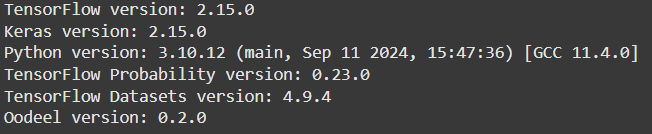

In [ ]:
#tf.debugging.set_log_device_placement(True)
# PARA QUE SE USE LA GPU si no a veces usa la cpu si piensa que no vale tanto la pena creo.

https://colab.research.google.com/notebooks/pro.ipynb#scrollTo=V1G82GuO-tez

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

## Funciones

###Extraer info descriptiva de las imágenes

In [ ]:
from PIL import Image
import numpy as np
import pandas as pd
import os

def extract_image_info(df, file_name_column, images_path, file_extension="", num_images=None):
    """
    Extrae información descriptiva de las imágenes listadas en un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame que contiene las rutas de las imágenes.
        file_name_column (str): Nombre de la columna con los nombres de los archivos de imagen.
        images_path (str): Ruta de la carpeta donde están las imágenes.
        file_extension (str, optional): Extensión del archivo (por ejemplo, ".jpg", ".png"). Por defecto es "".
        num_images (int, optional): Número máximo de imágenes a procesar. Si es None, procesa todas.

    Returns:
        pd.DataFrame: DataFrame con la información descriptiva de cada imagen.
    """
    # Construir las rutas de las imágenes
    if file_extension:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path, x + file_extension))
    else:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path, x))

    # Limitar el número de imágenes a procesar
    if num_images is not None:
        df = df.head(num_images)

    # Lista para almacenar la información de las imágenes
    image_info_list = []

    # Iterar sobre cada imagen en el DataFrame
    for index, row in df.iterrows():
        image_path = row['image_path']
        try:
            # Abrir la imagen usando Pillow
            with Image.open(image_path) as img:
                # Convertir la imagen a un array de numpy
                img_array = np.array(img)

                # Obtener información descriptiva
                dimensions = img_array.shape  # Dimensiones de la imagen
                min_value = img_array.min()   # Valor mínimo en la imagen
                max_value = img_array.max()   # Valor máximo en la imagen
                data_type = img_array.dtype   # Tipo de datos

                # Guardar la información en la lista
                image_info_list.append({
                    'image_path': image_path,
                    'dimensions': dimensions,
                    'min_value': min_value,
                    'max_value': max_value,
                    'data_type': data_type
                })
        except Exception as e:
            # Manejar excepciones si no se puede abrir la imagen
            print(f"Error al abrir la imagen {image_path}: {e}")

    # Convertir la lista a un DataFrame de pandas
    df_image_info = pd.DataFrame(image_info_list)

    return df_image_info


### Crear dataset tf y visualizar imágenes opcionalmente

In [ ]:
import os
import tensorflow as tf
import matplotlib.pyplot as plt

def prepare_dataset(df, images_path_folder, file_name_column="name", label_column=None, label_map=None, resize_shape=(224, 224), normalize=True,
                    transpose=True, display_samples=False, num_display_samples=27, remove_labels=False, file_extension=""):
    """
    Función para preparar un tf.data.Dataset a partir de un DataFrame y configurar varias opciones.

    Args:
        df (pd.DataFrame): DataFrame que contiene los nombres de los archivos y etiquetas.
        images_path_folder (str): Ruta de la carpeta donde se encuentran las imágenes.
        file_name_column (str, optional): Nombre de la columna con los nombres de los archivos.
        label_column (str, optional): Nombre de la columna con las etiquetas. Si es None, no se usará etiqueta.
        label_map (dict, optional): Diccionario para mapear etiquetas a valores numéricos.
        resize_shape (tuple, optional): Tamaño al que se redimensionarán las imágenes.
        normalize (bool, optional): Si True, normaliza los valores de los píxeles entre 0 y 1.
        transpose (bool, optional): Si True, reordena las dimensiones de las imágenes a (3, altura, ancho).
        display_samples (bool, optional): Si True, muestra algunas imágenes del dataset con sus etiquetas.
        num_display_samples (int, optional): Número de muestras a mostrar si display_samples es True.
        remove_labels (bool, optional): Si True, crea un dataset sin etiquetas, solo con imágenes.
        file_extension (str, optional): Extensión de archivo a añadir a los nombres (por ejemplo, ".jpg" o ".png").
                                        Si es una cadena vacía, no se añadirá ninguna extensión.

    Returns:
        tf.data.Dataset: Dataset preparado según las configuraciones.
    """
    # Añadir la extensión a los nombres de archivo para construir el path completo de cada imagen
    if file_extension:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x + file_extension))
    else:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x))

    # Convertir etiquetas a formato numérico si se especifica un label_map
    if label_column and label_map:
        df['label'] = df[label_column].map(label_map)
    elif label_column:
        df['label'] = df[label_column]

    # Definir función de procesamiento de imágenes
    def process_image(image_path, label=None):
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, resize_shape)  # Ajustar tamaño de la imagen
        if transpose:
            image = tf.transpose(image, [2, 0, 1])  # Reordenar las dimensiones si es necesario
        if normalize:
            image /= 255.0  # Normalizar los valores de los píxeles
        return (image, tf.cast(label, tf.int32)) if label is not None else image

    # Crear el tf.data.Dataset con o sin etiquetas según `remove_labels`
    if remove_labels:
        dataset = tf.data.Dataset.from_tensor_slices(df['image_path'].values)
        dataset = dataset.map(lambda path: tf.py_function(process_image, [path], [tf.float32]))
    else:
        paths = df['image_path'].values
        labels = df['label'].values if label_column else [None] * len(paths)
        dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
        dataset = dataset.map(lambda path, label: tf.py_function(process_image, [path, label], [tf.float32, tf.int32]))

    # Mostrar muestras si se especifica `display_samples`
    if display_samples:
        plt.figure(figsize=(20, 20))
        for i, (image_path, label) in enumerate(zip(paths[:num_display_samples], labels[:num_display_samples])):
            image, _ = process_image(image_path, label)
            title = f'{df[file_name_column].iloc[i]}: {"Malignant" if label == 1 else "Benign"}'

            rows = (num_display_samples + 4) // 5
            ax = plt.subplot(rows, 5, i + 1)
            plt.imshow(tf.transpose(image, [1, 2, 0]).numpy() if transpose else image.numpy())
            plt.title(title)
            plt.axis('off')

    return dataset


Para Dataset OOD y plotear labels si hay:

In [ ]:
def prepare_dataset_ood(
    df, images_path_folder, file_name_column="name", label_column=None, label_map=None,
    resize_shape=(224, 224), normalize=True, transpose=True,
    display_samples=False, num_display_samples=27, remove_labels=True, file_extension=""
):
    """
    Función para preparar un tf.data.Dataset y mostrar muestras ordenadas.
    """
    # Añadir la extensión a los nombres de archivo
    if file_extension:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x + file_extension))
    else:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x))

    # Convertir etiquetas si se especifica un label_map
    if label_column and label_map:
        df['label'] = df[label_column].map(label_map)
    elif label_column:
        df['label'] = df[label_column]

    # Definir función de procesamiento de imágenes
    def process_image(image_path, label=None):
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, resize_shape)
        if transpose:
            image = tf.transpose(image, [2, 0, 1])
        if normalize:
            image /= 255.0
        return (image, tf.cast(label, tf.int32)) if label is not None else image

    # Crear el tf.data.Dataset con o sin etiquetas
    if remove_labels:
        paths = df['image_path'].values
        dataset = tf.data.Dataset.from_tensor_slices(paths)
        dataset = dataset.map(lambda path: tf.py_function(process_image, [path], [tf.float32]))
    else:
        paths = df['image_path'].values
        labels = df['label'].values
        dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
        dataset = dataset.map(lambda path, label: tf.py_function(process_image, [path, label], [tf.float32, tf.int32]))

    # Mostrar muestras si se especifica `display_samples`
    if display_samples:
        total_samples = min(len(df), num_display_samples)
        plt.figure(figsize=(20, 20))
        for i in range(total_samples):
            image_path = paths[i]
            label = labels[i] if not remove_labels else None
            image, _ = process_image(image_path, label) if not remove_labels else (process_image(image_path), None)

            # Mostrar encabezado antes del primer grupo de imágenes
            if i == 0:
                print(f"Muestras para la etiqueta: {label}" if label is not None else "Muestras sin etiquetas")
                print("-" * 50)

            ax = plt.subplot((total_samples + 4) // 5, 5, i + 1)
            plt.imshow(tf.transpose(image, [1, 2, 0]).numpy() if transpose else image.numpy())
            title = os.path.basename(image_path) if remove_labels else f'{os.path.basename(image_path)}: {label}'
            plt.title(title)
            plt.axis('off')

        plt.show()

    return dataset

### Display Pred vs True

In [ ]:
def display_predictions(dataset, predictions, num_images, threshold = 0.5):

    predicted_labels = (predictions > threshold).astype(int)

    # Obtener las etiquetas reales
    true_labels = []
    for _, label in dataset:
        true_labels.extend(label.numpy())
    true_labels = np.array(true_labels)

    plt.figure(figsize=(20, 20))
    count = 0
    for images, labels in dataset.take((num_images + 31) // 32):  # Ajustar el número de batches a tomar
        for i in range(images.shape[0]):  # Iterar sobre el batch
            if count >= num_images:
                break
            rows = (num_images + 4) // 5  # Calcular el número de filas necesario
            ax = plt.subplot(rows, 5, count + 1)
            image = tf.transpose(images[i], [1, 2, 0]).numpy()  # Reordenar las dimensiones de nuevo para la visualización
            plt.imshow(image)
            pred_label = "Malignant" if predictions[count] == 1 else "Benign"
            true_label = "Malignant" if true_labels[count] == 1 else "Benign"
            plt.title(f'Pred: {pred_label}\nTrue: {true_label}')
            plt.axis('off')
            count += 1


### Obtener plots con Métricas, Confusion Matriz, Curvas ROC, Pr-Rec

In [ ]:
def evaluate_model_performance(dataset, predictions, threshold=0.5):
    """
    Evalúa el rendimiento de un modelo utilizando un dataset y las predicciones generadas, mostrando varias métricas.

    Args:
        dataset (tf.data.Dataset): Dataset en lotes con etiquetas reales.
        predictions (np.array): Predicciones del modelo, en formato de probabilidad.
        threshold (float): Umbral para convertir probabilidades en etiquetas binaras.

    Returns:
        None: Imprime métricas y muestra gráficos de rendimiento.
    """
    # Obtener las etiquetas reales del dataset
    true_labels = []
    for _, label in dataset:
        true_labels.extend(label.numpy())
    true_labels = np.array(true_labels)

    # Convertir las predicciones en etiquetas binarias
    predicted_labels = (predictions > threshold).astype(int)

    # Calcular métricas de rendimiento
    accuracy = accuracy_score(true_labels, predicted_labels)
    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    class_report = classification_report(true_labels, predicted_labels, target_names=['Benign', 'Malignant'])

    print(f'Accuracy: {accuracy}')
    print('Confusion Matrix:')
    print(conf_matrix)
    print('Classification Report:')
    print(class_report)

    # Curva ROC y AUC
    fpr, tpr, thresholds_roc = roc_curve(true_labels, predictions)
    roc_auc = auc(fpr, tpr)

    # Curva Precision-Recall y AUC
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predictions)
    pr_auc = auc(recall, precision)

    # Gráfico interactivo ROC con Plotly
    roc_trace = go.Scatter(x=fpr, y=tpr, mode='lines', name='ROC curve (area = %0.2f)' % roc_auc,
                           text=[f'Threshold: {t:.2f}' for t in thresholds_roc],
                           hoverinfo="text+x+y")
    roc_layout = go.Layout(
        title="ROC Curve",
        xaxis=dict(title="False Positive Rate"),
        yaxis=dict(title="True Positive Rate"),
        shapes=[dict(type='line', x0=0, y0=0, x1=1, y1=1, line=dict(dash='dash'))]
    )
    fig_roc = go.Figure(data=[roc_trace], layout=roc_layout)
    fig_roc.show()

    # Gráfico interactivo Precision-Recall con Plotly
    pr_trace = go.Scatter(x=recall, y=precision, mode='lines', name='Precision-Recall curve',
                          text=[f'Threshold: {t:.2f}' for t in thresholds_pr],
                          hoverinfo="text+x+y")
    pr_layout = go.Layout(
        title="Precision-Recall Curve",
        xaxis=dict(title="Recall"),
        yaxis=dict(title="Precision")
    )
    fig_pr = go.Figure(data=[pr_trace], layout=pr_layout)
    fig_pr.show()

    # Matriz de confusión con seaborn
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False,
                xticklabels=['Predicted Benign', 'Predicted Malignant'],
                yticklabels=['Actual Benign', 'Actual Malignant'])
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.show()

    # Imprimir AUCs
    print(f'AUC (ROC): {roc_auc}')
    print(f'Precision-Recall AUC: {pr_auc}')

### Convertir 4 channels a RGB (3 channels)

In [ ]:
def convert_to_rgb_and_jpg(df, file_name_column, images_path, output_path):
    """
    Convierte imágenes a RGB (si tienen 4 canales) y las guarda como .jpg.

    Args:
        df (pd.DataFrame): DataFrame que contiene las rutas de las imágenes.
        file_name_column (str): Nombre de la columna con los nombres de los archivos de imagen.
        images_path (str): Ruta de la carpeta donde están las imágenes.
        output_path (str, optional): Ruta de la carpeta donde guardar las imágenes convertidas.
                                     Si es None, sobrescribe las imágenes originales.

    Returns:
        None
    """
    # Crear carpeta de salida si se especifica
    if output_path and not os.path.exists(output_path):
        os.makedirs(output_path)

    for index, row in df.iterrows():
        image_name = row[file_name_column]
        input_path = os.path.join(images_path, image_name)

        try:
            with Image.open(input_path) as img:
                # Convertir a RGB si tiene 4 canales (RGBA)
                if img.mode == 'RGBA':
                    img = img.convert('RGB')
                    print(f"Convertida a RGB: {image_name}")
                elif img.mode != 'RGB':
                    img = img.convert('RGB')
                    print(f"Convertida a RGB (de otro modo): {image_name}")

                # Definir nuevo nombre con extensión .jpg
                new_name = os.path.splitext(image_name)[0] + ".jpg"
                save_path = os.path.join(output_path if output_path else images_path, new_name)

                # Guardar como .jpg
                img.save(save_path, "JPEG")
                print(f"Guardada como .jpg: {save_path}")
        except Exception as e:
            print(f"Error al procesar la imagen {input_path}: {e}")


### Funciones OOD

In [ ]:
from oodeel.datasets.tf_data_handler import TFDataHandler
from oodeel.datasets import OODDataset

# Convertir el dataset a un formato compatible con OODDataset
def convert_to_dict(image, label):
    return {"input_0": image, "label": label}

class TFDataHandlerCustom(TFDataHandler):
    @classmethod
    def load_custom_dataset(cls, dataset_id, keys):
        if keys is None:
            keys = ['input_0', 'label']
        def to_dict(image, label):
            return {keys[0]: image, keys[1]: label}
        dataset = dataset_id.map(to_dict)
        return dataset

def add_dummy_label(image):
  dummy_label = tf.constant(-1, dtype=tf.int64) # Use -1 or any other value to represent OOD
  return image, dummy_label


def compare_outputs_mahalanobis(output1, output2): # comparo instancias del objeto Malahanobis para ver si son iguales
    # Compara las clases
    classes_equal = np.array_equal(output1._classes, output2._classes)

    # Compara las medias (mus)
    mus_equal = all(np.array_equal(output1._mus[class_id], output2._mus[class_id]) for class_id in output1._mus)

    # Compara las pseudoinversas de las matrices de covarianza
    pinv_cov_equal = np.array_equal(output1._pinv_cov, output2._pinv_cov)

    # Devuelve el resultado de las comparaciones
    if classes_equal and mus_equal and pinv_cov_equal:
        return True
    else:
        return False

def compare_outputs_gram(output1, output2): # comparo instancias del objeto Malahanobis para ver si son iguales
    # Compara las clases
    classes_equal = np.array_equal(output1._classes, output2._classes)

    # Compara las medias (mus)
    min_maxs_equal = all(np.array_equal(output1.min_maxs[class_id], output2.min_maxs[class_id]) for class_id in output1.min_maxs)

    # Compara las pseudoinversas de las matrices de covarianza
    devnorm_equal = np.array_equal(output1.devnorm, output2.devnorm)

    # Devuelve el resultado de las comparaciones
    if classes_equal and min_maxs_equal and devnorm_equal:
        return True
    else:
        return False


def mnist_preprocess_image(image):
    # Convertir la imagen en escala de grises a RGB
    image = tf.image.grayscale_to_rgb(image)
    # Redimensionar la imagen a 224x224
    image = tf.image.resize(image, (224, 224))
    # Normalizar los valores de los píxeles a un rango de [0, 1]
    image = image / 255.0
    # Cambiar el orden de las dimensiones de la imagen a NHWC
    image = tf.transpose(image, [0, 3, 1, 2])
    return image

In [ ]:
def get_ds_source_name(ds_fit_seteado, ds_in_seteado, ds_out_seteado):
    # Inicializamos una lista para almacenar los nombres de los datasets
    source_names = []

    # Comprobamos si ds_fit_seteado está en el diccionario y lo añadimos
    if ds_fit_seteado in dataset_sources["ds_fit_seteado"]:
        source_names.append(dataset_sources["ds_fit_seteado"][ds_fit_seteado])

    # Comprobamos si ds_in_seteado está en el diccionario y lo añadimos
    if ds_in_seteado in dataset_sources["ds_in_seteado"]:
        source_names.append(dataset_sources["ds_in_seteado"][ds_in_seteado])

    # Comprobamos si ds_out_seteado está en el diccionario y lo añadimos
    if ds_out_seteado in dataset_sources["ds_out_seteado"]:
        source_names.append(dataset_sources["ds_out_seteado"][ds_out_seteado])

    return source_names

def get_dataset_and_ds_stats(ds_fit_seteado, ds_in_seteado, ds_out_seteado, batch_size_train, batch_size_test, ds_fit, ds_in, ds_out, info_detallada = False):

  lista_de_ds_names = get_ds_source_name(ds_fit_seteado, ds_in_seteado, ds_out_seteado)
  lista_de_ooddataset = [ds_fit, ds_in, ds_out]
  lista_de_dataset = [ds_fit_seteado, ds_in_seteado, ds_out_seteado]


  for name, ds, dataset in zip(lista_de_ds_names, lista_de_ooddataset, lista_de_dataset):

    print(f"{name}:")
    print(f"--------------------------------------")
    if not isinstance(dataset, str): # si es de mnist no tengo dataset... tengo un string.
        print(f"SOURCE DATSAET INFO:")
        print(f"Imgs exactas: {len(dataset)}")
        print(f"--------------------------------------")

    print(f"OODDataset INFO:")
    # Calcular imágenes totales
    if dataset == ds_fit_seteado:
      batch_size = batch_size_train
    else:
      batch_size = batch_size_test
    num_batches = len(ds)
    if info_detallada:
      #Comento las siguientes líneas porque tarda bastante en procesarlas y no aportan mucho.
      #ya puse en observaciones lo importante en relación a esto.
      total_images = (num_batches - 1) * batch_size + next(iter(ds))[-1].shape[0]
      print(f"Imágenes totales en el OODDataset: {total_images}")
      print("Shape")
      # Obtener dimensiones de ds
      for batch in ds:
          x, y = batch
          print(f'{name} - x shape: {x.shape}, y shape: {y.shape}')
          break

    print(f"batch_size: {batch_size}")
    print(f"batches: {len(ds)}")
    print("________________________________________")
    print("")

In [ ]:
# Visualización de algunas imágenes del dataset
def plot_images(dataset, n):
    plt.figure(figsize=(10, 10))
    for i, example in enumerate(dataset.take(n)):
        image, label = example['image'], example['label']
        plt.subplot(5, 5, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(image.numpy().squeeze(), cmap='gray')
        plt.xlabel(label.numpy())
    plt.show()



# Distribución de clases en el dataset de entrenamiento
def plot_class_distribution(dataset):
    class_counts = [0] * 10
    for example in dataset:
        label = example['label'].numpy()
        class_counts[label] += 1

    plt.bar(range(10), class_counts)
    plt.xlabel('Clase')
    plt.ylabel('Cantidad')
    plt.title('Distribución de clases en el dataset MNIST')
    plt.show()

In [ ]:
def filtar_labels_por_sample_count_y_crear_dfs(df, num_samples_por_label, label_column='label'):
    """
    Filtra etiquetas basándose en un número mínimo de muestras, crea un DataFrame para cada etiqueta,
    y los almacena en un diccionario.

    Args:
        df: Pandas DataFrame que contiene los datos.
        num_samples_por_label: Número mínimo de muestras requerido para incluir una etiqueta.
        label_column: Nombre de la columna que contiene las etiquetas (por defecto: 'label').

    Returns:
        Un diccionario donde las claves son las etiquetas y los valores son DataFrames filtrados.
    """
    # Contar las ocurrencias de cada etiqueta
    label_counts = df[label_column].value_counts()

    # Filtrar etiquetas que tienen al menos el número mínimo de muestras
    filtered_labels = label_counts[label_counts >= num_samples_por_label]

    # Inicializar el diccionario para almacenar los DataFrames
    dfs_dict = {}

    # Total de muestras en el DataFrame original (para calcular el porcentaje)
    total_samples = len(df)

    # Iterar sobre las etiquetas filtradas
    for label, count in filtered_labels.items():
        # Calcular el porcentaje
        percentage = (count / total_samples) * 100

        # Filtrar el DataFrame original por la etiqueta actual
        group = df[df[label_column] == label]

        # Crear una copia del grupo y almacenarlo en el diccionario
        dfs_dict[label] = group.copy()

        # Crear una variable global con el DataFrame filtrado (opcional)
        globals()[f'df_ood_{label.replace(" ", "_")}'] = group.copy()

        # Imprimir el tamaño y porcentaje
        print(f'df_ood_{label.replace(" ", "_")}: {len(group)}, Percentage: {percentage:.2f}%')

    # Retornar el diccionario con todos los DataFrames
    return dfs_dict



In [ ]:
import matplotlib.pyplot as plt

def plot_2D_features_custom(model, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_layer_id, proj_method):
    # Inicialización de valores a partir del diccionario de datasets
    ds_in_value = dataset_sources["ds_in_seteado"].get(ds_in_seteado, "Key not found")
    ds_out_value = dataset_sources["ds_out_seteado"].get(ds_out_seteado, "Key not found")

    # Preparar dataset "in"
    ds_in = OODDataset(
        ds_in_seteado,
        backend="tensorflow",
        keys=["input_0", "label"]
    ).prepare(batch_size_test, shuffle=False).take(batches_in)

    # Preparar dataset "out"
    if not isinstance(ds_out_seteado, str):  # FITZ OOD
        ds_out = OODDataset(
            ds_out_seteado,
            load_kwargs={"split": "test"},
            backend="tensorflow"
        ).prepare(batch_size_test, shuffle=True).take(batches_out) # Uso # Uso shuffle porque este ds toma la totalidad de las muestras y entonces no afecta. Y los casos donde supera la totalidad, como _ok y _ambos_filtros me sirve el shuffle!

    else:  # MNIST
        ds_out = OODDataset(
            ds_out_seteado,
            load_kwargs={"split": "test"},
            backend="tensorflow"
        ).prepare(batch_size_test, shuffle=True).take(batches_out)  # Uso shuffle porque este ds va a estar sampleado a 768 muestras.
        ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    # Calcular cantidad de elementos en cada dataset
    if isinstance(ds_out_seteado, str) or ds_out_seteado == dataset_fitz_ood_dict_ok or ds_out_seteado == dataset_fitz_ood_dict_filtrado_ambos:  # MNIST o casos ok y ambos filtros
        cant_ds_out = batch_size_test * batches_out  # Es 768 y no 766 porque así funciona el take.
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
    else:  # Fitz OOD
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
        cant_ds_out = len(ds_out_seteado)  # Toma el largo de muestras OOD con esa label.

    # Imprimir información de los datasets
    print(f"Value de 'ds_in_seteado': {ds_in_value}")
    print(f"Value de 'ds_out_seteado': {ds_out_value}")
    print(f"Cantidad de elementos en 'ds_in': {cant_ds_in}")
    print(f"Cantidad de elementos en 'ds_out': {cant_ds_out}")

    # Visualizar características con plot_2D_features
    plot_2D_features(
        model,
        in_dataset=ds_in,
        output_layer_id=output_layer_id,
        out_dataset=ds_out,
        proj_method=proj_method,
        title=f"{ds_in_value} ({cant_ds_in}), {ds_out_value} ({cant_ds_out})"
    )
    plt.show()  # Renderiza el gráfico inmediatamente.


In [ ]:
def plot_2D_features_custom_2(model, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_layer_id, proj_method):
    # Inicialización de valores a partir del diccionario de datasets
    ds_in_value = dataset_sources["ds_in_seteado"].get(ds_in_seteado, "Key not found")
    ds_out_value = dataset_sources["ds_out_seteado"].get(ds_out_seteado, "Key not found")

    # Preparar dataset "in"
    ds_in = OODDataset(
        ds_in_seteado,
        backend="tensorflow",
        keys=["input_0", "label"]
    ).prepare(batch_size_test, shuffle=False).take(batches_in)

    # Preparar dataset "out"
    if not isinstance(ds_out_seteado, str):  # FITZ OOD
        ds_out = OODDataset(
            ds_out_seteado,
            load_kwargs={"split": "test"},
            backend="tensorflow"
        ).prepare(batch_size_test, shuffle=True).take(batches_out)
    else:  # MNIST
        ds_out = OODDataset(
            ds_out_seteado,
            load_kwargs={"split": "test"},
            backend="tensorflow"
        ).prepare(batch_size_test, shuffle=True).take(batches_out)
        ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    # Verificar si las variables están definidas
    fitz_ood_ok_defined = "dataset_fitz_ood_dict_ok" in globals()
    fitz_ood_filtrado_ambos_defined = "dataset_fitz_ood_dict_filtrado_ambos" in globals()

    # Calcular cantidad de elementos en cada dataset
    if isinstance(ds_out_seteado, str) or \
       (fitz_ood_ok_defined and ds_out_seteado == dataset_fitz_ood_dict_ok) or \
       (fitz_ood_filtrado_ambos_defined and ds_out_seteado == dataset_fitz_ood_dict_filtrado_ambos):
        cant_ds_out = batch_size_test * batches_out  # Es 768 y no 766 porque así funciona el take.
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
    else:  # Fitz OOD
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
        cant_ds_out = len(ds_out_seteado)  # Toma el largo de muestras OOD con esa label.

    # Imprimir información de los datasets
    print(f"Value de 'ds_in_seteado': {ds_in_value}")
    print(f"Value de 'ds_out_seteado': {ds_out_value}")
    print(f"Cantidad de elementos en 'ds_in': {cant_ds_in}")
    print(f"Cantidad de elementos en 'ds_out': {cant_ds_out}")

    # Visualizar características con plot_2D_features
    plot_2D_features(
        model,
        in_dataset=ds_in,
        output_layer_id=output_layer_id,
        out_dataset=ds_out,
        proj_method=proj_method,
        title=f"{ds_in_value} ({cant_ds_in}), {ds_out_value} ({cant_ds_out})"
    )
    plt.show()  # Renderiza el gráfico inmediatamente.

In [ ]:
def plot_ood_scores_custom(
    metodo,
    scores_in,
    scores_out,
    ds_in_seteado,
    ds_out_seteado,
    batch_size_test,
    batches_in,
    batches_out,
    output_path
):
    # Mapeo de los datasets a sus nombres de fuente
    ds_in_value = dataset_sources["ds_in_seteado"].get(ds_in_seteado, "Key not found")
    ds_out_value = dataset_sources["ds_out_seteado"].get(ds_out_seteado, "Key not found")
        # Verificar si las variables están definidas
    fitz_ood_ok_defined = "dataset_fitz_ood_dict_ok" in globals()
    fitz_ood_filtrado_ambos_defined = "dataset_fitz_ood_dict_filtrado_ambos" in globals()

    # Calcular cantidad de elementos en cada dataset
    if isinstance(ds_out_seteado, str) or \
       (fitz_ood_ok_defined and ds_out_seteado == dataset_fitz_ood_dict_ok) or \
       (fitz_ood_filtrado_ambos_defined and ds_out_seteado == dataset_fitz_ood_dict_filtrado_ambos):
        cant_ds_out = batch_size_test * batches_out  # Es 768 y no 766 porque así funciona el take.
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
    else:  # Fitz OOD
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
        cant_ds_out = len(ds_out_seteado)  # Toma el largo de muestras OOD con esa label.

    # Imprimir información de los datasets
    print(f"Value de 'ds_in_seteado': {ds_in_value}")
    print(f"Value de 'ds_out_seteado': {ds_out_value}")
    print(f"Cantidad de elementos en 'ds_in': {cant_ds_in}")
    print(f"Cantidad de elementos en 'ds_out': {cant_ds_out}")


    plt.figure()
    title = (
        f"{metodo}: Histograms of OOD detection scores\n"
        f"{ds_in_value} ({cant_ds_in}), {ds_out_value} ({cant_ds_out})"
    )
    ax1 = sns.histplot(
        data=scores_in,
        alpha=0.5,
        label="ID data",
        stat="density",
        log_scale=False,
        kde=True,
    )
    ax2 = sns.histplot(
        data=scores_out,
        alpha=0.5,
        label="OOD data",
        stat="density",
        log_scale=False,
        kde=True,
    )
    ymax = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    threshold = np.percentile(scores_out, q=5.0)
    plt.vlines(
        x=[threshold],
        ymin=0,
        ymax=ymax,
        colors=["red"],
        linestyles=["dashed"],
        alpha=0.7,
        label="TPR=95%",
    )
    plt.xlabel("OOD score")
    plt.legend()
    plt.title(title, weight="bold").set_fontsize(11)
    # Si se proporciona un output_path, guardar el gráfico
    if output_path:
        plt.savefig(output_path + f"/{title}.jpg")
    plt.show()

In [ ]:
def plot_roc_curve_custom(metodo, scores_in, scores_out,output_path):
    """Plot ROC curve for OOD detection task, using matplotlib and seaborn.

    Args:
        scores_in (np.ndarray): OOD detection scores for ID data.
        scores_out (np.ndarray): OOD detection scores for OOD data.
        title (str, optional): Custom figure title. If None a default one is provided.
            Defaults to None.
    """
        # Mapeo de los datasets a sus nombres de fuente
    ds_in_value = dataset_sources["ds_in_seteado"].get(ds_in_seteado, "Key not found")
    ds_out_value = dataset_sources["ds_out_seteado"].get(ds_out_seteado, "Key not found")
        # Verificar si las variables están definidas
    fitz_ood_ok_defined = "dataset_fitz_ood_dict_ok" in globals()
    fitz_ood_filtrado_ambos_defined = "dataset_fitz_ood_dict_filtrado_ambos" in globals()

    # Calcular cantidad de elementos en cada dataset
    if isinstance(ds_out_seteado, str) or \
       (fitz_ood_ok_defined and ds_out_seteado == dataset_fitz_ood_dict_ok) or \
       (fitz_ood_filtrado_ambos_defined and ds_out_seteado == dataset_fitz_ood_dict_filtrado_ambos):
        cant_ds_out = batch_size_test * batches_out  # Es 768 y no 766 porque así funciona el take.
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
    else:  # Fitz OOD
        cant_ds_in = len(ds_in_seteado)  # Esto se mantendría, es siempre 766.
        cant_ds_out = len(ds_out_seteado)  # Toma el largo de muestras OOD con esa label.

    # Imprimir información de los datasets
    print(f"Value de 'ds_in_seteado': {ds_in_value}")
    print(f"Value de 'ds_out_seteado': {ds_out_value}")
    print(f"Cantidad de elementos en 'ds_in': {cant_ds_in}")
    print(f"Cantidad de elementos en 'ds_out': {cant_ds_out}")



    # compute auroc
    metrics = bench_metrics(
        (scores_in, scores_out),
        metrics=["auroc", "fpr95tpr"],
    )
    auroc, fpr95tpr = metrics["auroc"], metrics["fpr95tpr"]

    # roc
    fpr, tpr, _, _, _ = get_curve(
        scores=np.concatenate([scores_in, scores_out]),
        labels=np.concatenate([scores_in * 0 + 0, scores_out * 0 + 1]),
    )

    # plot roc
    title = f"{metodo}: AuC = {auroc:.3f}, FPR95TPR = {fpr95tpr:.3f}\n{ds_in_value} ({cant_ds_in}), {ds_out_value} ({cant_ds_out})"
    plt.figure()
    plt.plot(fpr, tpr)
    plt.fill_between(fpr, tpr, np.zeros_like(tpr), alpha=0.5)
    plt.plot([fpr95tpr, fpr95tpr, 0], [0, 0.95, 0.95], "--", color="red", alpha=0.7)
    plt.scatter([fpr95tpr], [0.95], marker="o", alpha=0.7, color="red", label="TPR=95%")
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.xlim([-0.01, 1.01])
    plt.ylim([-0.01, 1.01])
    plt.legend()
    plt.title(title, weight="bold").set_fontsize(11)
    # Si se proporciona un output_path, guardar el gráfico
    if output_path:
        plt.savefig(output_path + f"/{title}.jpg")
    plt.show()

In [ ]:
def score_plots_custom(metodo, scores_in, scores_out,
                       ds_in_seteado, ds_out_seteado,
                       batch_size_test, batches_in, batches_out,
                       output_path=None):
    # Llamar a las funciones de los gráficos y pasarlas al parámetro output_path
    plot_roc_curve_custom(metodo, scores_in, scores_out, output_path=output_path)
    plot_ood_scores_custom(metodo, scores_in, scores_out,
                           ds_in_seteado, ds_out_seteado,
                           batch_size_test, batches_in, batches_out,
                           output_path=output_path)


## Paths:

General

In [ ]:
ID_SETS_PATH_IUHI = "/content/drive/MyDrive/Tesis/ID sets"
OOD_SETS_PATH_IUHI = "/content/drive/MyDrive/Tesis/OOD sets"

Específicos

In [ ]:
#Train
#Fitzpatrick17k
FITZPATRICK17K_IMAGES_PATH = "/Fitzpatrick17k/images"
FITZPATRICK17K_CSV_TRAIN_PATH = "/Fitzpatrick17k/filtered_fitz_train.csv"

#PADUFES
PAD_UFES_IMAGES_PATH = "/PAD_UFES/images"
PAD_UFES_CSV_TRAIN_PATH = "/PAD_UFES/PAD_UFES_train.csv"

#ISIC
ISIC_IMAGES_PATH = "/ISIC/images"
ISIC_CSV_TRAIN_PATH = "/ISIC/ISIC_train.csv"

# Test
#Consumer AI
CONSUMER_AI_IMAGES_PATH = "/Consumer AI/images"
CONSUMER_AI_CSV_TEST_PATH = "/Consumer AI/Consumer AI - prediccionesconsumerai.csv"

#DDI
DDI_IMAGES_PATH = "/DDI/images"
DDI_CSV_TEST_PATH = "/DDI/Stanford - prediccionesstanford_28Feb.csv"

#Institucional
INSTITUCIONAL_IMAGES_PATH = "/Institucional/images"
INSTITUCIONAL_CSV_TEST_PATH = "/Institucional/Institucional - prediccionesTestA.csv"

#Fitzpatrick17k
FITZPATRICK17K_CSV_TEST_PATH = "/Fitzpatrick17k/filtered_fitz_test.csv"

#TEST COMBINED:
TEST_COMBINED_IMAGES_PATH = "/images_ID_Test_combined"
TEST_COMBINED_CSV_TEST_PATH = "/OOD_Test_combined.csv"

#OOD
FITZPATRICK17K_OOD_IMAGES_PATH_OK = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/non-neoplastic/ok"
FITZPATRICK17K_OOD_IMAGES_PATH_FILTRADO_AMBOS = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/non-neoplastic/filtrado_ambos"

FITZPATRICK17K_OOD_CSV_PATH_COMPLETO = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/fitz_non-neoplastic.csv"
FITZPATRICK17K_OOD_CSV_PATH_FILTRADO_AMBOS = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/fitz_non-neoplastic_filtro_ambos.csv"
FITZPATRICK17K_OOD_CSV_PATH_OK = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/fitz_non-neoplastic_ok.csv"

TEST_COMBINED_OOD_RECORTADAS_IMAGES_PATH = "/images_OOD_Test_combined_recortadas"
TEST_COMBINED_OOD_RECORTADAS_CSV_PATH = "/OOD_Test_combined_recortadas.csv"

# DATASETS: análisis y procesamiento *(correr una sola vez)*

## Train: Fitz

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_CSV_TRAIN_PATH

df_train_fitz = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_fitz)}")
df_train_fitz.head()

tamaño del dataset: 1951


,Unnamed: 0,img_path,label
0,1255,c50113547f82a9ad4d3ce4dc0972a698.jpg,malignant
1,1775,e28cbb701b1b2ff727c3c7aba01fe6ff.jpg,malignant
2,2339,fa60f299be44300e85109f587aebfbb3.jpg,malignant
3,2625,4914fa9dae16b9762acae30d0349ad85.jpg,malignant
4,433,ad2b7dbf614fefe443c43c66aa8a9c01.jpg,benign


###Reviso imágenes

In [ ]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_fitz, file_name_column = "img_path", images_path = images_path, file_extension = "", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(366, 484, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(389, 456, 3)",0,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 293, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(377, 470, 3)",4,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(369, 480, 3)",0,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(919, 1157, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 280, 3)",0,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(362, 386, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(399, 603, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(531, 769, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

In [ ]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_fitz_train = prepare_dataset(df_train_fitz, images_path, file_name_column = "img_path", label_column='label', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


## Train: ISIC

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + ISIC_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + ISIC_CSV_TRAIN_PATH

df_train_ISIC = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_ISIC)}")
df_train_ISIC.head()

tamaño del dataset: 1616


,isic_id,attribution,copyright_license,age_approx,anatom_site_general,benign_malignant,concomitant_biopsy,dermoscopic_type,diagnosis,diagnosis_1,...,diagnosis_confirm_type,family_hx_mm,fitzpatrick_skin_type,image_type,lesion_id,patient_id,personal_hx_mm,pixels_x,pixels_y,sex
0,ISIC_6230191,Hospital Italiano de Buenos Aires,CC-BY,25.0,anterior torso,malignant,True,contact polarized,melanoma,Malignant,...,histopathology,NaN,II,dermoscopic,IL_8124990,IP_8542863,True,640,480,male
1,ISIC_4485929,Hospital Italiano de Buenos Aires,CC-BY,65.0,anterior torso,benign,False,contact polarized,seborrheic keratosis,Benign,...,NaN,NaN,I,dermoscopic,IL_1921228,IP_9326183,True,2448,2448,female
2,ISIC_3079785,Hospital Italiano de Buenos Aires,CC-BY,45.0,lower extremity,benign,True,contact polarized,nevus,Benign,...,histopathology,False,II,dermoscopic,IL_3797557,IP_4906546,False,640,480,male
3,ISIC_9677008,Hospital Italiano de Buenos Aires,CC-BY,30.0,posterior torso,malignant,True,contact polarized,melanoma,Malignant,...,histopathology,NaN,II,dermoscopic,IL_3556705,IP_5493434,True,1409,2900,female
4,ISIC_9129115,Hospital Italiano de Buenos Aires,CC-BY,75.0,posterior torso,benign,True,NaN,actinic keratosis,Indeterminate,...,histopathology,NaN,II,clinical: overview,IL_2485486,IP_8947694,NaN,498,1026,female


###Reviso imágenes

In [ ]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_ISIC, file_name_column = "isic_id", images_path = images_path, file_extension = ".jpg", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(480, 640, 3)",2,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2448, 2448, 3)",0,246,uint8
2,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(480, 640, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2900, 1409, 3)",2,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1026, 498, 3)",0,243,uint8
5,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1960, 4032, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2202, 1071, 3)",29,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(4032, 1960, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(4032, 1960, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1960, 4032, 3)",0,243,uint8


### Convierto a tf (+ display opcional)

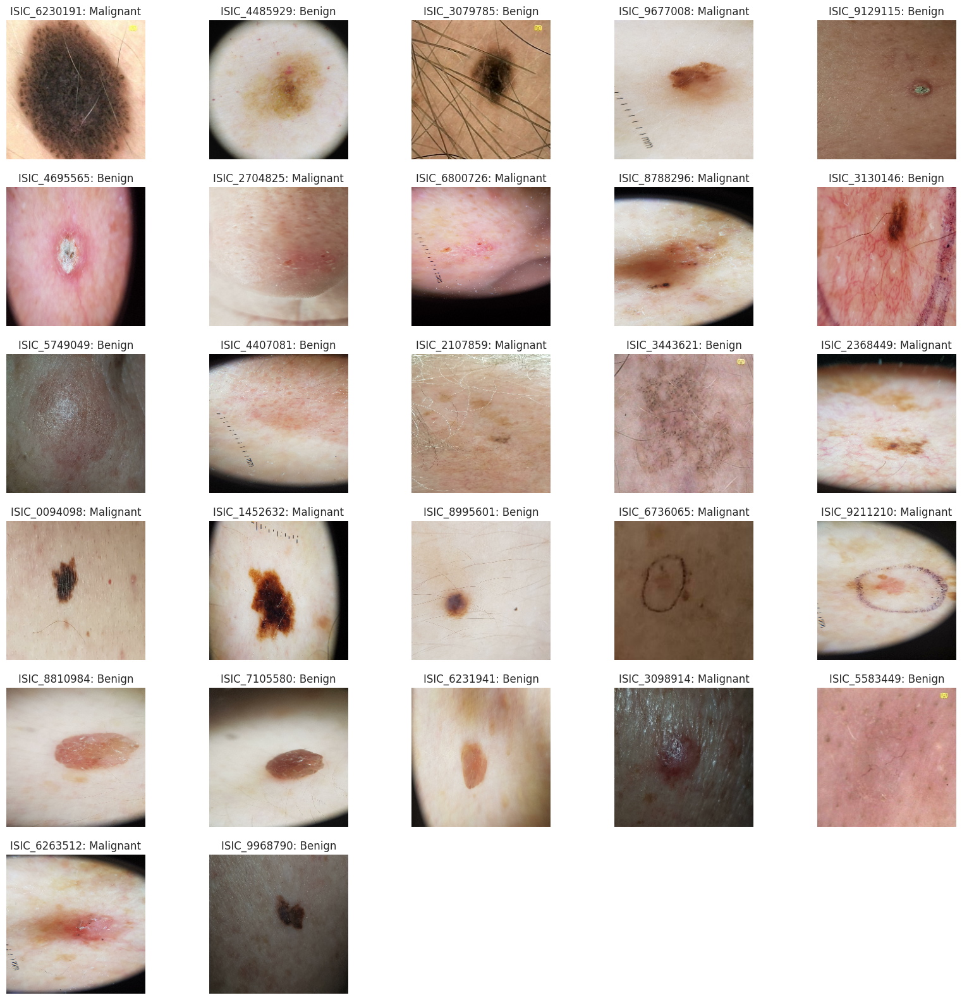

In [ ]:

# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ISIC_train = prepare_dataset(df_train_ISIC, images_path, file_name_column = "isic_id", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension=".jpg")


## Train: PAD_UFES

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + PAD_UFES_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + PAD_UFES_CSV_TRAIN_PATH

df_train_PAD_UFES = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_train_PAD_UFES)}")
df_train_PAD_UFES['name'] = df_train_PAD_UFES['img_id'].str.replace('.png', '.jpg') # a diferencia del resto acá proceso así porque está en .png en el df (igual en carpeta son .jpg)

# Mapeo de diagnósticos a "benign" o "malignant"
diagnostic_map = {
    "BCC": "malignant",
    "MEL": "malignant",
    "SCC": "malignant",
    "ACK": "benign",
    "NEV": "benign",
    "SEK": "benign"
}

# Crear la nueva columna "benign_malignant" en el DataFrame
df_train_PAD_UFES["benign_malignant"] = df_train_PAD_UFES["diagnostic"].map(diagnostic_map)

# Verificar los primeros registros para asegurarse de que la columna se ha agregado correctamente
df_train_PAD_UFES[["name", "benign_malignant", "diagnostic", "benign_malignant"]].head()

tamaño del dataset: 2298


,name,benign_malignant,diagnostic,benign_malignant
0,PAT_1516_1765_530.jpg,benign,NEV,benign
1,PAT_46_881_939.jpg,malignant,BCC,malignant
2,PAT_1545_1867_547.jpg,benign,ACK,benign
3,PAT_1989_4061_934.jpg,benign,ACK,benign
4,PAT_684_1302_588.jpg,malignant,BCC,malignant


###Reviso imágenes

In [ ]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_PAD_UFES, file_name_column = "name", images_path = images_path, file_extension = "", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1089, 1089, 3)",10,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1325, 1325, 3)",0,231,uint8
2,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(640, 640, 3)",29,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(2117, 2118, 3)",46,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(896, 896, 3)",19,254,uint8
5,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(499, 499, 3)",24,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(514, 514, 3)",42,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1726, 1726, 3)",40,247,uint8
8,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1567, 1567, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(2022, 2022, 3)",36,242,uint8


### Convierto a tf (+ display opcional)

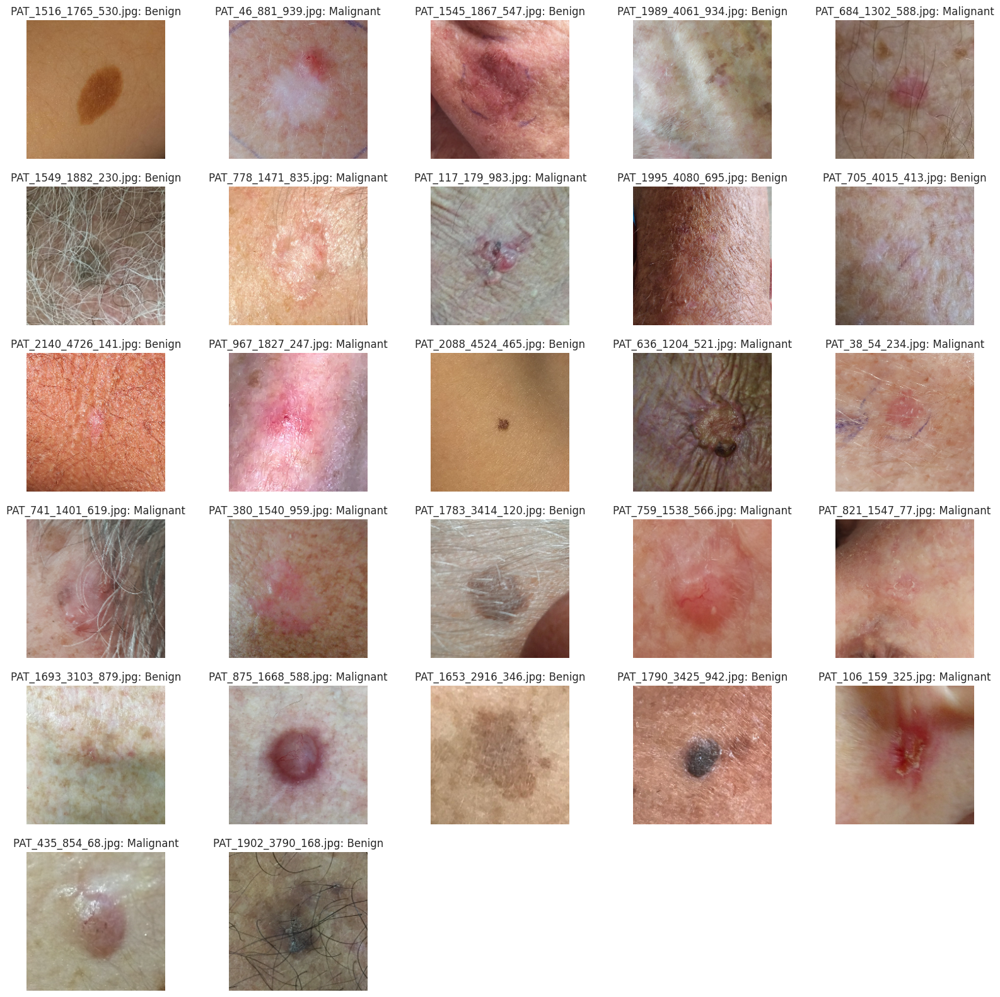

In [ ]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_PAD_UFES_train = prepare_dataset(df_train_PAD_UFES, images_path, file_name_column = "name", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


## CONCATENAR DATASETS TRAIN TFlow

In [ ]:
import tensorflow as tf

# Concatenar los datasets
combined_dataset_train = dataset_fitz_train.concatenate(dataset_ISIC_train).concatenate(dataset_PAD_UFES_train)

# Optimizar la carga del dataset para acelerar la concatenación
combined_dataset_train = combined_dataset_train.cache().prefetch(tf.data.AUTOTUNE)

# Ver el número total de ejemplos
num_examples = tf.data.experimental.cardinality(combined_dataset_train).numpy()
print(f"Número total de ejemplos en el dataset combinado: {num_examples}")


Número total de ejemplos en el dataset combinado: 5865


## Modelo 5 Valquiria

In [ ]:
# CARGAR USANDO TF 2.15 (KERAS 2). COLAB USA KERAS 3 Y NO LEE ESTO ASÍ COMO ESTÁ.
path_iuhi = "/content/drive/MyDrive/Tesis/Valquiria/Valquiria II /WandB/Modelos/model" # Se actualizo a Keras 3 y ya no lee modelos en saved_model. Solo usando TFLayers o algo así pero no es lo mismo creo. USAR KERAS 2 (tf 2.15)
path_yo = "/content/drive/MyDrive/local ood valquiria/modelo5_valquiria.h5"
model = tf.keras.models.load_model(path_iuhi)
modelo5_valquiria = model

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 3, 224, 224)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 3, 230, 230)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 64, 112, 112)         9408      ['zero_padding2d[0][0]']      
                                                                                                  
 conv1/bn (BatchNormalizati  (None, 64, 112, 112)         256       ['conv1/conv[0][0]']      

Info del modelo:

In [ ]:
import tensorflow as tf

# Obtener la información de las entradas del modelo
input_shape = model.input_shape
input_dtype = model.input.dtype

print(f"Input Shape: {input_shape}")
print(f"Input Data Type: {input_dtype}")

# Obtener detalles sobre el preprocesamiento (si existe alguna capa de preprocesamiento)
for layer in model.layers:
    if isinstance(layer, tf.keras.layers.Rescaling):
        print(f"Rescaling layer found: scale {layer.scale}, offset {layer.offset}")
    elif isinstance(layer, tf.keras.layers.Normalization):
        print(f"Normalization layer found: mean {layer.mean.numpy()}, variance {layer.variance.numpy()}")

# Si el modelo tiene una capa de entrada específica
if isinstance(model.input, tf.Tensor):
    input_tensor = model.input
    print(f"Input Tensor: {input_tensor}")

# Si el modelo usa una función de preprocesamiento
try:
    preprocess_input = model.preprocess_input
    print("Preprocessing function found.")
except AttributeError:
    preprocess_input = None
    print("No preprocessing function found.")

Input Shape: (None, 3, 224, 224)
Input Data Type: <dtype: 'float32'>
No preprocessing function found.


## Test: HIBA Consumer AI

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + CONSUMER_AI_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + CONSUMER_AI_CSV_TEST_PATH

df_test_consumer_ai = pd.read_csv(csv_path)
df_test_consumer_ai.head()
print(f"tamaño del dataset: {len(df_test_consumer_ai)}")

tamaño del dataset: 35


###Reviso imágenes

In [ ]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_test_consumer_ai, file_name_column = "name", images_path = images_path, file_extension = ".jpg")
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1738, 1738, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(904, 904, 3)",31,234,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1314, 1313, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(782, 783, 3)",10,254,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(515, 515, 3)",71,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1049, 1049, 3)",3,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1171, 1171, 3)",4,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(704, 785, 3)",86,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(603, 619, 3)",78,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(949, 954, 3)",30,255,uint8


### Convierto a tf (+ display opcional)

In [ ]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_consumer_ai_test = prepare_dataset(df_test_consumer_ai, images_path, file_name_column = "name", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension=".jpg")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [ ]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
#dataset_consumer_ai_batcheado = dataset_consumer_ai_test.batch(len(dataset_consumer_ai_test))
dataset_consumer_ai_batcheado = dataset_consumer_ai_test.batch(64).prefetch(tf.data.AUTOTUNE)

predictions = model.predict(dataset_consumer_ai_batcheado)

predictions

1/1 [==============================] - 8s 8s/step


array([[0.01906671],
       [0.42573664],
       [0.7796103 ],
       [0.17946017],
       [0.10307044],
       [0.03514671],
       [0.15715925],
       [0.00913631],
       [0.00440963],
       [0.01439083],
       [0.04136007],
       [0.44174245],
       [0.00300181],
       [0.02979794],
       [0.05696899],
       [0.13585952],
       [0.00626609],
       [0.01005901],
       [0.00316581],
       [0.05296258],
       [0.01787969],
       [0.36192933],
       [0.26196307],
       [0.10304888],
       [0.05956777],
       [0.00364793],
       [0.17824638],
       [0.18271284],
       [0.11265144],
       [0.01114997],
       [0.06571056],
       [0.19343133],
       [0.1819944 ],
       [0.6739576 ],
       [0.11347461]], dtype=float32)

In [ ]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_consumer_ai_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.7142857142857143
Confusion Matrix:
[[14  6]
 [ 4 11]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.78      0.70      0.74        20
   Malignant       0.65      0.73      0.69        15

    accuracy                           0.71        35
   macro avg       0.71      0.72      0.71        35
weighted avg       0.72      0.71      0.72        35



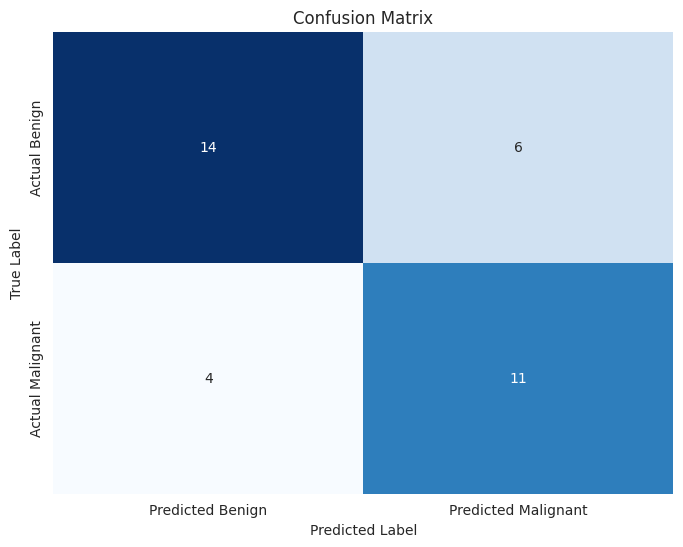

AUC (ROC): 0.8066666666666666
Precision-Recall AUC: 0.7749231592584107


In [ ]:
evaluate_model_performance(dataset_consumer_ai_batcheado, predictions, threshold=0.1)


## Test: DDI_656


###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + DDI_IMAGES_PATH
images_path_original = "/content/drive/MyDrive/Tesis/ID sets/DDI/images original RGBA png" #(carpeta images_original_RGBA_png)

csv_path_original = "/content/drive/MyDrive/Tesis/ID sets/DDI/Stanford - prediccionesstanford_28Feb_original_png.csv"
csv_path = ID_SETS_PATH_IUHI + DDI_CSV_TEST_PATH

df_test_ddi_png = pd.read_csv(csv_path_original)
print(f"tamaño del dataset: {len(df_test_ddi_png)}")
df_test_ddi_png.head()

tamaño del dataset: 656


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,resultado,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8
0,0,1,000001.png,56,True,melanoma-in-situ,0.9998618364,0.002357,1,0,0,0.037044,0.092266,0.066389,0.095087,0.054655,0.093870,0.091003,0.318142,0.092266
1,1,2,000002.png,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,1,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952
2,2,3,000003.png,56,True,mycosis-fungoides,6.36e-12,0.603778,0,1,0,0.048407,0.004547,0.048580,0.024234,0.071158,0.044688,0.025085,0.043403,0.004547
3,3,4,000004.png,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,1,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503
4,4,5,000005.png,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,1,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403


#### Cambio nombres .png a .jpg y creo nuevo csv

Cambio nombres ".png" a ".jpg"

In [ ]:
# Cambiar las extensiones de .png a .jpg en la columna DDI_file
df_test_ddi = df_test_ddi_png.copy()

df_test_ddi['DDI_file'] = df_test_ddi['DDI_file'].str.replace('.png', '.jpg', regex=False)

# Verificar el cambio
print(f"Tamaño del dataset: {len(df_test_ddi)}")
df_test_ddi.head()

Tamaño del dataset: 656


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,resultado,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8
0,0,1,000001.jpg,56,True,melanoma-in-situ,0.9998618364,0.002357,1,0,0,0.037044,0.092266,0.066389,0.095087,0.054655,0.093870,0.091003,0.318142,0.092266
1,1,2,000002.jpg,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,1,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952
2,2,3,000003.jpg,56,True,mycosis-fungoides,6.36e-12,0.603778,0,1,0,0.048407,0.004547,0.048580,0.024234,0.071158,0.044688,0.025085,0.043403,0.004547
3,3,4,000004.jpg,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,1,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503
4,4,5,000005.jpg,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,1,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403


Guardo el nuevo csv

*correr una sola vez*



```
# Guardar el DataFrame actualizado en un nuevo archivo CSV
output_csv_path = "/content/drive/MyDrive/Tesis/ID sets/DDI/Stanford - prediccionesstanford_28Feb_656.csv" # sería el csv_path pero lo dejo así que es mas claro
df_test_ddi.to_csv(output_csv_path, index=False)
print(f"Archivo actualizado guardado en: {output_csv_path}")
```



###Reviso imágenes originales

In [ ]:
df_image_info = extract_image_info(df = df_test_ddi_png, file_name_column = "DDI_file", images_path = images_path_original, file_extension = "", num_images = 15) # son .png
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(549, 948, 3)",0,219,uint8
1,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(618, 798, 4)",0,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(678, 921, 3)",64,253,uint8
3,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(285, 306, 4)",6,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 230, 4)",19,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(458, 323, 4)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(675, 918, 3)",5,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(666, 494, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 438, 4)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(654, 482, 3)",22,255,uint8


### RGBA a RGB y .png a .jpg (creo nueva carpeta)

*correr una sola vez*



```
output_path_images = "/content/drive/MyDrive/Tesis/ID sets/DDI/images" # sería images_path pero lo pongo así para que quede más claro
convert_to_rgb_and_jpg(df_test_ddi, file_name_column = "DDI_file", images_path = images_path_original, output_path = output_path_images)
```



Verifico que estén en RGB y .jpg

Las imgs están en .jpg

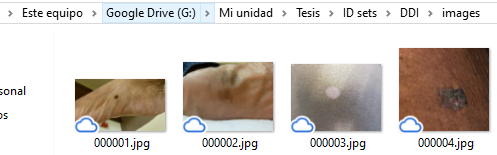

Verifico que estén en RGB (channels = 3)

In [ ]:
df_image_info = extract_image_info(df = df_test_ddi, file_name_column = "DDI_file", images_path = images_path, file_extension = "", num_images = 15) # son .png
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(549, 948, 3)",0,220,uint8
1,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(618, 798, 3)",0,247,uint8
2,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(678, 921, 3)",63,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(285, 306, 3)",4,200,uint8
4,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 230, 3)",17,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(458, 323, 3)",0,253,uint8
6,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(675, 918, 3)",5,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(666, 494, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 438, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(654, 482, 3)",18,255,uint8


### Convierto a tf (+ display opcional)

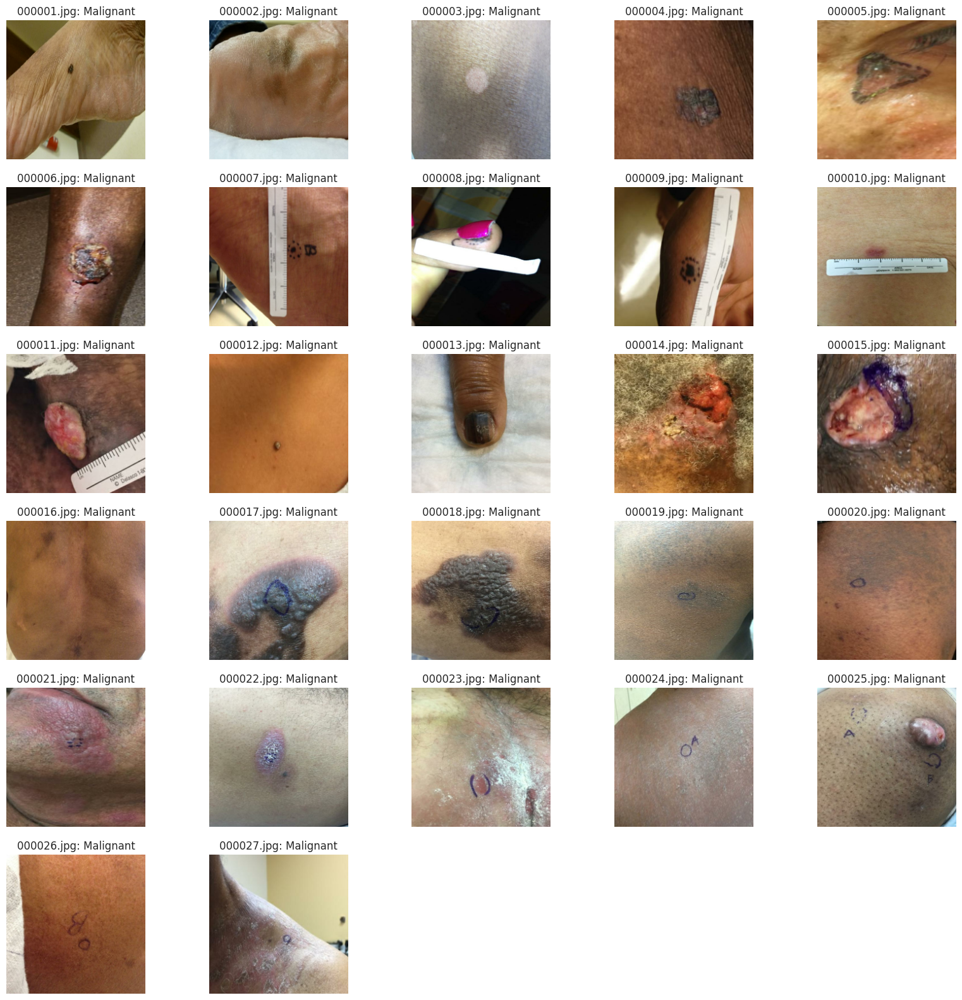

In [ ]:
# Configuración de los parámetros
#label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ddi656_test = prepare_dataset(df_test_ddi, images_path, file_name_column = "DDI_file", label_column='malignant', label_map=None, #None porque ya está que True es 1 y False 0 para malignant
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [ ]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
#dataset_ddi656_test_batcheado = dataset_ddi656_test.batch(len(dataset_ddi656_test))
dataset_ddi656_test_batcheado = dataset_ddi656_test.batch(64).prefetch(tf.data.AUTOTUNE)
predictions = model.predict(dataset_ddi656_test_batcheado)

predictions

11/11 [==============================] - 214s 19s/step


array([[0.06993993],
       [0.13653076],
       [0.04091135],
       [0.8583479 ],
       [0.7033197 ],
       [0.913978  ],
       [0.25951588],
       [0.4650039 ],
       [0.22983457],
       [0.28322494],
       [0.42437738],
       [0.05051129],
       [0.09133128],
       [0.14806412],
       [0.71795636],
       [0.09599018],
       [0.15858673],
       [0.41888538],
       [0.19875278],
       [0.20406306],
       [0.69829464],
       [0.47148097],
       [0.2661622 ],
       [0.05404032],
       [0.13407564],
       [0.03705266],
       [0.81612533],
       [0.08891828],
       [0.03790194],
       [0.32897168],
       [0.0293144 ],
       [0.11866622],
       [0.11232787],
       [0.33187786],
       [0.05319848],
       [0.09290228],
       [0.46128094],
       [0.7424083 ],
       [0.31431952],
       [0.47084492],
       [0.44367948],
       [0.3089565 ],
       [0.4707171 ],
       [0.41283828],
       [0.72523   ],
       [0.50421786],
       [0.0830112 ],
       [0.178

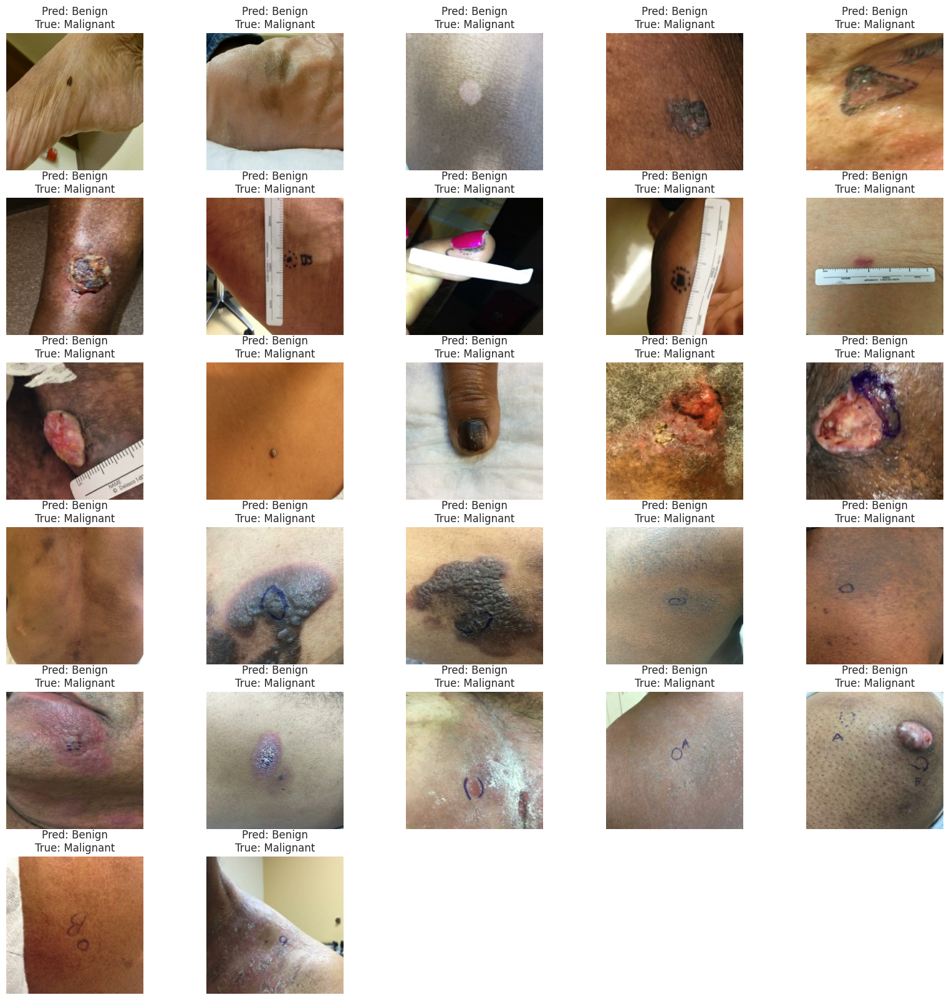

In [ ]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_ddi656_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.4298780487804878
Confusion Matrix:
[[142 343]
 [ 31 140]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.82      0.29      0.43       485
   Malignant       0.29      0.82      0.43       171

    accuracy                           0.43       656
   macro avg       0.56      0.56      0.43       656
weighted avg       0.68      0.43      0.43       656



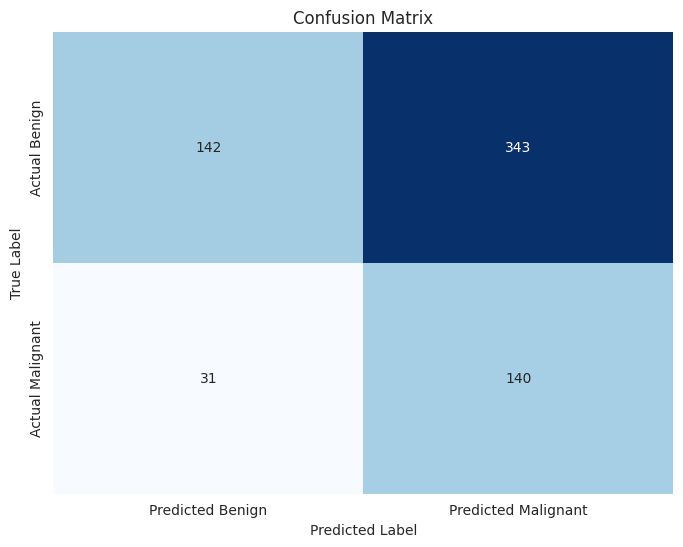

AUC (ROC): 0.6586724543317055
Precision-Recall AUC: 0.42781060028982754


In [ ]:
evaluate_model_performance(dataset_ddi656_test_batcheado, predictions, threshold=0.1)


## Test: DDI_209

###Creo df

In [ ]:
csv_path_656 = "/content/drive/MyDrive/Tesis/ID sets/DDI/Stanford - prediccionesstanford_28Feb_656.csv"

df_test_ddi656 = pd.read_csv(csv_path_656)
print(f"tamaño del dataset: {len(df_test_ddi656)}")
df_test_ddi656.head()

tamaño del dataset: 656


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,...,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8,image_path
0,0,1,000001.jpg,56,True,melanoma-in-situ,0.9998618364,0.002357,1,0,...,0.037044,0.092266,0.066389,0.095087,0.054655,0.093870,0.091003,0.318142,0.092266,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
1,1,2,000002.jpg,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,...,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
2,2,3,000003.jpg,56,True,mycosis-fungoides,6.36e-12,0.603778,0,1,...,0.048407,0.004547,0.048580,0.024234,0.071158,0.044688,0.025085,0.043403,0.004547,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
3,3,4,000004.jpg,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,...,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
4,4,5,000005.jpg,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,...,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403,/content/drive/MyDrive/Tesis/ID sets/DDI/image...


In [ ]:
# prompt: del dataset df_test_ddi656 me queiro quedar solo con las filas que tienen 0 en filtro 1 y 0 en filtro 2

# Filter the DataFrame
df_test_ddi209 = df_test_ddi656[(df_test_ddi656['filtro 1'] == 0) & (df_test_ddi656['filtro 2'] == 0)]
print(f"Tamaño dataset: {len(df_test_ddi209)}")
df_test_ddi209.head()

Tamaño dataset: 209


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,...,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8,image_path
1,1,2,000002.jpg,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,...,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
3,3,4,000004.jpg,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,...,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
4,4,5,000005.jpg,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,...,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
5,5,6,000006.jpg,56,True,squamous-cell-carcinoma,4.07e-08,0.000867,0,0,...,0.627829,0.928940,0.651504,0.871167,0.618072,0.935935,0.988713,0.979086,0.928940,/content/drive/MyDrive/Tesis/ID sets/DDI/image...
11,11,12,000012.jpg,56,True,squamous-cell-carcinoma-keratoacanthoma,2.17e-09,0.098085,0,0,...,0.015453,0.022766,0.035116,0.018857,0.139144,0.023444,0.033369,0.022460,0.022766,/content/drive/MyDrive/Tesis/ID sets/DDI/image...


### Creo carpeta images DDI 209 y le cargo las imágenes (para conformar df_ood_sana_recortadas_test)

*Correr una sola vez:*



```
#images_path = ID_SETS_PATH_IUHI + DDI_IMAGES_PATH
#DDI_IMAGES_PATH = "/DDI/images"
DDI_209_IMAGES_PATH = "/DDI/images_209" # ESTO ES SOLO PARA LOS RECORTES PARA CONFORMAR EL OOD CON LOS TEST SETS
images_path_209 = ID_SETS_PATH_IUHI + DDI_209_IMAGES_PATH

import shutil
import os

# Assuming images_path and images_path_209 are defined as in your provided code
# and df_test_ddi209 contains a column 'DDI_file' with image filenames.

# Create the destination directory if it doesn't exist
os.makedirs(images_path_209, exist_ok=True)

for index, row in df_test_ddi209.iterrows():
    source_image_path = os.path.join(images_path, row['DDI_file'])
    destination_image_path = os.path.join(images_path_209, row['DDI_file'])
    
    if os.path.exists(source_image_path):
        try:
            shutil.copy2(source_image_path, destination_image_path) # copy2 preserves metadata
            print(f"Copied: {source_image_path} to {destination_image_path}")
        except shutil.SameFileError:
            print(f"Source and destination are the same file: {source_image_path}")
        except Exception as e:
            print(f"Error copying {source_image_path}: {e}")
    else:
        print(f"Source image not found: {source_image_path}")```



### Verifico que estén en RGB (channels = 3)

In [ ]:
df_image_info = extract_image_info(df = df_test_ddi209, file_name_column = "DDI_file", images_path = images_path, file_extension = "", num_images = 15) # son .png
df_image_info

<ipython-input-4-0321bc417d3f>:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(618, 798, 3)",0,247,uint8
1,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(285, 306, 3)",4,200,uint8
2,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 230, 3)",17,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(458, 323, 3)",0,253,uint8
4,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(305, 372, 3)",2,240,uint8
5,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(222, 313, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(596, 846, 3)",4,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(686, 687, 3)",9,254,uint8
8,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(690, 690, 3)",6,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(514, 342, 3)",0,199,uint8


### Convierto a tf (+ display opcional)

<ipython-input-5-c1c6b8682781>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-5-c1c6b8682781>:38: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



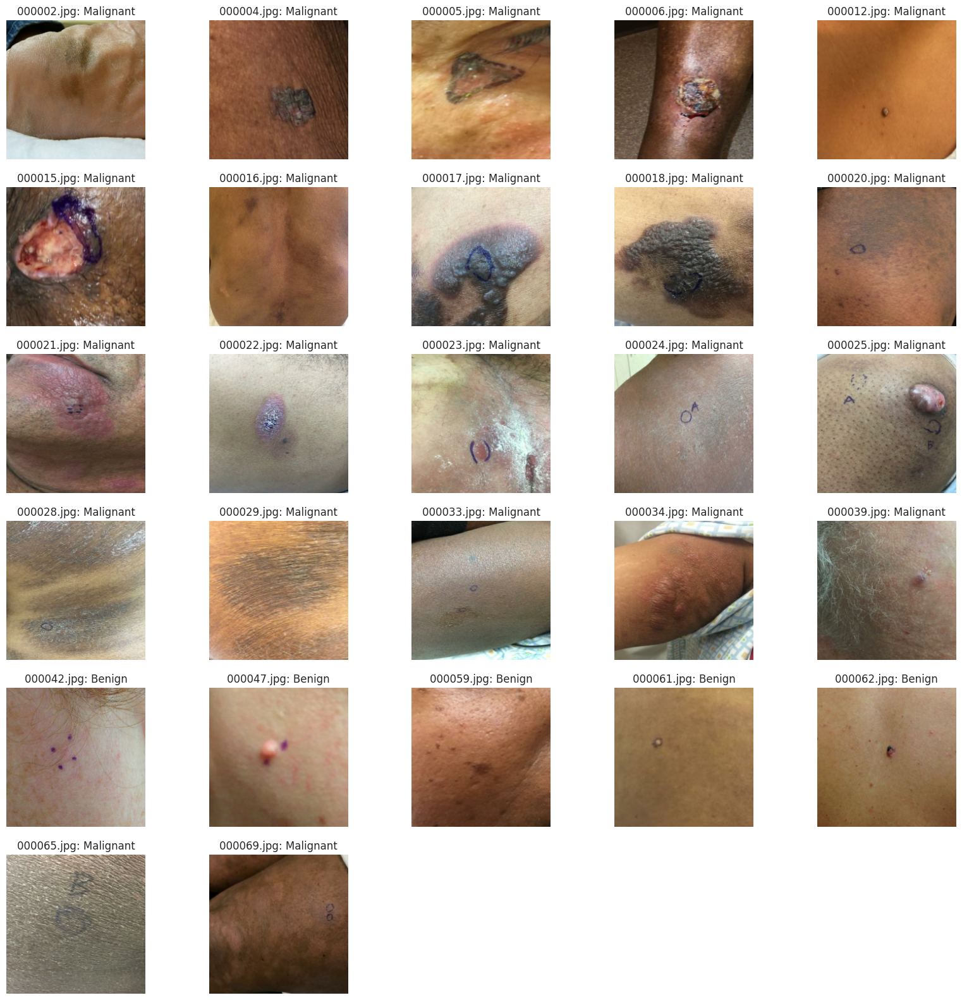

In [ ]:
# Configuración de los parámetros
#label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ddi209_test = prepare_dataset(df_test_ddi209, images_path, file_name_column = "DDI_file", label_column='malignant', label_map=None, #None porque ya está que True es 1 y False 0 para malignant
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [ ]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
#dataset_ddi656_test_batcheado = dataset_ddi656_test.batch(len(dataset_ddi656_test))
dataset_ddi209_test_batcheado = dataset_ddi209_test.batch(64).prefetch(tf.data.AUTOTUNE)
predictions = model.predict(dataset_ddi209_test_batcheado)

predictions

4/4 [==============================] - 6s 2s/step


array([[0.13653076],
       [0.8583479 ],
       [0.7033197 ],
       [0.913978  ],
       [0.05051129],
       [0.71795636],
       [0.09599018],
       [0.15858673],
       [0.41888538],
       [0.20406306],
       [0.69829464],
       [0.47148097],
       [0.2661622 ],
       [0.05404032],
       [0.13407564],
       [0.08891828],
       [0.03790194],
       [0.11232787],
       [0.33187786],
       [0.31431952],
       [0.3089565 ],
       [0.0830112 ],
       [0.07427547],
       [0.00589355],
       [0.1382381 ],
       [0.05149262],
       [0.05221741],
       [0.1698549 ],
       [0.0940326 ],
       [0.06635088],
       [0.03300453],
       [0.18234254],
       [0.8340686 ],
       [0.6040377 ],
       [0.18364304],
       [0.23648728],
       [0.71592766],
       [0.17477359],
       [0.24636419],
       [0.11951929],
       [0.13546433],
       [0.3910028 ],
       [0.11245962],
       [0.0774174 ],
       [0.4894946 ],
       [0.20310782],
       [0.06599187],
       [0.019

In [ ]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_ddi209_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.5119617224880383
Confusion Matrix:
[[49 91]
 [11 58]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.82      0.35      0.49       140
   Malignant       0.39      0.84      0.53        69

    accuracy                           0.51       209
   macro avg       0.60      0.60      0.51       209
weighted avg       0.68      0.51      0.50       209



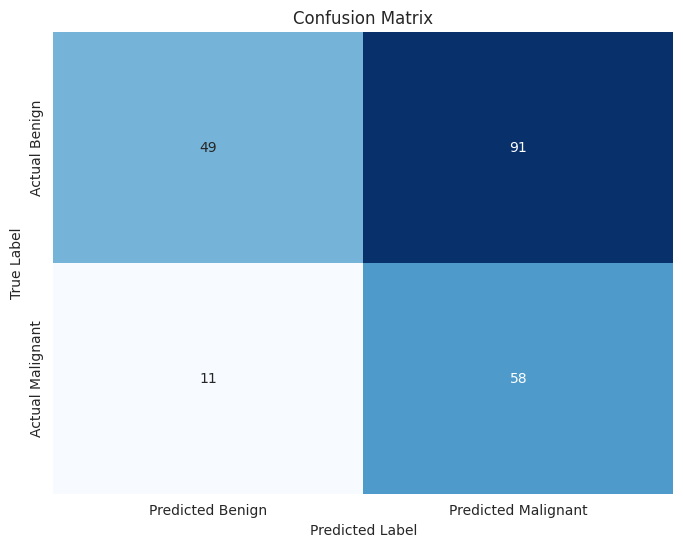

AUC (ROC): 0.696376811594203
Precision-Recall AUC: 0.5344264806174698


In [ ]:
evaluate_model_performance(dataset_ddi209_test_batcheado, predictions, threshold=0.1)


## Test: Institucional

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + INSTITUCIONAL_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + INSTITUCIONAL_CSV_TEST_PATH

df_test_institucional = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_test_institucional)}")
df_test_institucional.head()

tamaño del dataset: 127


,Unnamed: 0,filename,image_type,benign_malignant,diagnosis,diagnosis_confirm_type,anatom_site_general,age,sex,lesion_id,...,result_2,binary_result_1,binary_result_2,aprobada,subset,subset_test,modelo 0,modelo 2,modelo 3,modelo 5
0,6,image203.jpg,clinical,benign,vascular lesion,NaN,anterior torso,76.0,male,les5,...,0.001080,0,0,VERDADERO,Test,Test_A,0.024185,0.039990,0.432276,0.102198
1,11,image837.jpg,clinical,benign,actinic keratosis,histopathology,posterior torso,74.0,female,les1,...,0.002301,0,0,VERDADERO,Test,Test_A,0.070791,0.032154,0.057352,0.087453
2,12,image838.jpg,clinical,malignant,basal cell carcinoma,histopathology,anterior torso,74.0,female,les2,...,0.007297,0,0,VERDADERO,Test,Test_A,0.082425,0.240629,0.233446,0.033466
3,14,image888.jpg,clinical,malignant,melanoma,histopathology,posterior torso,64.0,male,les1,...,0.050514,0,0,VERDADERO,Test,Test_A,0.079354,0.296706,0.927234,0.796668
4,15,image890.jpg,clinical,malignant,squamous cell carcinoma,histopathology,upper extremity,67.0,male,les1,...,0.008407,0,0,VERDADERO,Test,Test_A,0.077548,0.035709,0.028295,0.066248


### Creo carpeta images Test Institucional 127 y le cargo las 127 imágenes (para conformar df_ood_sana_recortadas_test)

*Correr una sola vez:*



```
#Institucional
INSTITUCIONAL_IMAGES_PATH_127 = "/Institucional/images_127"
images_path_127 = ID_SETS_PATH_IUHI + INSTITUCIONAL_IMAGES_PATH_127

import shutil
import os

# Assuming images_path and images_path_395 are defined as in your provided code
# and df_test_fitz contains a column 'DDI_file' with image filenames.

# Create the destination directory if it doesn't exist
os.makedirs(images_path_127, exist_ok=True)

for index, row in df_test_institucional.iterrows():
    source_image_path = os.path.join(images_path, row['filename'])
    destination_image_path = os.path.join(images_path_127, row['filename'])

    if os.path.exists(source_image_path):
        try:
            shutil.copy2(source_image_path, destination_image_path) # copy2 preserves metadata
            print(f"Copied: {source_image_path} to {destination_image_path}")
        except shutil.SameFileError:
            print(f"Source and destination are the same file: {source_image_path}")
        except Exception as e:
            print(f"Error copying {source_image_path}: {e}")
    else:
        print(f"Source image not found: {source_image_path}")
```



###Reviso imágenes

In [ ]:
df_image_info = extract_image_info(df = df_test_institucional, file_name_column = "filename", images_path = images_path, file_extension = "", num_images = 15)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1024, 768, 3)",16,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1682, 1056, 3)",9,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(733, 1041, 3)",33,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(384, 512, 3)",11,235,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(170, 170, 3)",60,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1035, 776, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(884, 663, 3)",2,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(910, 992, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1220, 1627, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(573, 559, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

In [ ]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_institucional_test = prepare_dataset(df_test_institucional, images_path, file_name_column = "filename", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [ ]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
#dataset_institucional_test_batcheado = dataset_institucional_test.batch(len(dataset_institucional_test))
dataset_institucional_test_batcheado = dataset_institucional_test.batch(64).prefetch(tf.data.AUTOTUNE)
predictions = model.predict(dataset_institucional_test_batcheado)

predictions

2/2 [==============================] - 43s 29s/step


array([[0.0791938 ],
       [0.06812301],
       [0.02797788],
       [0.82163656],
       [0.07634611],
       [0.5737455 ],
       [0.6799577 ],
       [0.8412745 ],
       [0.7299264 ],
       [0.41449174],
       [0.3821775 ],
       [0.33029032],
       [0.8550982 ],
       [0.7118074 ],
       [0.16670826],
       [0.12711076],
       [0.14442953],
       [0.02589628],
       [0.04668226],
       [0.18963005],
       [0.03363723],
       [0.42809638],
       [0.78565925],
       [0.78516155],
       [0.7388831 ],
       [0.48438308],
       [0.10348887],
       [0.16235381],
       [0.14317337],
       [0.35153908],
       [0.3119801 ],
       [0.37611365],
       [0.19445552],
       [0.11202864],
       [0.43733525],
       [0.09416991],
       [0.7882929 ],
       [0.7145021 ],
       [0.93865293],
       [0.13563713],
       [0.54321647],
       [0.8079582 ],
       [0.91878974],
       [0.5462114 ],
       [0.5774426 ],
       [0.26821303],
       [0.38777918],
       [0.710

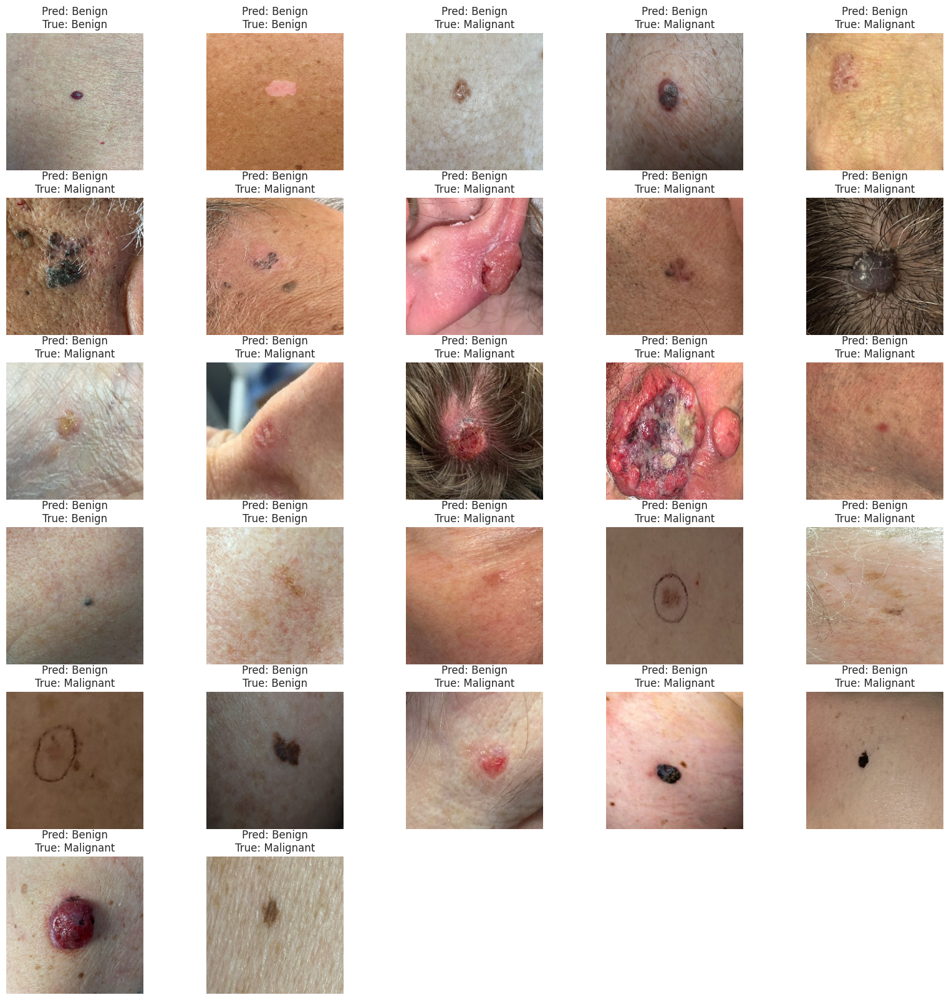

In [ ]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_institucional_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.7086614173228346
Confusion Matrix:
[[18 26]
 [11 72]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.62      0.41      0.49        44
   Malignant       0.73      0.87      0.80        83

    accuracy                           0.71       127
   macro avg       0.68      0.64      0.64       127
weighted avg       0.70      0.71      0.69       127



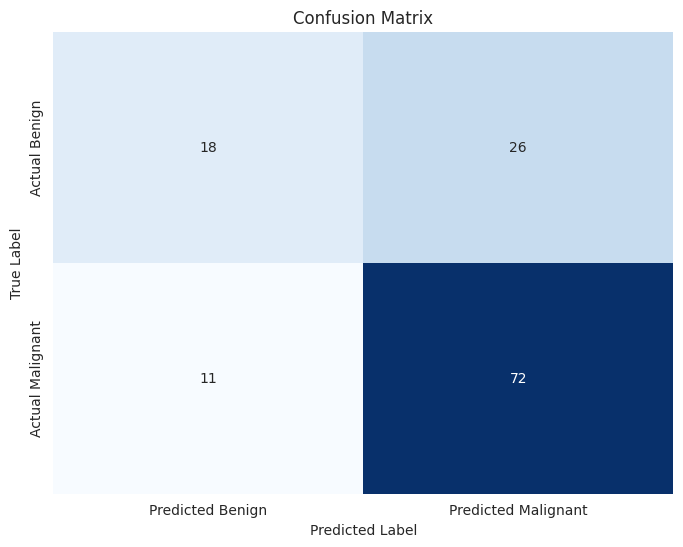

AUC (ROC): 0.735761226725082
Precision-Recall AUC: 0.8517345821283592


In [ ]:
evaluate_model_performance(dataset_institucional_test_batcheado, predictions, threshold=0.1)


## Test: Fitz

###Creo df

In [ ]:
images_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_CSV_TEST_PATH

df_test_fitz = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_test_fitz)}")
df_test_fitz.head()

tamaño del dataset: 395


,Unnamed: 0,img_path,label
0,1647,aac12918e020bed883f2eb321dac661e.jpg,malignant
1,847,4049f356db33c72f029d619fe35f6fc5.jpg,benign
2,2379,257b98dac6241fa7fc474d3ccd0cc23e.jpg,malignant
3,402,145e13a479f0c026fcb0630d2f9d47b8.jpg,benign
4,2041,07bbb2e37d5e4febf70890df43c9fbd6.jpg,malignant


### Creo carpeta images Test Fitz y le cargo las 395 imágenes (para conformar df_ood_sana_recortadas_test)

*Correr una sola vez:*



```
#Fitzpatrick17k
FITZPATRICK17K_IMAGES_PATH = "/Fitzpatrick17k/images"
FITZPATRICK17K_TEST_IMAGES_PATH = "/Fitzpatrick17k/images_test"
images_path_395 = ID_SETS_PATH_IUHI + FITZPATRICK17K_TEST_IMAGES_PATH

#FITZPATRICK17K_CSV_TEST_PATH = "/Fitzpatrick17k/filtered_fitz_test.csv"


import shutil
import os

# Assuming images_path and images_path_395 are defined as in your provided code
# and df_test_fitz contains a column 'DDI_file' with image filenames.

# Create the destination directory if it doesn't exist
os.makedirs(images_path_395, exist_ok=True)

for index, row in df_test_fitz.iterrows():
    source_image_path = os.path.join(images_path, row['img_path'])
    destination_image_path = os.path.join(images_path_395, row['img_path'])
    
    if os.path.exists(source_image_path):
        try:
            shutil.copy2(source_image_path, destination_image_path) # copy2 preserves metadata
            print(f"Copied: {source_image_path} to {destination_image_path}")
        except shutil.SameFileError:
            print(f"Source and destination are the same file: {source_image_path}")
        except Exception as e:
            print(f"Error copying {source_image_path}: {e}")
    else:
        print(f"Source image not found: {source_image_path}")```



###Reviso imágenes

In [ ]:
df_image_info = extract_image_info(df = df_test_fitz, file_name_column = "img_path", images_path = images_path, file_extension = "", num_images = 15)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 286, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(353, 435, 3)",4,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(368, 507, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(348, 480, 3)",33,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(320, 320, 3)",0,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(400, 443, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(400, 400, 3)",0,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(393, 450, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(449, 347, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(316, 444, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

In [ ]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_fitz_test = prepare_dataset(df_test_fitz, images_path, file_name_column = "img_path", label_column='label', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [ ]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
#dataset_fitz_test_batcheado = dataset_fitz_test.batch(len(dataset_fitz_test))
dataset_fitz_test_batcheado = dataset_fitz_test.batch(64).prefetch(tf.data.AUTOTUNE)
predictions = model.predict(dataset_fitz_test_batcheado)

predictions

7/7 [==============================] - 136s 20s/step


array([[0.22233844],
       [0.00695176],
       [0.8672982 ],
       [0.07097372],
       [0.907647  ],
       [0.4097817 ],
       [0.5896862 ],
       [0.727501  ],
       [0.6156775 ],
       [0.37335157],
       [0.86272764],
       [0.05309543],
       [0.34958804],
       [0.69939554],
       [0.9403034 ],
       [0.5813706 ],
       [0.28880432],
       [0.02943731],
       [0.27843076],
       [0.3214979 ],
       [0.17302004],
       [0.11880545],
       [0.44504648],
       [0.09336272],
       [0.567922  ],
       [0.7824932 ],
       [0.4580407 ],
       [0.4578755 ],
       [0.6024856 ],
       [0.9511402 ],
       [0.8029068 ],
       [0.40443602],
       [0.514729  ],
       [0.96130973],
       [0.74517965],
       [0.2410161 ],
       [0.09852298],
       [0.15494078],
       [0.85143954],
       [0.42542523],
       [0.18404737],
       [0.02659215],
       [0.6882426 ],
       [0.17041133],
       [0.7135792 ],
       [0.754214  ],
       [0.18991175],
       [0.135

In [ ]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_fitz_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.6962025316455697
Confusion Matrix:
[[ 36 113]
 [  7 239]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.84      0.24      0.38       149
   Malignant       0.68      0.97      0.80       246

    accuracy                           0.70       395
   macro avg       0.76      0.61      0.59       395
weighted avg       0.74      0.70      0.64       395



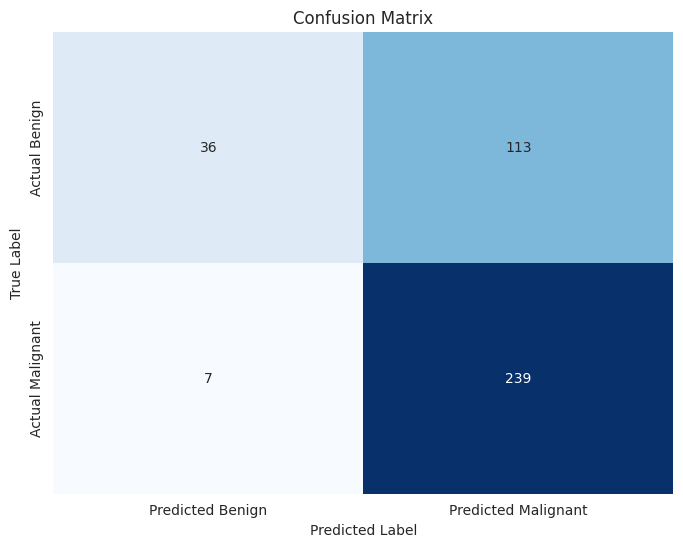

AUC (ROC): 0.8133355159054947
Precision-Recall AUC: 0.8710009040509246


In [ ]:
evaluate_model_performance(dataset_fitz_test_batcheado, predictions, threshold=0.1)


## CONCATENAR DATASETS TEST TFlow

In [ ]:
# Concatenar los datasets
combined_dataset_test_con656 = dataset_consumer_ai_test.concatenate(dataset_ddi656_test).concatenate(dataset_institucional_test).concatenate(dataset_fitz_test)
combined_dataset_test_con209 = dataset_consumer_ai_test.concatenate(dataset_ddi209_test).concatenate(dataset_institucional_test).concatenate(dataset_fitz_test)
combined_dataset_test_sin_ddi = dataset_consumer_ai_test.concatenate(dataset_institucional_test).concatenate(dataset_fitz_test)

# Optimizar la carga del dataset para acelerar la concatenación
combined_dataset_test_con656 = combined_dataset_test_con656.cache().prefetch(tf.data.AUTOTUNE)
combined_dataset_test_con209 = combined_dataset_test_con209.cache().prefetch(tf.data.AUTOTUNE)
combined_dataset_test_sin_ddi = combined_dataset_test_sin_ddi.cache().prefetch(tf.data.AUTOTUNE)

# Ver el número total de ejemplos
num_examples_656 = tf.data.experimental.cardinality(combined_dataset_test_con656).numpy()
num_examples_209 = tf.data.experimental.cardinality(combined_dataset_test_con209).numpy()
num_examples_sin_ddi = tf.data.experimental.cardinality(combined_dataset_test_sin_ddi).numpy()

print(f"Número total de ejemplos en el dataset combinado con 656: {num_examples_656}")
print(f"Número total de ejemplos en el dataset combinado con 209: {num_examples_209}")


Número total de ejemplos en el dataset combinado con 656: 1213
Número total de ejemplos en el dataset combinado con 209: 766


## CREACIÓN DE DICTS:

In [ ]:
#DS_FIT:
dataset_fitz_train_dict = dataset_fitz_train.map(lambda image, label: convert_to_dict(image, label))
dataset_ISIC_train_dict = dataset_ISIC_train.map(lambda image, label: convert_to_dict(image, label))
dataset_PAD_UFES_train_dict = dataset_PAD_UFES_train.map(lambda image, label: convert_to_dict(image, label))

combined_dataset_train_dict = combined_dataset_train.map(lambda image, label: convert_to_dict(image, label))

# DS_IN
# Convert to dictionary format expected by OODDataset
dataset_consumer_ai_test_dict = dataset_consumer_ai_test.map(lambda image, label: convert_to_dict(image, label))
dataset_ddi656_test_dict = dataset_ddi656_test.map(lambda image, label: convert_to_dict(image, label))
dataset_ddi209_test_dict = dataset_ddi209_test.map(lambda image, label: convert_to_dict(image, label))

dataset_institucional_test_dict = dataset_institucional_test.map(lambda image, label: convert_to_dict(image, label))
dataset_fitz_test_dict = dataset_fitz_test.map(lambda image, label: convert_to_dict(image, label))

combined_dataset_test_con656_dict = combined_dataset_test_con656.map(lambda image, label: convert_to_dict(image, label))
combined_dataset_test_con209_dict = combined_dataset_test_con209.map(lambda image, label: convert_to_dict(image, label))
combined_dataset_test_sin_ddi_dict = combined_dataset_test_sin_ddi.map(lambda image, label: convert_to_dict(image, label))

# DS_OUT (OOD):
dataset_fitz_ood_with_label_ok = dataset_fitz_ood_ok.map(add_dummy_label)
dataset_fitz_ood_dict_ok = dataset_fitz_ood_with_label_ok.map(lambda image, label: convert_to_dict(image, label))

# DS_OUT (OOD):
dataset_fitz_ood_with_label_filtrado_ambos = dataset_fitz_ood_filtrado_ambos.map(add_dummy_label)
dataset_fitz_ood_dict_filtrado_ambos = dataset_fitz_ood_with_label_filtrado_ambos.map(lambda image, label: convert_to_dict(image, label))

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        dataset_fitz_train_dict: "DS_FIT Fitz",
        dataset_ISIC_train_dict: "DS_FIT ISIC",
        dataset_PAD_UFES_train_dict: "DS_FIT PAD_UFES",
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        dataset_consumer_ai_test_dict: "Consumer_AI",
        dataset_ddi656_test_dict: "DDI 656",
        dataset_ddi209_test_dict: "DDI 209",
        dataset_institucional_test_dict: "Institucional",
        dataset_fitz_test_dict: "Fitz",
        combined_dataset_test_con656_dict: "Combinado con 656",
        combined_dataset_test_con209_dict: "Combinado test",
        combined_dataset_test_sin_ddi_dict: "Combinado sin DDI"
    },
    "ds_out_seteado": {
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_psoriasis_dict: "OOD Fitz ok: Psoriasis",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_folliculitis_dict: "OOD Fitz ok: Folliculitis",
        dataset_fitz_ood_sarcoidosis_dict: "OOD Fitz ok: Sarcoidosis",
        dataset_fitz_ood_lichen_planus_dict: "OOD Fitz ok: Lichen planus",
        dataset_fitz_ood_lupus_erythematosus_dict: "OOD Fitz ok: Lupus erythematosus",
        dataset_fitz_ood_neutrophilic_dermatoses_dict: "OOD Fitz ok: Neutrophilic dermatoses",
        dataset_fitz_ood_allergic_contact_dermatitis_dict: "OOD Fitz ok: Allergic contact dermatitis",
        dataset_fitz_ood_scabies_dict: "OOD Fitz ok: Scabies",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_acne_dict: "OOD Fitz ok: Acne",
        dataset_fitz_ood_nematode_infection_dict: "OOD Fitz ok: Nematode infection",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        dataset_fitz_ood_photodermatoses_dict: "OOD Fitz ok: Photodermatoses",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST",
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana"
    }
}

# DATASETS TRAIN Y TEST *CHECKPOINT*:



## DF TEST COMBINED Y CONVIERTO A TF y a dict (para no correr todas las celdas de test)


### Creo df

*Correr una vez*

Incluye Consumer AI 35, Institucional 127, Fitz test 395 y DDI 209. Total: 766 imgs



```
images_test_combined_path = "/content/drive/MyDrive/Tesis/ID sets/images_OOD_Test_combined"
len(df_test_consumer_ai), len(df_test_institucional), len(df_test_fitz), len(df_test_ddi209)


def process_dataframe(df, filename_col, label_col, extension):
    df = df.copy()  # Crear una copia para no modificar el DataFrame original
    df['name'] = df[filename_col] + extension
    
    # Verificar si la columna ya contiene valores booleanos
    if df[label_col].dtype != 'bool':
        df['label'] = df[label_col].map({'benign': False, 'malignant': True})
    else:
        df['label'] = df[label_col]  # Mantener los valores tal como están
    
    df = df[['name', 'label']]  # Conservar solo las columnas necesarias
    return df

# Procesar los DataFrames
df_consumer_ai_procesado = process_dataframe(df_test_consumer_ai, 'name', 'benign_malignant', '.jpg')
df_institucional_procesado = process_dataframe(df_test_institucional, 'filename', 'benign_malignant', '')  # Ya tiene .jpg
df_fitz_procesado = process_dataframe(df_test_fitz, 'img_path', 'label', '')  # Ya tiene .jpg
df_ddi209_procesado = process_dataframe(df_test_ddi209, 'DDI_file', 'malignant', '')  # Ya tiene valores booleanos

# Concatenar los DataFrames
combined_test_df = pd.concat([df_consumer_ai_procesado, df_institucional_procesado,
                              df_fitz_procesado, df_ddi209_procesado], ignore_index=True)

# Resultado
combined_test_df.head(), len(combined_test_df)

print("Value counts for df_consumer_ai labels:")
print(df_test_consumer_ai['benign_malignant'].value_counts())

print("\nValue counts for df_institucional labels:")
print(df_test_institucional['benign_malignant'].value_counts())

print("\nValue counts for df_fitz labels:")
print(df_test_fitz['label'].value_counts())

print("\nValue counts for df_ddi209 labels:")
print(df_test_ddi209['malignant'].value_counts())

print("\nValue counts for combined_test_df labels:")
print(combined_test_df['label'].value_counts())

combined_test_df.to_csv("/content/drive/MyDrive/Tesis/ID sets/OOD_Test_combined.csv", index=False)
```



### Cargo df y convierto a tf

In [ ]:

#TEST COMBINED:
#TEST_COMBINED_IMAGES_PATH = "/images_OOD_Test_combined"
#TEST_COMBINED_CSV_TEST_PATH = "/OOD_Test_combined.csv"
# Configuración de los parámetros
df_test_combined = pd.read_csv(ID_SETS_PATH_IUHI + TEST_COMBINED_CSV_TEST_PATH)
images_path = ID_SETS_PATH_IUHI + TEST_COMBINED_IMAGES_PATH

# Llamada a la función
combined_dataset_test_con209 = prepare_dataset(df_test_combined, images_path, file_name_column = "name", label_column='label', label_map=None, #None porque ya está que True es 1 y False 0 para malignant
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=False, num_display_samples=27, remove_labels=False, file_extension="")
combined_dataset_test_con209 = combined_dataset_test_con209.cache().prefetch(tf.data.AUTOTUNE)
num_examples_209 = tf.data.experimental.cardinality(combined_dataset_test_con209).numpy()
print(f"Número total de ejemplos en el dataset combinado con 209: {num_examples_209}")

combined_dataset_test_con209_dict = combined_dataset_test_con209.map(lambda image, label: convert_to_dict(image, label))
len(combined_dataset_test_con209_dict)

Número total de ejemplos en el dataset combinado con 209: 766


766

## DF TRAIN COMBINED Y CONVIERTO A TF y a dict(para no correr todas las celdas de train)


Incluye:
ISIC: 1616

PAD_UFES: 2298

Fitz: 1951

Total: 5865

### Corre todas las celdas train que sirven de una


In [ ]:
# TRAIN: FITZ
images_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_CSV_TRAIN_PATH

df_train_fitz = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_fitz)}")
df_train_fitz.head()

# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_fitz_train = prepare_dataset(df_train_fitz, images_path, file_name_column = "img_path", label_column='label', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=False, num_display_samples=27, remove_labels=False, file_extension="")


#TRAIN: ISIC
images_path = ID_SETS_PATH_IUHI + ISIC_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + ISIC_CSV_TRAIN_PATH

df_train_ISIC = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_ISIC)}")
df_train_ISIC.head()
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ISIC_train = prepare_dataset(df_train_ISIC, images_path, file_name_column = "isic_id", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=False, num_display_samples=27, remove_labels=False, file_extension=".jpg")

# TRAIN: PAS_UFES
images_path = ID_SETS_PATH_IUHI + PAD_UFES_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + PAD_UFES_CSV_TRAIN_PATH

df_train_PAD_UFES = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_train_PAD_UFES)}")
df_train_PAD_UFES['name'] = df_train_PAD_UFES['img_id'].str.replace('.png', '.jpg') # a diferencia del resto acá proceso así porque está en .png en el df (igual en carpeta son .jpg)

# Mapeo de diagnósticos a "benign" o "malignant"
diagnostic_map = {
    "BCC": "malignant",
    "MEL": "malignant",
    "SCC": "malignant",
    "ACK": "benign",
    "NEV": "benign",
    "SEK": "benign"
}

# Crear la nueva columna "benign_malignant" en el DataFrame
df_train_PAD_UFES["benign_malignant"] = df_train_PAD_UFES["diagnostic"].map(diagnostic_map)

# Verificar los primeros registros para asegurarse de que la columna se ha agregado correctamente
df_train_PAD_UFES[["name", "benign_malignant", "diagnostic", "benign_malignant"]].head()
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_PAD_UFES_train = prepare_dataset(df_train_PAD_UFES, images_path, file_name_column = "name", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=False, num_display_samples=27, remove_labels=False, file_extension="")

# CONCATENO:

# Concatenar los datasets
combined_dataset_train = dataset_fitz_train.concatenate(dataset_ISIC_train).concatenate(dataset_PAD_UFES_train)

# Optimizar la carga del dataset para acelerar la concatenación
combined_dataset_train = combined_dataset_train.cache().prefetch(tf.data.AUTOTUNE)

# Ver el número total de ejemplos
num_examples = tf.data.experimental.cardinality(combined_dataset_train).numpy()
print(f"Número total de ejemplos en el dataset combinado: {num_examples}")

combined_dataset_train_dict = combined_dataset_train.map(lambda image, label: convert_to_dict(image, label))
len(combined_dataset_train_dict)


tamaño del dataset: 1951
tamaño del dataset: 1616
tamaño del dataset: 2298
Número total de ejemplos en el dataset combinado: 5865


5865



```
images_test_combined_path = "/content/drive/MyDrive/Tesis/ID sets/images_OOD_Test_combined"
len(df_test_consumer_ai), len(df_test_institucional), len(df_test_fitz), len(df_test_ddi209)


def process_dataframe(df, filename_col, label_col, extension):
    df = df.copy()  # Crear una copia para no modificar el DataFrame original
    df['name'] = df[filename_col] + extension
    
    # Verificar si la columna ya contiene valores booleanos
    if df[label_col].dtype != 'bool':
        df['label'] = df[label_col].map({'benign': False, 'malignant': True})
    else:
        df['label'] = df[label_col]  # Mantener los valores tal como están
    
    df = df[['name', 'label']]  # Conservar solo las columnas necesarias
    return df

# Procesar los DataFrames
df_consumer_ai_procesado = process_dataframe(df_test_consumer_ai, 'name', 'benign_malignant', '.jpg')
df_institucional_procesado = process_dataframe(df_test_institucional, 'filename', 'benign_malignant', '')  # Ya tiene .jpg
df_fitz_procesado = process_dataframe(df_test_fitz, 'img_path', 'label', '')  # Ya tiene .jpg
df_ddi209_procesado = process_dataframe(df_test_ddi209, 'DDI_file', 'malignant', '')  # Ya tiene valores booleanos

# Concatenar los DataFrames
combined_test_df = pd.concat([df_consumer_ai_procesado, df_institucional_procesado,
                              df_fitz_procesado, df_ddi209_procesado], ignore_index=True)

# Resultado
combined_test_df.head(), len(combined_test_df)

print("Value counts for df_consumer_ai labels:")
print(df_test_consumer_ai['benign_malignant'].value_counts())

print("\nValue counts for df_institucional labels:")
print(df_test_institucional['benign_malignant'].value_counts())

print("\nValue counts for df_fitz labels:")
print(df_test_fitz['label'].value_counts())

print("\nValue counts for df_ddi209 labels:")
print(df_test_ddi209['malignant'].value_counts())

print("\nValue counts for combined_test_df labels:")
print(combined_test_df['label'].value_counts())

combined_test_df.to_csv("/content/drive/MyDrive/Tesis/ID sets/OOD_Test_combined.csv", index=False)
```



# OOD DATASETS:

## OOD: MNIST, Fashion MNIST

### MNIST

Dl Completed...:   0%|          | 0/5 [00:00<?, ? file/s]

Dataset mnist downloaded and prepared to /root/tensorflow_datasets/mnist/3.0.1. Subsequent calls will reuse this data.


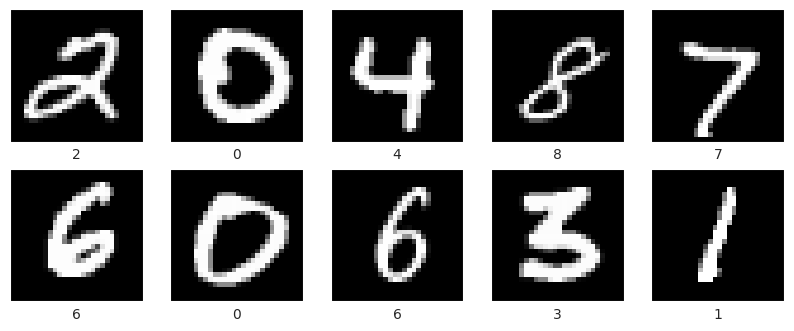

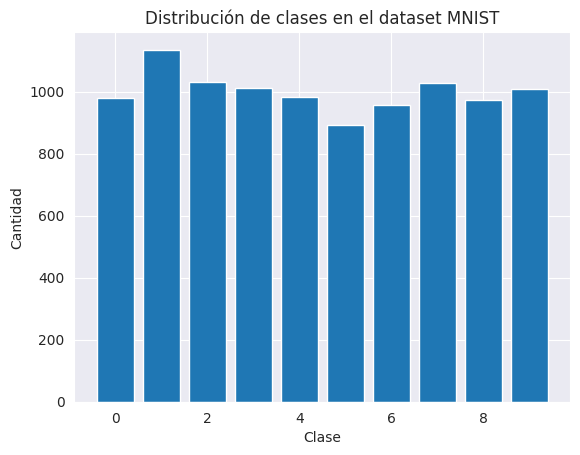

In [ ]:
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

# Cargar el dataset MNIST desde TensorFlow Datasets
ds_test_mnist = tfds.load('mnist', split='test')

plot_images(ds_test_mnist, 10)
plot_class_distribution(ds_test_mnist)


### Fashion MNIST:

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/60000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/3.0.1.incomplete02T5ZC/fashion_mnist-train.tfrecord*...:   0…

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/3.0.1.incomplete02T5ZC/fashion_mnist-test.tfrecord*...:   0%…

Dataset fashion_mnist downloaded and prepared to /root/tensorflow_datasets/fashion_mnist/3.0.1. Subsequent calls will reuse this data.


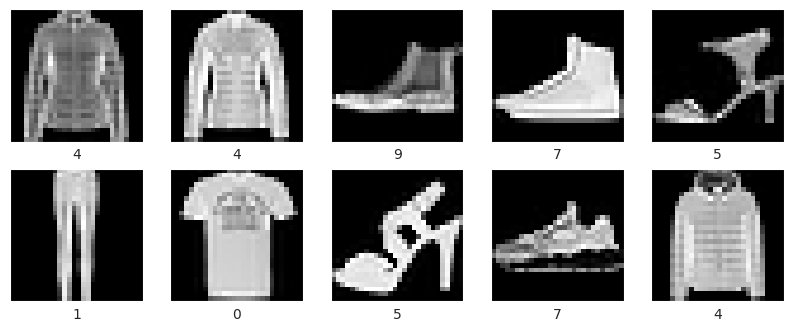

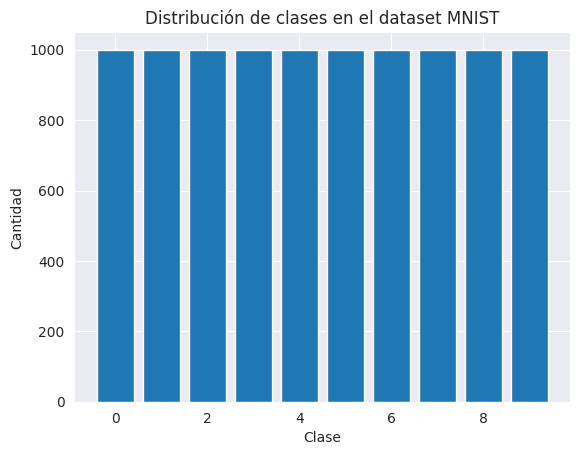

In [ ]:
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

# Cargar el dataset FASHION MNIST desde TensorFlow Datasets
ds_test_fashion_mnist = tfds.load('fashion_mnist', split='test')

plot_images(ds_test_fashion_mnist, 10)
plot_class_distribution(ds_test_fashion_mnist)

## OOD: Fitz: *ok* y *filtrado_ambos*

### Paths:

In [ ]:
images_path_ok = FITZPATRICK17K_OOD_IMAGES_PATH_OK
images_path_filtrado_ambos = FITZPATRICK17K_OOD_IMAGES_PATH_FILTRADO_AMBOS

csv_path_completo = FITZPATRICK17K_OOD_CSV_PATH_COMPLETO
csv_path_ok = FITZPATRICK17K_OOD_CSV_PATH_OK
csv_path_filtrado_ambos = FITZPATRICK17K_OOD_CSV_PATH_FILTRADO_AMBOS


###Creo dfs

In [ ]:
df_ood_fitz_completo  = pd.read_csv(csv_path_completo)
df_ood_fitz_ok = pd.read_csv(csv_path_ok)
df_ood_fitz_filtrado_ambos = pd.read_csv(csv_path_filtrado_ambos)

print(f"tamaño del dataset completo: {len(df_ood_fitz_completo)}")
print(f"tamaño del dataset ok: {len(df_ood_fitz_ok)}")
print(f"tamaño del dataset: {len(df_ood_fitz_filtrado_ambos)}")


tamaño del dataset completo: 12080
tamaño del dataset ok: 4693
tamaño del dataset: 2772


### Analizo labels y creo nuevos sub-df de ood_fitz_ok

In [ ]:
ood_fitz_dfs_dict = filtar_labels_por_sample_count_y_crear_dfs(df_ood_fitz_ok, num_samples_por_label = 100 , label_column='label')

df_ood_psoriasis: 244, Percentage: 5.20%
df_ood_acne_vulgaris: 230, Percentage: 4.90%
df_ood_folliculitis: 219, Percentage: 4.67%
df_ood_sarcoidosis: 185, Percentage: 3.94%
df_ood_lichen_planus: 183, Percentage: 3.90%
df_ood_lupus_erythematosus: 163, Percentage: 3.47%
df_ood_neutrophilic_dermatoses: 155, Percentage: 3.30%
df_ood_allergic_contact_dermatitis: 144, Percentage: 3.07%
df_ood_scabies: 131, Percentage: 2.79%
df_ood_pityriasis_rubra_pilaris: 118, Percentage: 2.51%
df_ood_acne: 116, Percentage: 2.47%
df_ood_nematode_infection: 110, Percentage: 2.34%
df_ood_hailey_hailey_disease: 103, Percentage: 2.19%
df_ood_photodermatoses: 102, Percentage: 2.17%


### Creo nuevo csv filtrando las filas que se encuentran en la carpeta "ok"


*Correr solo una vez*
```
# import pandas as pd
import os


images_path = "/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic/non-neoplastic/filtrado_ambos"


# Leer el CSV
df = pd.read_csv(csv_path_completo)

# Asegurarse de que la columna md5hash esté presente en el CSV
if 'md5hash' not in df.columns:
    raise ValueError("La columna 'md5hash' no existe en el archivo CSV")

# Obtener los nombres de las imágenes sin la extensión ".jpg"
image_filenames = df['md5hash'].apply(lambda x: f"{x}.jpg").tolist()

# Comprobar qué imágenes están presentes en el directorio images_path
existing_images = [img for img in image_filenames if os.path.exists(os.path.join(images_path, img))]

# Filtrar las filas del DataFrame que contienen imágenes presentes en el directorio
df_filtered = df[df['md5hash'].apply(lambda x: f"{x}.jpg" in existing_images)]

# Especificar el path de salida
output_path = os.path.join("/content/drive/MyDrive/Tesis/OOD sets/Fitzpatrick non-neoplastic","fitz_non-neoplastic_filtro_ambos.csv") # "fitz_non-neoplastic_ok.csv")

# Guardar el nuevo CSV con las filas filtradas
df_filtered.to_csv(output_path, index=False)

# Confirmación
print(f"Nuevo CSV guardado en: {output_path}")

```



###Reviso imágenes



```
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_ood_fitz_ok, file_name_column = "md5hash", images_path = images_path, file_extension = ".jpg", num_images = 10)
df_image_info
```



### Convierto a tf y a dict (+ display opcional)

DF OOD Fitz sin separar labels:

In [ ]:
# Preparar el dataset con el DataFrame actual
dataset_fitz_ood_ok = prepare_dataset_ood(df_ood_fitz_ok,
                                        images_path_ok,
                                        file_name_column="md5hash",
                                        label_column='label',
                                        label_map=None,
                                        resize_shape=(224, 224),
                                        normalize=True,
                                        transpose=True,
                                        display_samples=False,
                                        num_display_samples=10,
                                        remove_labels=True,
                                        file_extension=".jpg"
                                        )

In [ ]:
# Preparar el dataset con el DataFrame actual
dataset_fitz_ood_filtrado_ambos = prepare_dataset_ood(df_ood_fitz_ok,
                                        images_path_ok,
                                        file_name_column="md5hash",
                                        label_column='label',
                                        label_map=None,
                                        resize_shape=(224, 224),
                                        normalize=True,
                                        transpose=True,
                                        display_samples=False,
                                        num_display_samples=10,
                                        remove_labels=True,
                                        file_extension=".jpg"
                                        )

Convierto a dict

In [ ]:
# DS_OUT (OOD):
dataset_fitz_ood_with_label_ok = dataset_fitz_ood_ok.map(add_dummy_label)
dataset_fitz_ood_dict_ok = dataset_fitz_ood_with_label_ok.map(lambda image, label: convert_to_dict(image, label))

# DS_OUT (OOD):
dataset_fitz_ood_with_label_filtrado_ambos = dataset_fitz_ood_filtrado_ambos.map(add_dummy_label)
dataset_fitz_ood_dict_filtrado_ambos = dataset_fitz_ood_with_label_filtrado_ambos.map(lambda image, label: convert_to_dict(image, label))

In [ ]:
# Iterar sobre los DataFrames del diccionario
dataset_names_list = []
for label, df_group in ood_fitz_dfs_dict.items():
    print(f"Procesando DataFrame para: {label}")

    # Preparar el dataset con el DataFrame actual
    dataset = prepare_dataset_ood(
        df_group,
        images_path_ok,
        file_name_column="md5hash",
        label_column='label',
        label_map=None,
        resize_shape=(224, 224),
        normalize=True,
        transpose=True,
        display_samples=True,
        num_display_samples=10,
        remove_labels=True,
        file_extension=".jpg"
    )

    # Asignar el dataset a una variable global dinámica
    dataset_name = f"dataset_fitz_ood_{label.replace(' ', '_')}"
    globals()[dataset_name] = dataset
    dataset_names_list.append(dataset_name)

    # Confirmación de creación
    print(f"Dataset preparado y almacenado como: {dataset_name}")

datasets creados en formato tensorflow:

Creo los dicts para las labels de ood fitz

In [ ]:
dataset_names_list
# Lista para almacenar los resultados generados
datasets_with_label_list = []
dataset_dicts_list = []

# Iterar sobre la lista de nombres de datasets
for dataset_name in dataset_names_list:
    print(f"Procesando: {dataset_name}")

    # Acceder dinámicamente al dataset a partir de su nombre
    dataset = globals()[dataset_name]

    # Aplicar transformaciones DS_OUT
    dataset_with_label = dataset.map(add_dummy_label)
    dataset_dict = dataset_with_label.map(lambda image, label: convert_to_dict(image, label))

    # Guardar el dataset con etiquetas y el dataset dict en listas
    datasets_with_label_list.append((dataset_name, dataset_with_label))
    dataset_dicts_list.append((dataset_name, dataset_dict))

    # Guardar dinámicamente en el espacio global
    globals()[f"{dataset_name}_with_label"] = dataset_with_label
    globals()[f"{dataset_name}_dict"] = dataset_dict

    print(f"Procesado y almacenado: {dataset_name}_with_label y {dataset_name}_dict")

# Confirmación de finalización
print("\nTodos los datasets han sido procesados.")


Procesando: dataset_fitz_ood_psoriasis
Procesado y almacenado: dataset_fitz_ood_psoriasis_with_label y dataset_fitz_ood_psoriasis_dict
Procesando: dataset_fitz_ood_acne_vulgaris
Procesado y almacenado: dataset_fitz_ood_acne_vulgaris_with_label y dataset_fitz_ood_acne_vulgaris_dict
Procesando: dataset_fitz_ood_folliculitis
Procesado y almacenado: dataset_fitz_ood_folliculitis_with_label y dataset_fitz_ood_folliculitis_dict
Procesando: dataset_fitz_ood_sarcoidosis
Procesado y almacenado: dataset_fitz_ood_sarcoidosis_with_label y dataset_fitz_ood_sarcoidosis_dict
Procesando: dataset_fitz_ood_lichen_planus
Procesado y almacenado: dataset_fitz_ood_lichen_planus_with_label y dataset_fitz_ood_lichen_planus_dict
Procesando: dataset_fitz_ood_lupus_erythematosus
Procesado y almacenado: dataset_fitz_ood_lupus_erythematosus_with_label y dataset_fitz_ood_lupus_erythematosus_dict
Procesando: dataset_fitz_ood_neutrophilic_dermatoses
Procesado y almacenado: dataset_fitz_ood_neutrophilic_dermatoses_wit

## OOD Test combined recortadas

### Paths:

In [ ]:
#TEST_COMBINED_OOD_RECORTADAS_IMAGES_PATH = "/images_OOD_Test_combined_recortadas"
#TEST_COMBINED_OOD_RECORTADAS_CSV_PATH = "/OOD_Test_combined_recortadas.csv"

images_path = OOD_SETS_PATH_IUHI + TEST_COMBINED_OOD_RECORTADAS_IMAGES_PATH
csv_path_ood_completo = OOD_SETS_PATH_IUHI + TEST_COMBINED_OOD_RECORTADAS_CSV_PATH

### Creo csv.

*Correr una sola vez*



```
import pandas as pd
import os

# Assuming images_path and csv_path_ood_completo are defined as in your provided code
# Example:
# images_path = "/content/drive/MyDrive/Tesis/ID sets/images_OOD_Test_combined"
# csv_path_ood_completo = "/content/drive/MyDrive/Tesis/ID sets/OOD_Test_combined_recortadas.csv"

# List to store image filenames
image_filenames = []

# Iterate through files in the directory
for filename in os.listdir(images_path):
    # Check if it's a JPG file (adjust the extension if necessary)
    if filename.endswith(".jpg") or filename.endswith(".jpeg") or filename.endswith(".png"):
        image_filenames.append(filename)


# Create a DataFrame
df_ood_test_combined = pd.DataFrame({'filename': image_filenames})

# Save to CSV
df_ood_test_combined.to_csv(csv_path_ood_completo, index=False)

print(f"CSV file created at: {csv_path_ood_completo}")
```



###Creo dfs

In [ ]:
df_ood_test_combined  = pd.read_csv(csv_path_ood_completo)

print(f"tamaño del dataset completo: {len(df_ood_test_combined)}")

tamaño del dataset completo: 445


### Convierto a tf (+ display opcional)

Muestras sin etiquetas
--------------------------------------------------


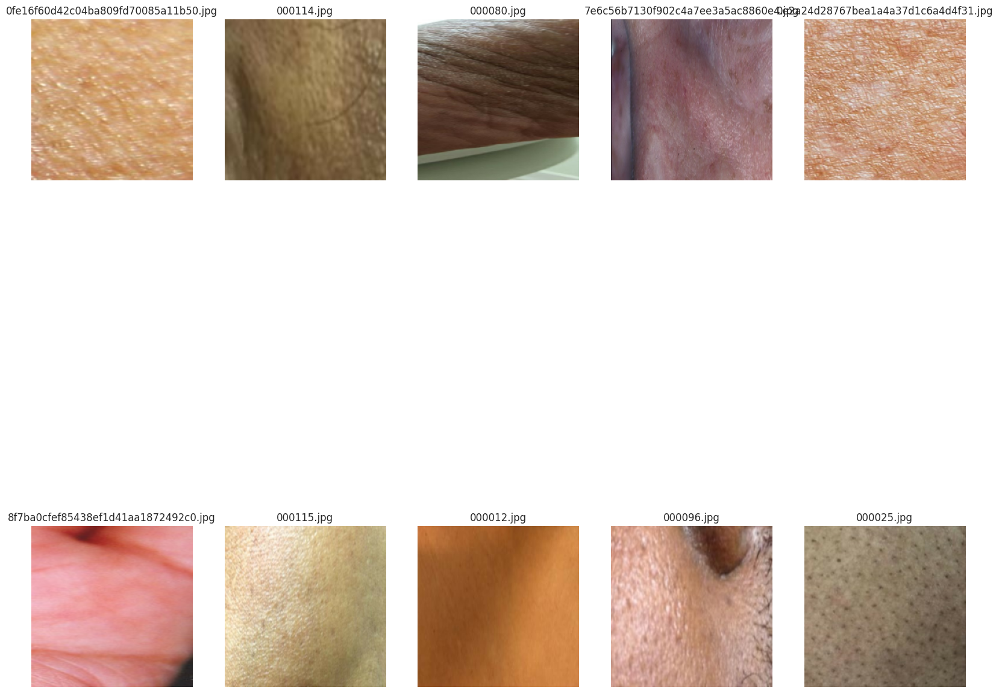

In [ ]:
# Preparar el dataset con el DataFrame actual
dataset_test_combined_ood = prepare_dataset_ood(df_ood_test_combined,
                                        images_path,
                                        file_name_column="filename",
                                        label_column='',
                                        label_map=None,
                                        resize_shape=(224, 224),
                                        normalize=True,
                                        transpose=True,
                                        display_samples=True,
                                        num_display_samples=10,
                                        remove_labels=True,
                                        file_extension=""
                                        )

Creo el dict

In [ ]:
# DS_OUT (OOD):
dataset_test_combined_ood_with_label = dataset_test_combined_ood.map(add_dummy_label)
dataset_test_combined_ood_dict = dataset_test_combined_ood_with_label.map(lambda image, label: convert_to_dict(image, label))

# CARGO MODELO 5 VALQUIRIA

In [ ]:
# CARGAR USANDO TF 2.15 (KERAS 2). COLAB USA KERAS 3 Y NO LEE ESTO ASÍ COMO ESTÁ.
path_iuhi = "/content/drive/MyDrive/Tesis/Valquiria/Valquiria II /WandB/Modelos/model" # Se actualizo a Keras 3 y ya no lee modelos en saved_model. Solo usando TFLayers o algo así pero no es lo mismo creo. USAR KERAS 2 (tf 2.15)
path_yo = "/content/drive/MyDrive/local ood valquiria/modelo5_valquiria.h5"
model = tf.keras.models.load_model(path_iuhi)
modelo5_valquiria = model

# CONFIGS: DS_FIT, DS_IN, DS_OUT y FEATURE MAPS

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        combined_dataset_test_con209_dict: "Combinado test",
    },
    "ds_out_seteado": {
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana",
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST"
    }
}

# Dict con todos los ds_out
"""
"ds_out_seteado": {
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_psoriasis_dict: "OOD Fitz ok: Psoriasis",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_folliculitis_dict: "OOD Fitz ok: Folliculitis",
        dataset_fitz_ood_sarcoidosis_dict: "OOD Fitz ok: Sarcoidosis",
        dataset_fitz_ood_lichen_planus_dict: "OOD Fitz ok: Lichen planus",
        dataset_fitz_ood_lupus_erythematosus_dict: "OOD Fitz ok: Lupus erythematosus",
        dataset_fitz_ood_neutrophilic_dermatoses_dict: "OOD Fitz ok: Neutrophilic dermatoses",
        dataset_fitz_ood_allergic_contact_dermatitis_dict: "OOD Fitz ok: Allergic contact dermatitis",
        dataset_fitz_ood_scabies_dict: "OOD Fitz ok: Scabies",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_acne_dict: "OOD Fitz ok: Acne",
        dataset_fitz_ood_nematode_infection_dict: "OOD Fitz ok: Nematode infection",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        dataset_fitz_ood_photodermatoses_dict: "OOD Fitz ok: Photodermatoses",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST",
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana"
    }
"""

'\n"ds_out_seteado": {\n        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",\n        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",\n        dataset_fitz_ood_psoriasis_dict: "OOD Fitz ok: Psoriasis",\n        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",\n        dataset_fitz_ood_folliculitis_dict: "OOD Fitz ok: Folliculitis",\n        dataset_fitz_ood_sarcoidosis_dict: "OOD Fitz ok: Sarcoidosis",\n        dataset_fitz_ood_lichen_planus_dict: "OOD Fitz ok: Lichen planus",\n        dataset_fitz_ood_lupus_erythematosus_dict: "OOD Fitz ok: Lupus erythematosus",\n        dataset_fitz_ood_neutrophilic_dermatoses_dict: "OOD Fitz ok: Neutrophilic dermatoses",\n        dataset_fitz_ood_allergic_contact_dermatitis_dict: "OOD Fitz ok: Allergic contact dermatitis",\n        dataset_fitz_ood_scabies_dict: "OOD Fitz ok: Scabies",\n        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",\n        dataset_fitz_ood_acne_dict:

**Observación:** *La cantidad de imágenes totales de los OODDatasets (ds_fit, ds_int, ds_out) se ajustan al batch_size sin que haya un resto, habiendo siempre más que en el source dataset. Esto sucede porque usan alguna función del tipo drop_reminder = True al crear los ds que busca que encaje justo con el bs*

 **De todas formas los *scores* dan salidas que coinciden con las Imgs. exactas**

In [ ]:

#config:
ds_fit_seteado = combined_dataset_train_dict
ds_in_seteado = combined_dataset_test_con209_dict
#ds_out_seteado = "mnist"
ds_out_seteado = dataset_test_combined_ood_dict

batch_size_train = 1 # Usé max 128 para el fit. Lo dejo en 1 porque SI ESTA MUY ALTO ME COME VRAM POR MÁS Q NO USE .fit !!

ds_fit = OODDataset( #class ooddataset https://github.dev/deel-ai/oodeel
    ds_fit_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_train, shuffle=True) #.take(2)

batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
batches_in = 24
batches_out = 24

ds_in = OODDataset(
    ds_in_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_test, shuffle = True).take(batches_in)#.take(1) # take(n) hace que "tome" n batches

if not isinstance(ds_out_seteado, str): # si ds_out NO es un string corre esto.
  ds_out = OODDataset(
      ds_out_seteado, load_kwargs={"split":"test"},
      backend="tensorflow").prepare(batch_size_test, shuffle = True).take(batches_out) #.take(12) #384 imgs con bs 32

#MNIST
if isinstance(ds_out_seteado, str): #si ds_out es un string corre esto.
  ds_out = OODDataset(
    ds_out_seteado, load_kwargs={"split":"test"},
    backend="tensorflow").prepare(batch_size_test).take(batches_out)
  ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

ds_fit_dummy = OODDataset(
    combined_dataset_train_dict,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(1).take(1)

# usar info_detallada = True si quiero más info (tarda más en procesar o crashea)
get_dataset_and_ds_stats(ds_fit_seteado, ds_in_seteado, ds_out_seteado, batch_size_train, batch_size_test, ds_fit, ds_in, ds_out)

DS_FIT Comb:
--------------------------------------
SOURCE DATSAET INFO:
Imgs exactas: 5865
--------------------------------------
OODDataset INFO:
batch_size: 1
batches: 5865
________________________________________

Combinado test:
--------------------------------------
SOURCE DATSAET INFO:
Imgs exactas: 766
--------------------------------------
OODDataset INFO:
batch_size: 32
batches: 24
________________________________________

OOD Test combined: piel sana:
--------------------------------------
SOURCE DATSAET INFO:
Imgs exactas: 445
--------------------------------------
OODDataset INFO:
batch_size: 32
batches: 14
________________________________________



### Plots feature map

#### Individual:

Usando la config de la celda de arriba puedo plotear con estas funciones:

In [ ]:
#plot_2D_features()
#plot_3D_features()
plotly_3D_features(model,
                 in_dataset= ds_in,
                 output_layer_id = -2,
                 out_dataset=ds_out,
                 proj_method='TSNE',
                 title= "t-sne")

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


O puedo usar la función custom que cree y pasarlo todo directamente. Te da info de lo seleccionado y el title con los ds usados

In [ ]:
plot_2D_features_custom_2( #uso el _2 porque los otros dicts de los ood sets no están definidos en este caso y al comparar tira error.
    model=model,
    ds_in_seteado=combined_dataset_test_con209_dict,  # Ajusta según sea necesario
    ds_out_seteado=dataset_fitz_ood_dict_ok,  # Clave actual del ds_out
    batch_size_test=64,
    batches_in=12,
    batches_out=12,
    output_layer_id=-2,
    proj_method="TSNE"
)

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


#### Grupal: loopeado por lista de los ds_out:

Probé con outout_layer_id: -2, -5, -7. El que usé en los métodos OOD es el -2 porque tiene un nro de dimensiones menor = menor costo computacional

Procesando ds_out_seteado: OOD Test combined: piel sana
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


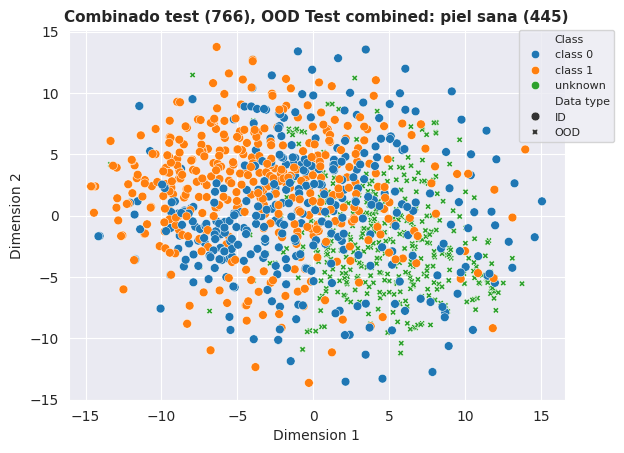

Procesando ds_out_seteado: OOD Fitz: ok
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


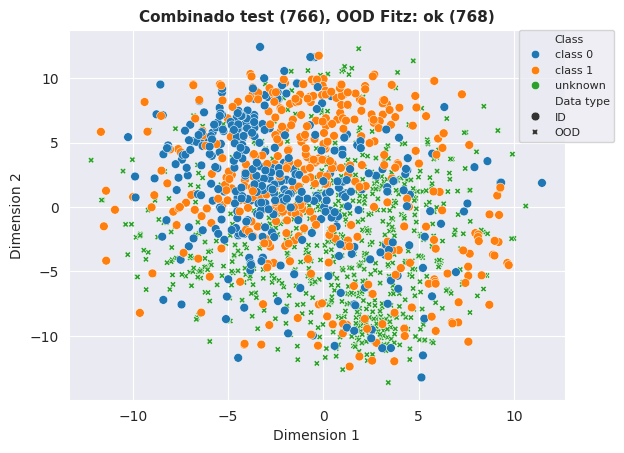

Procesando ds_out_seteado: OOD Fitz: Ambos filtros
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


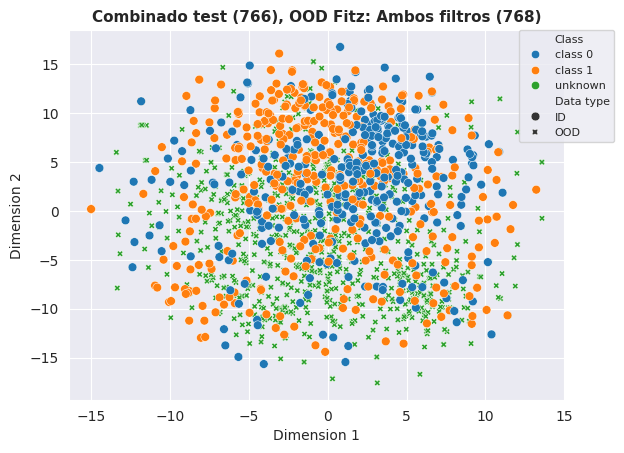

Procesando ds_out_seteado: OOD Fitz ok: Acne vulgaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


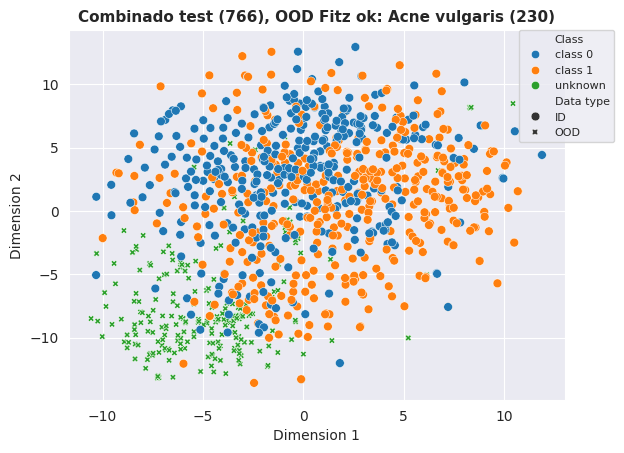

Procesando ds_out_seteado: OOD Fitz ok: Pityriasis rubra pilaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


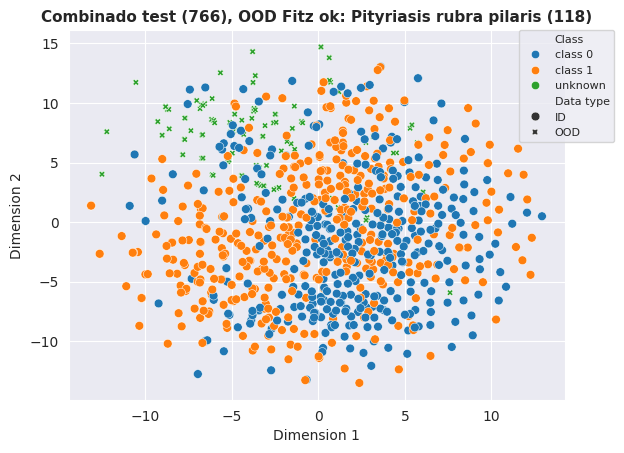

Procesando ds_out_seteado: OOD Fitz ok: Hailey-Hailey disease
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


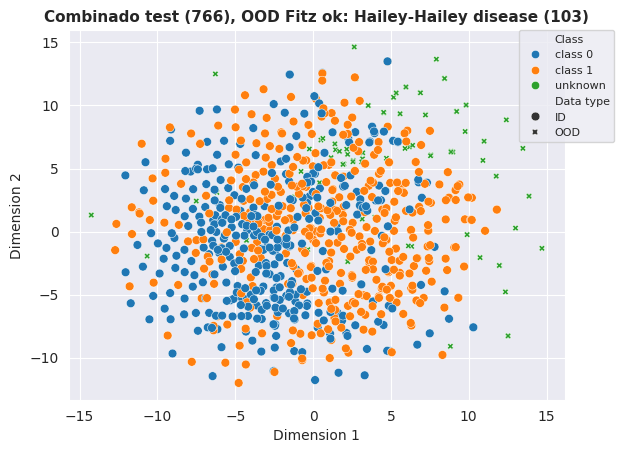

Procesando ds_out_seteado: Fashion MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


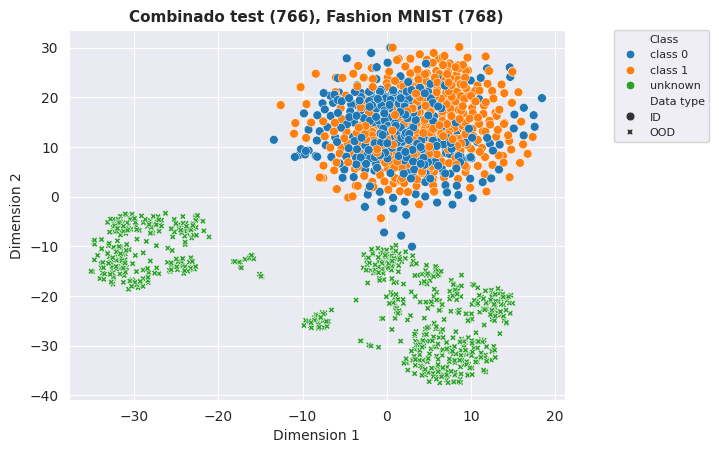

Procesando ds_out_seteado: MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


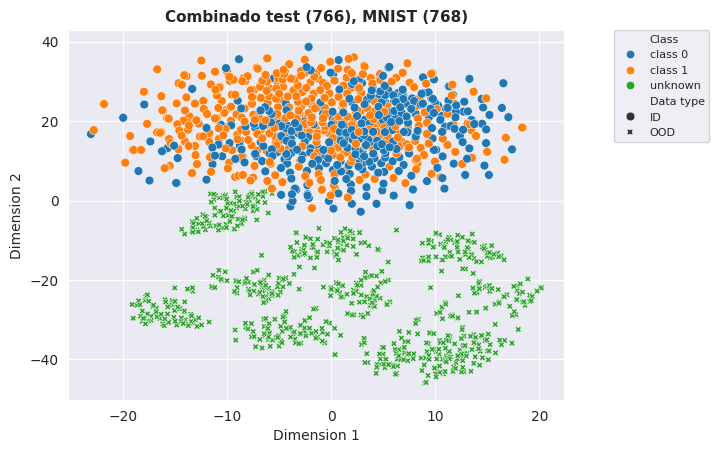

In [ ]:
# Iterar sobre todos los valores de ds_out_seteado
for ds_out_key, ds_out_value in dataset_sources["ds_out_seteado"].items():
    print(f"Procesando ds_out_seteado: {ds_out_value}")
    plot_2D_features_custom(
        model=model,
        ds_in_seteado=combined_dataset_test_con209_dict,  # Ajusta según sea necesario
        ds_out_seteado=ds_out_key,  # Clave actual del ds_out
        batch_size_test=96,
        batches_in=8,
        batches_out=8,
        output_layer_id= -2, #-5 , -7
        proj_method="TSNE"
    )

#MÉTODOS

https://github.dev/deel-ai/oodeel

https://deel-ai.github.io/oodeel/api/methods/

https://deel-ai.github.io/oodeel/notebooks/tensorflow/demo_dknn_tf/

### Paths y ds_fit_dummy

In [ ]:
METODOS_OOD_PATH= "/content/drive/MyDrive/Tesis/Metodos OOD"

# fit_dataset
MAHALANOBIS_PATH = METODOS_OOD_PATH + "/Mahalanobis"
MAHALANOBIS_SCORES_PATH = MAHALANOBIS_PATH + "/scores"
MAHALANOBIS_PLOTS_OUTPUT_PATH = MAHALANOBIS_PATH + "/plots"

DKNN_PATH = METODOS_OOD_PATH + "/DKNN"
DKNN_PLOTS_OUTPUT_PATH = DKNN_PATH + "/plots"


# sin fit_dataset
MLS_PATH = METODOS_OOD_PATH + "/MLS"
MLS_PLOTS_OUTPUT_PATH = MLS_PATH + "/plots"


ODIN_PATH = METODOS_OOD_PATH + "/ODIN"
ODIN_PLOTS_OUTPUT_PATH = ODIN_PATH + "/plots"

ENERGY_PATH = METODOS_OOD_PATH + "/Energy"
ENERGY_PLOTS_OUTPUT_PATH = ENERGY_PATH + "/plots"


In [ ]:
ds_fit_dummy = OODDataset(
    combined_dataset_train_dict,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(1).take(1)

## DKNN

In [ ]:
metodo = "DKNN"

In [ ]:
from oodeel.methods import DKNN
dknn = DKNN(nearest=50)

#config:
ds_fit_seteado = combined_dataset_train_dict

batch_size_train = 128 # Usé max 128 para el fit. Lo dejo en 1 porque SI ESTA MUY ALTO ME COME VRAM POR MÁS Q NO USE .fit !!

ds_fit = OODDataset( #class ooddataset https://github.dev/deel-ai/oodeel
    ds_fit_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_train, shuffle=False) #.take(2) #5865 imgs. uso todas, por eso no necesito shuffle

dknn.fit(model, feature_layers_id=[-2], fit_dataset=ds_fit)

In [ ]:
DKNN_PATH = METODOS_OOD_PATH + "/DKNN"
with open(DKNN_PATH + "/dknn_train_full.pkl", "wb") as f:
            pickle.dump(dknn, f)
print(f"Parámetros guardados en {DKNN_PATH}/dknn_train_full.pkl")

Parámetros guardados en /content/drive/MyDrive/Tesis/Metodos OOD/DKNN/dknn_train_full.pkl


In [ ]:
ds_in_seteado = combined_dataset_test_con209_dict

batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
batches_in = 24

ds_in = OODDataset(
    ds_in_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_test, shuffle = False).take(batches_in)#.take(1) # take(n) hace que "tome" n batches #uso todas, por eso no necesito shuffle

scores_in, _ = dknn.score(ds_in)

### Itero para obtener plots

Procesando ds_out_seteado: OOD Test combined: piel sana
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


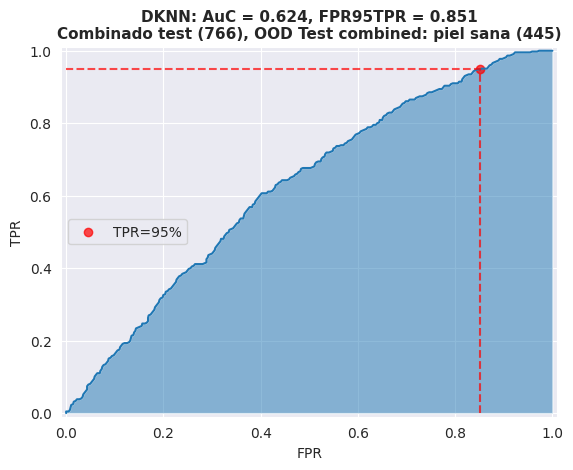

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


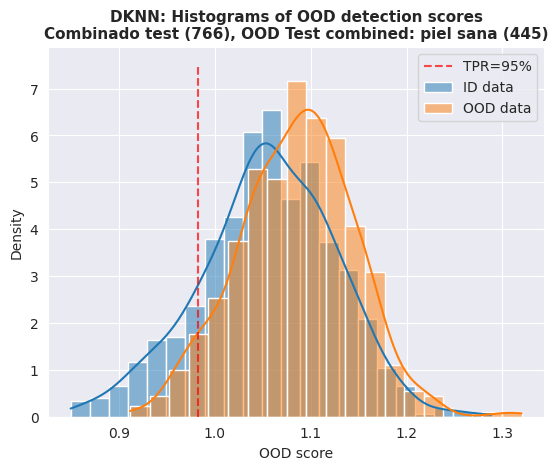

Procesando ds_out_seteado: OOD Fitz: ok
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


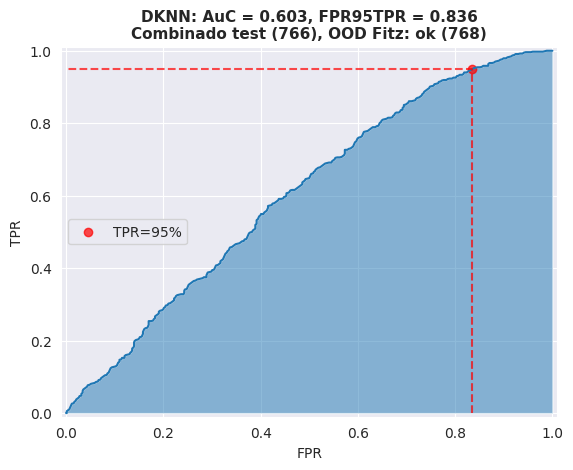

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


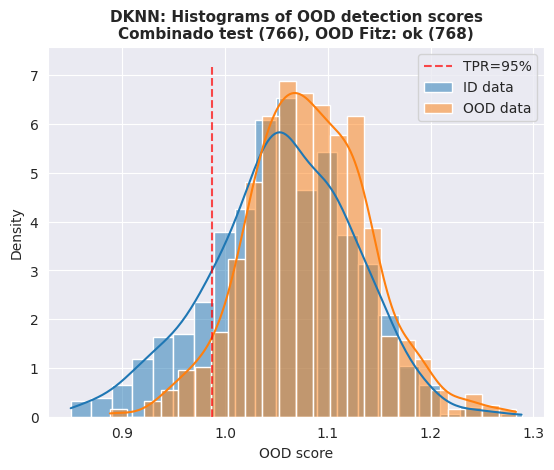

Procesando ds_out_seteado: OOD Fitz: Ambos filtros


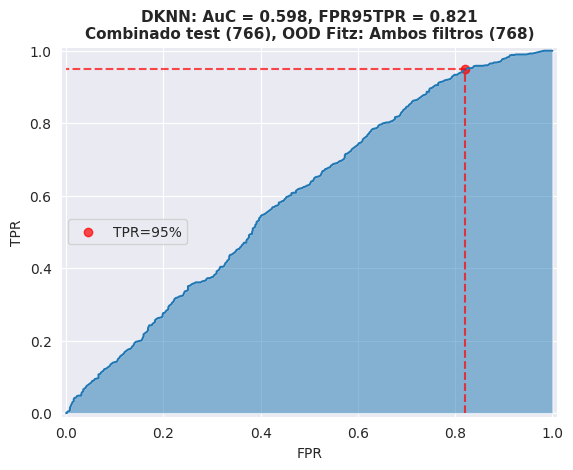

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


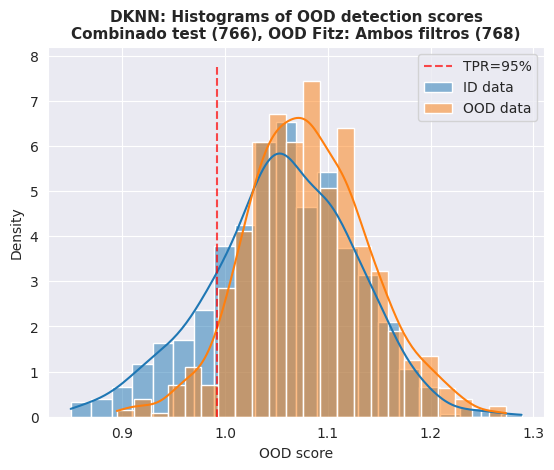

Procesando ds_out_seteado: OOD Fitz ok: Acne vulgaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


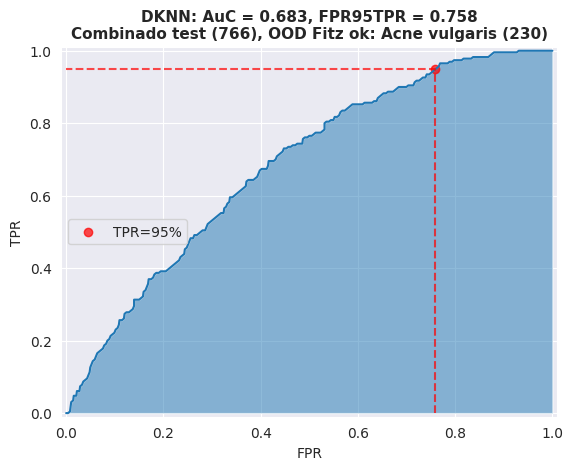

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


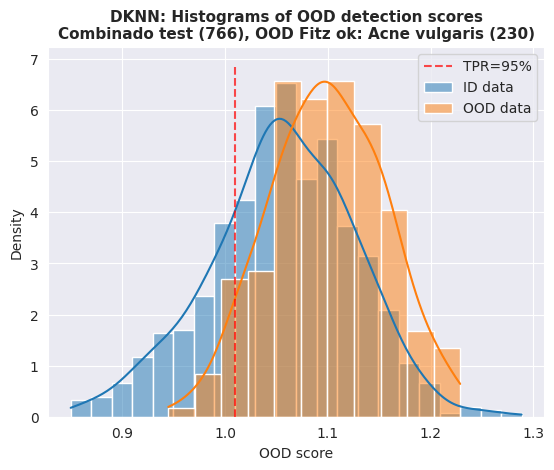

Procesando ds_out_seteado: OOD Fitz ok: Pityriasis rubra pilaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


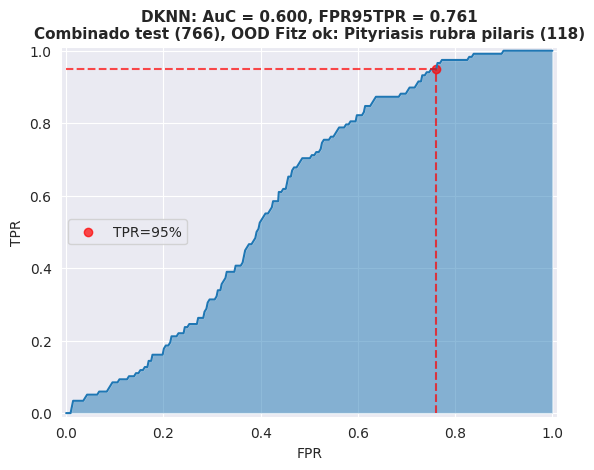

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


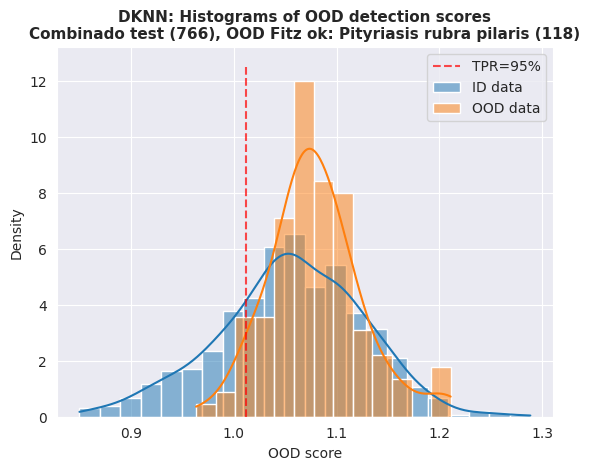

Procesando ds_out_seteado: OOD Fitz ok: Hailey-Hailey disease
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


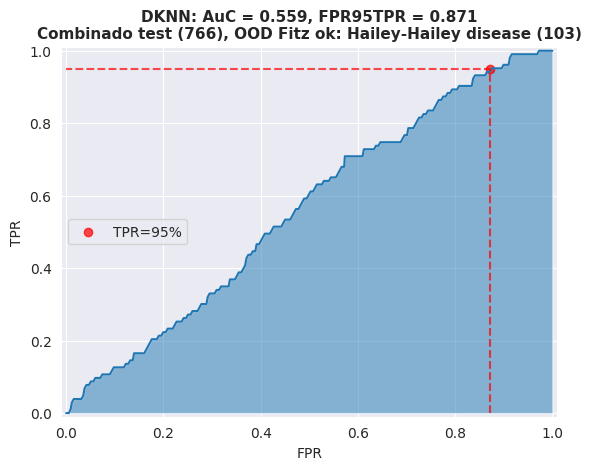

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


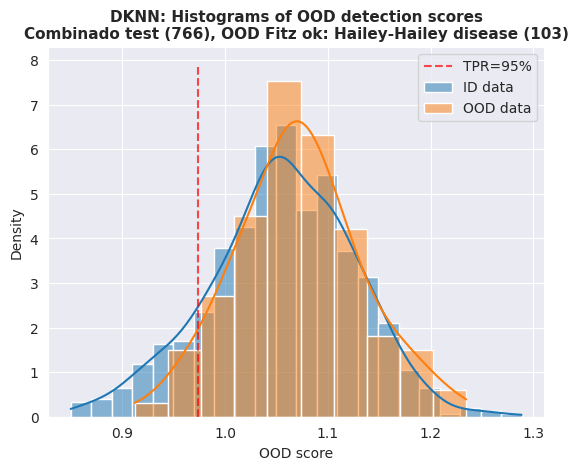

Procesando ds_out_seteado: Fashion MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


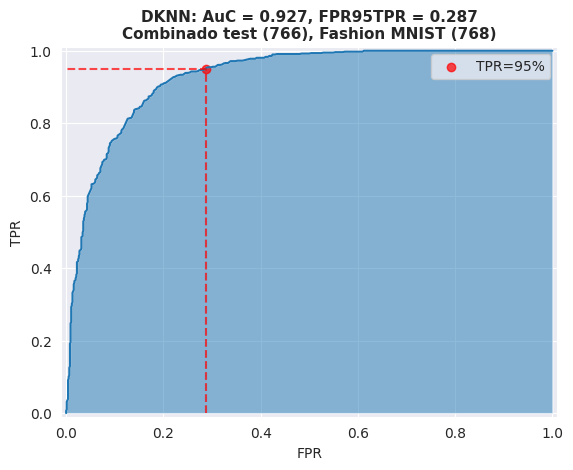

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


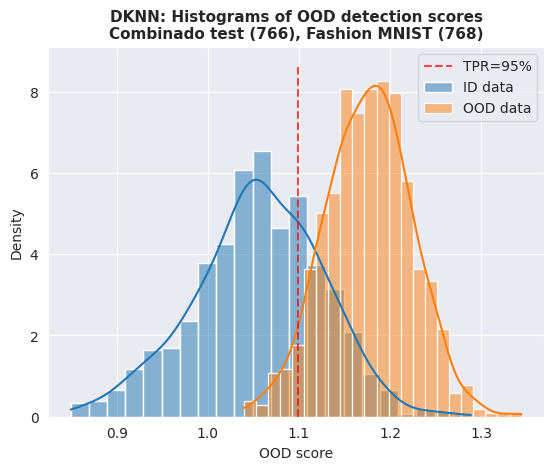

Procesando ds_out_seteado: MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


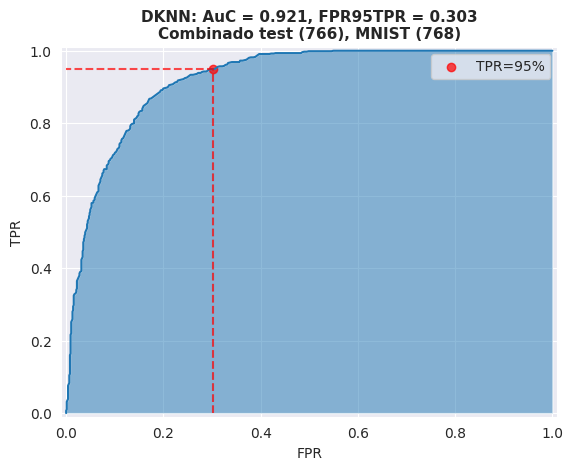

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


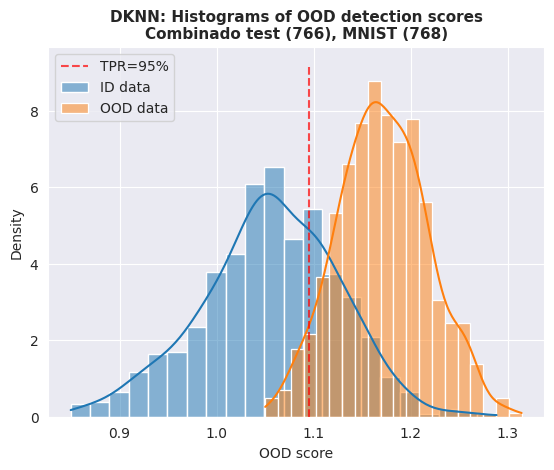

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        combined_dataset_test_con209_dict: "Combinado test",
    },
    "ds_out_seteado": {
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana",
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST"
    }
}

# Iterar sobre todos los valores de ds_out_seteado
for ds_out_key, ds_out_value in dataset_sources["ds_out_seteado"].items():
    print(f"Procesando ds_out_seteado: {ds_out_value}")

    ds_out_seteado = ds_out_key
    ds_in_seteado = combined_dataset_test_con209_dict

    batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
    batches_in = 24
    batches_out = 24

    if not isinstance(ds_out_seteado, str): # si ds_out NO es un string corre esto.
      ds_out = OODDataset(
          ds_out_seteado, load_kwargs={"split":"test"},
          backend="tensorflow").prepare(batch_size_test, shuffle = True).take(batches_out) #.take(12) #384 imgs con bs 32

    #MNIST
    if isinstance(ds_out_seteado, str): #si ds_out es un string corre esto.
      ds_out = OODDataset(
        ds_out_seteado, load_kwargs={"split":"test"},
        backend="tensorflow").prepare(batch_size_test).take(batches_out)
      ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    scores_out, _ = dknn.score(ds_out)
    score_plots_custom(metodo, scores_in, scores_out, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_path = DKNN_PLOTS_OUTPUT_PATH)

## Mahalanobis

In [ ]:
metodo = "Mahalanobis" #esto es para el title de los plots

 ### Mahalanobis_guardable:

In [ ]:
class Mahalanobis_guardable(Mahalanobis):
    def save_params(self, file_path: str) -> None:
        """
        Guarda los parámetros calculados durante el ajuste en un archivo.

        Args:
            file_path (str): Ruta donde se guardarán los parámetros.
        """
        params = {
            "mus": self._mus,
            "pinv_cov": self._pinv_cov,
            "classes": self._classes,
        }
        with open(file_path, "wb") as f:
            pickle.dump(params, f)
        print(f"Parámetros guardados en {file_path}")

    def load_params(self, file_path: str) -> None:
        """
        Carga los parámetros desde un archivo.

        Args:
            file_path (str): Ruta desde donde se cargarán los parámetros.
        """
        with open(file_path, "rb") as f:
            params = pickle.load(f)
        self._mus = params["mus"]
        self._pinv_cov = params["pinv_cov"]
        self._classes = params["classes"]
        print(f"Parámetros cargados desde {file_path}")

    @property
    def requires_to_fit_dataset(self) -> bool:
        """
        Sobrescribe el método para permitir usar la clase sin ajustar si se cargan
        parámetros previamente.
        """
        return not hasattr(self, "_mus") or not hasattr(self, "_pinv_cov")

In [ ]:
#mahalanobis_guardable.save_params("mahalanobis_train_full_-7.pkl")

### Mahalanobis cargado con load

In [ ]:
# Ajustar y guardar
mahalanobis_cargado_conparams = Mahalanobis_guardable(eps=0.002)
mahalanobis_cargado_conparams.fit(model=model, fit_dataset=ds_fit_dummy, feature_layers_id=[-2])
#mahalanobis_cargado_conparams.load_params("mahalanobis_train_full.pkl")
mahalanobis_cargado_conparams.load_params(MAHALANOBIS_PATH + "/mahalanobis_train_full.pkl")

Parámetros cargados desde /content/drive/MyDrive/Tesis/Metodos OOD/Mahalanobis/mahalanobis_train_full.pkl


### scores: calculo y guardo

In [ ]:
# VERIFICAR ESTAR USANDO BS=64 SI NO PUEDE TIRAR ERROR OOM.
scores_in, _ = mahalanobis_cargado_conparams.score(ds_in)

In [ ]:

# Guardamos el resultado en un archivo
with open(MAHALANOBIS_SCORES_PATH + '/scores_in_mahalanobis.pkl', 'wb') as archivo:
    pickle.dump(scores_in, archivo)

print("Resultado guardado exitosamente.")


Resultado guardado exitosamente.


In [ ]:
scores_out, _ = mahalanobis_cargado_conparams.score(ds_out)

In [ ]:
# Guardamos el resultado en un archivo
with open(MAHALANOBIS_SCORES_PATH +'/scores_out_mahalanobis_mnist.pkl', 'wb') as archivo:
    pickle.dump(scores_out, archivo)

print("Resultado guardado exitosamente.")

Resultado guardado exitosamente.


### scores: cargo guardados

In [ ]:
# Cargar los puntajes desde el archivo
with open(MAHALANOBIS_SCORES_PATH+'/scores_in_mahalanobis.pkl', 'rb') as archivo:
    scores_in = pickle.load(archivo)

with open(MAHALANOBIS_SCORES_PATH+'/scores_out_mahalanobis_fitz_ok.pkl', 'rb') as archivo:
    scores_out = pickle.load(archivo)

print("scores in y out cargados exitosamente.")




scores in y out cargados exitosamente.


### metricas y plots

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


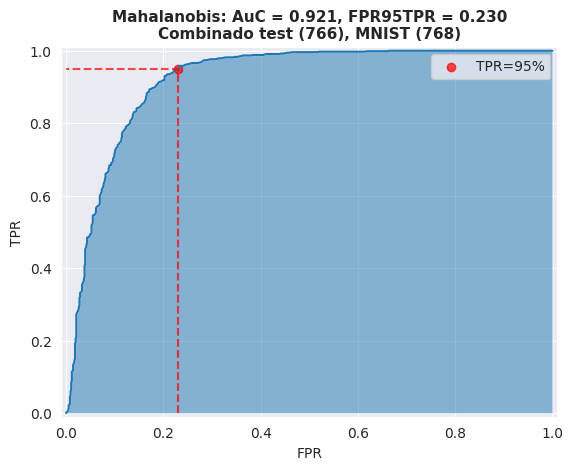

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


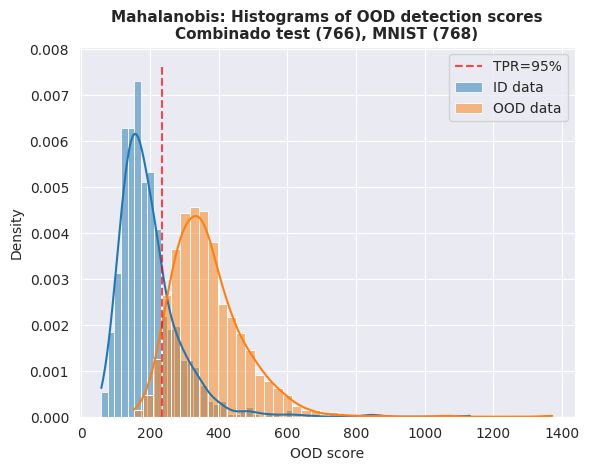

In [ ]:
score_plots_custom(metodo, scores_in, scores_out, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_path = MAHALANOBIS_PLOTS_OUTPUT_PATH)

### ds_in

In [ ]:
ds_in_seteado = combined_dataset_test_con209_dict

batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
batches_in = 24

ds_in = OODDataset(
    ds_in_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_test, shuffle = False).take(batches_in)#.take(1) # take(n) hace que "tome" n batches #uso todas, por eso no necesito shuffle

scores_in, _ = mahalanobis_cargado_conparams.score(ds_in)

### Itero para obtener plots

Procesando ds_out_seteado: OOD Test combined: piel sana
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


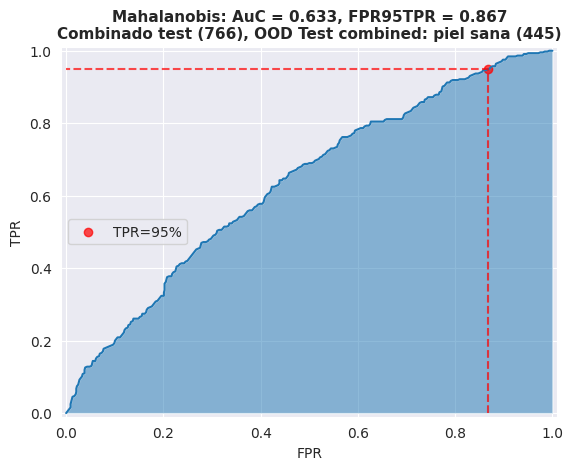

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


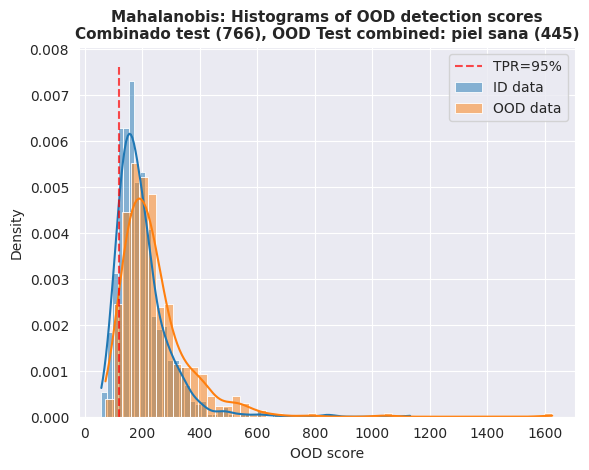

Procesando ds_out_seteado: OOD Fitz: ok
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


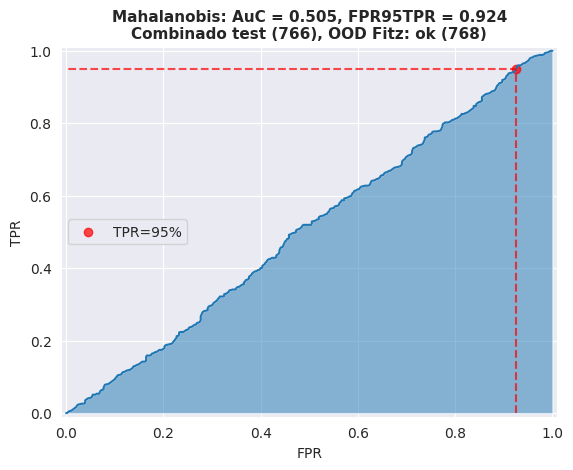

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


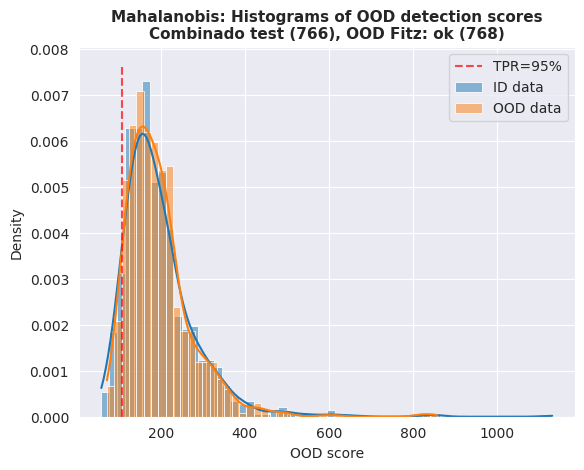

Procesando ds_out_seteado: OOD Fitz: Ambos filtros
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


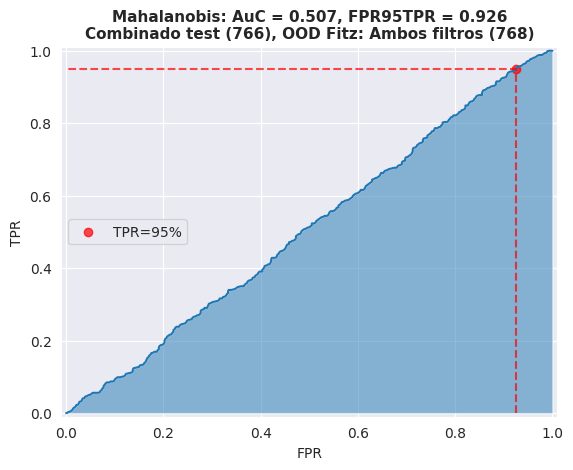

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


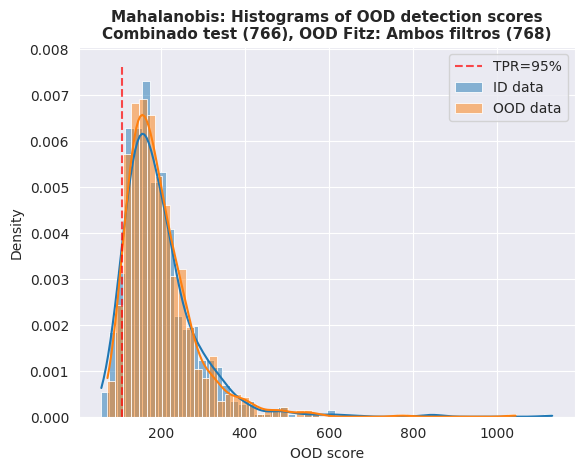

Procesando ds_out_seteado: OOD Fitz ok: Acne vulgaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


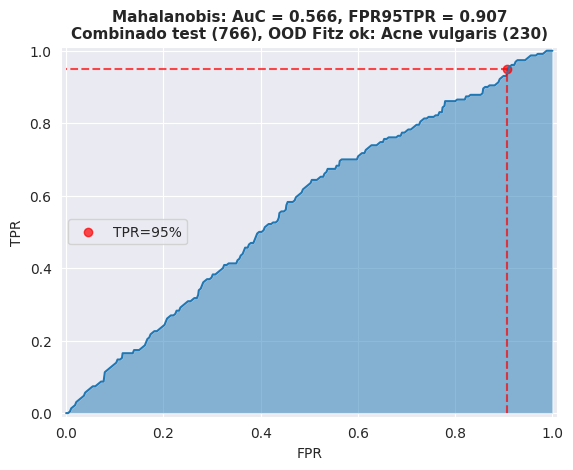

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


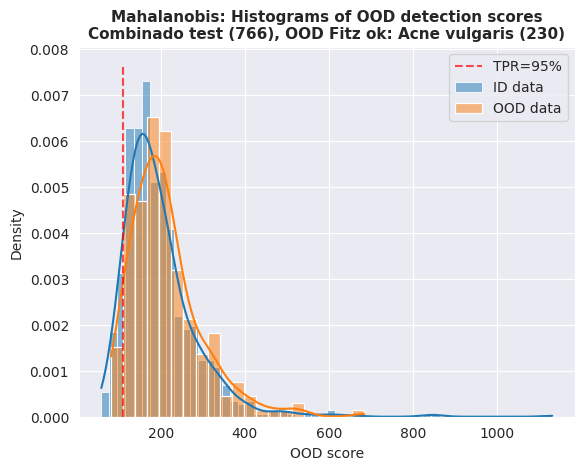

Procesando ds_out_seteado: OOD Fitz ok: Pityriasis rubra pilaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


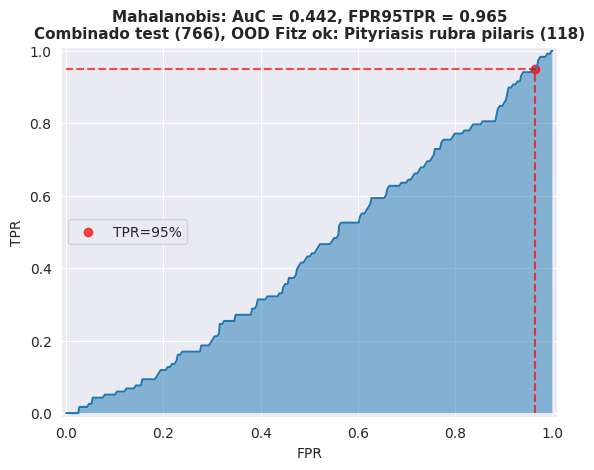

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


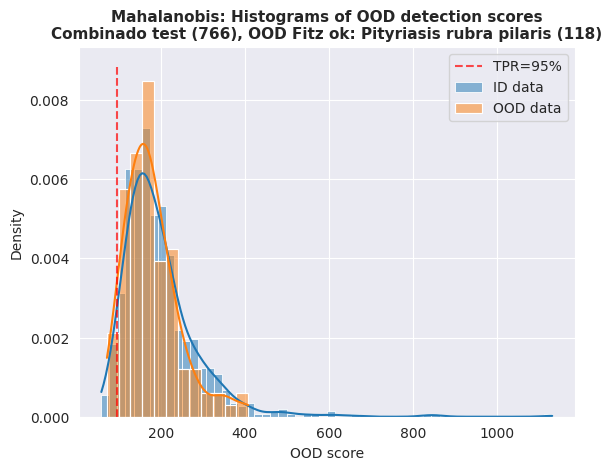

Procesando ds_out_seteado: OOD Fitz ok: Hailey-Hailey disease
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


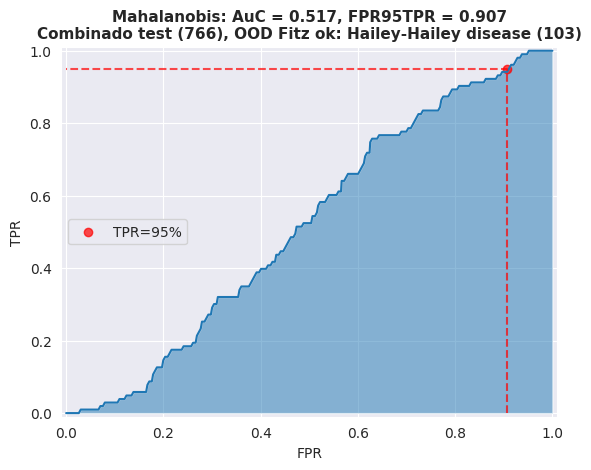

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


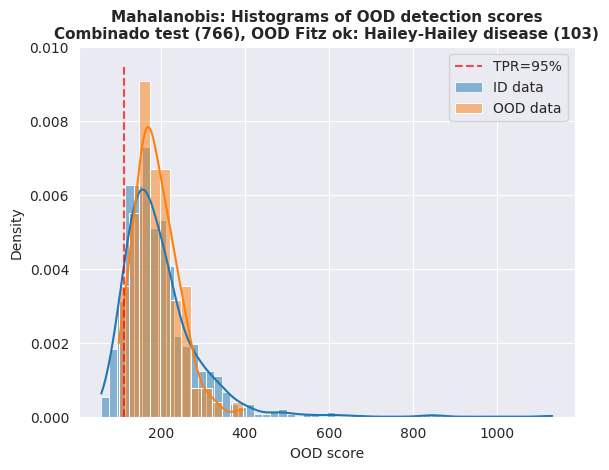

Procesando ds_out_seteado: Fashion MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


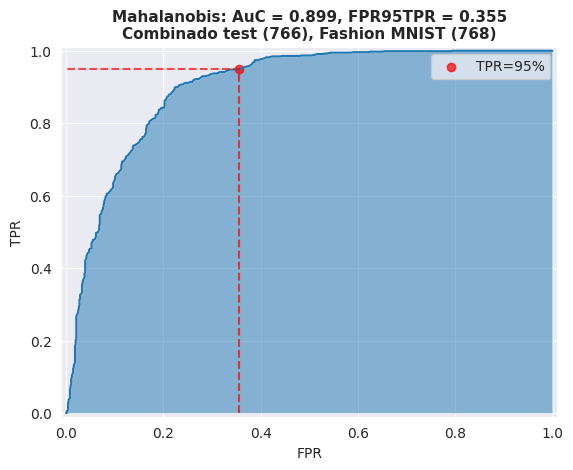

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


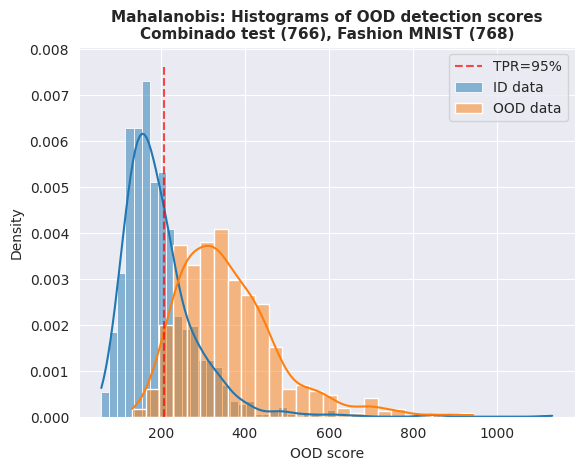

Procesando ds_out_seteado: MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


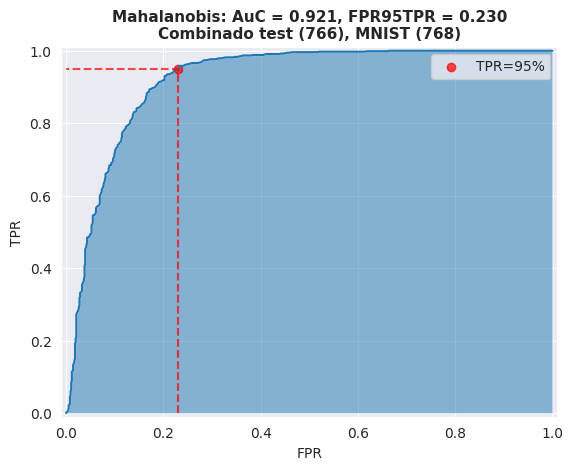

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


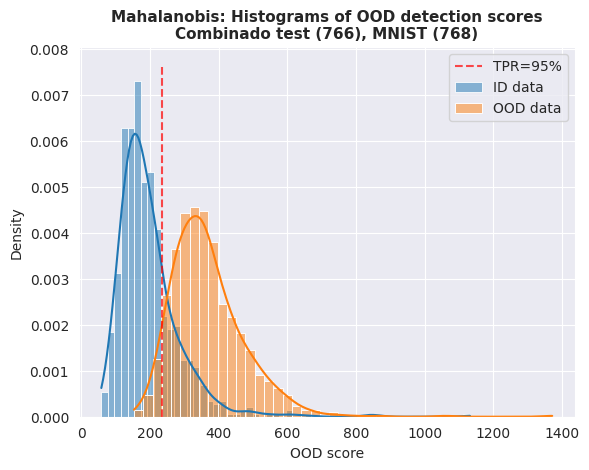

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        combined_dataset_test_con209_dict: "Combinado test",
    },
    "ds_out_seteado": {
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana",
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST"
    }
}

# Iterar sobre todos los valores de ds_out_seteado
for ds_out_key, ds_out_value in dataset_sources["ds_out_seteado"].items():
    print(f"Procesando ds_out_seteado: {ds_out_value}")

    ds_out_seteado = ds_out_key
    ds_in_seteado = combined_dataset_test_con209_dict

    batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
    batches_in = 24
    batches_out = 24

    if not isinstance(ds_out_seteado, str): # si ds_out NO es un string corre esto.
      ds_out = OODDataset(
          ds_out_seteado, load_kwargs={"split":"test"},
          backend="tensorflow").prepare(batch_size_test, shuffle = True).take(batches_out) #.take(12) #384 imgs con bs 32

    #MNIST
    if isinstance(ds_out_seteado, str): #si ds_out es un string corre esto.
      ds_out = OODDataset(
        ds_out_seteado, load_kwargs={"split":"test"},
        backend="tensorflow").prepare(batch_size_test).take(batches_out)
      ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    scores_out, _ = mahalanobis_cargado_conparams.score(ds_out)
    score_plots_custom(metodo, scores_in, scores_out, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_path = MAHALANOBIS_PLOTS_OUTPUT_PATH)

## MLS

In [ ]:
metodo = "MLS"

In [ ]:
from oodeel.methods import MLS
mls = MLS()
mls.fit(modelo5_valquiria)

In [ ]:
scores_in, _ = mls.score(ds_in)

### Itero para obtener plots

Procesando ds_out_seteado: OOD Test combined: piel sana
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


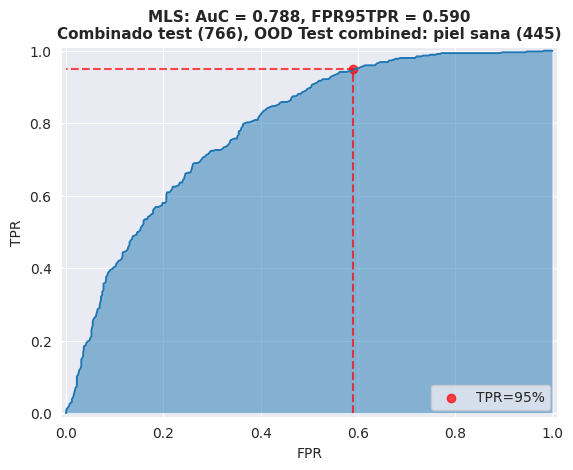

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


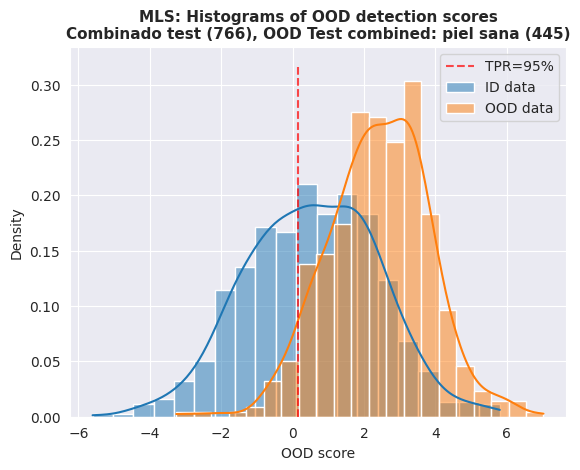

Procesando ds_out_seteado: OOD Fitz: ok
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


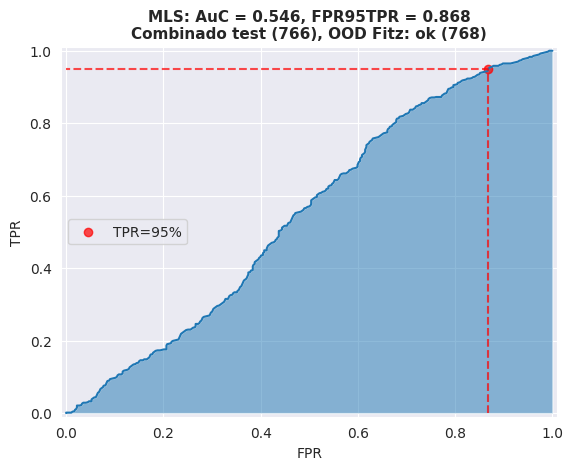

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


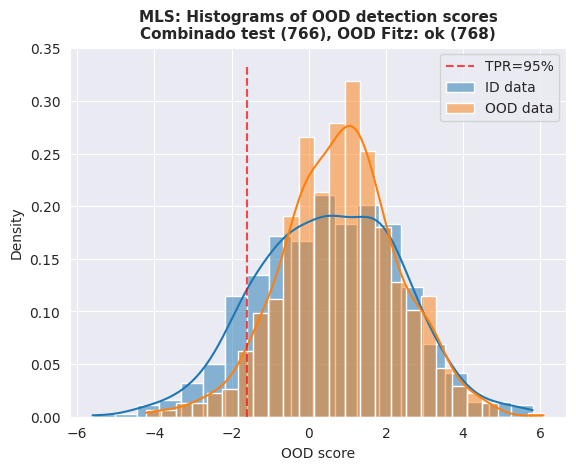

Procesando ds_out_seteado: OOD Fitz: Ambos filtros
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


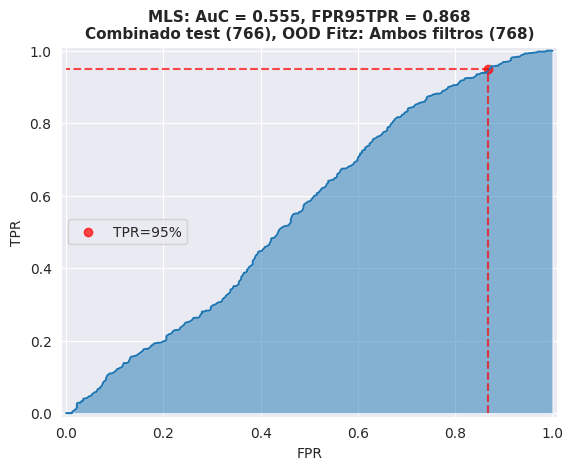

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


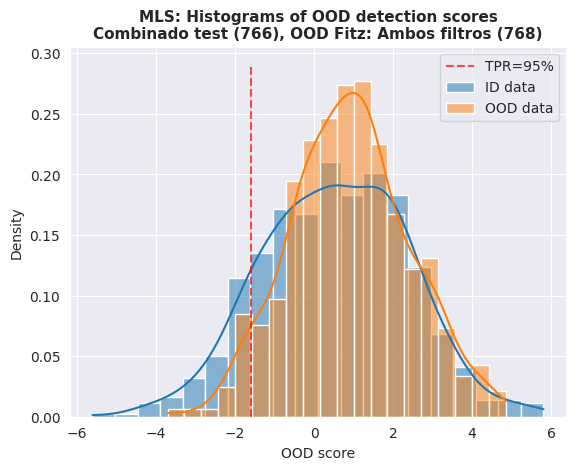

Procesando ds_out_seteado: OOD Fitz ok: Acne vulgaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


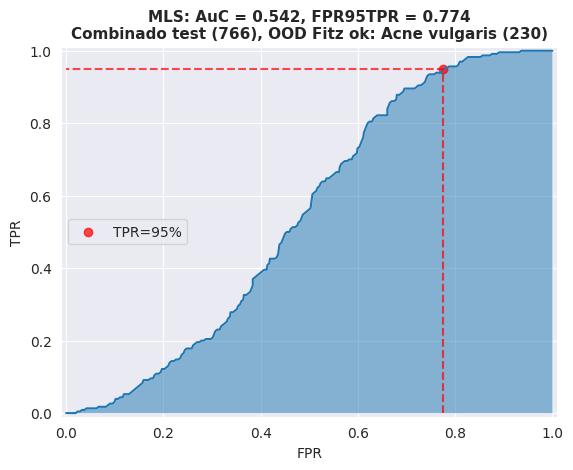

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


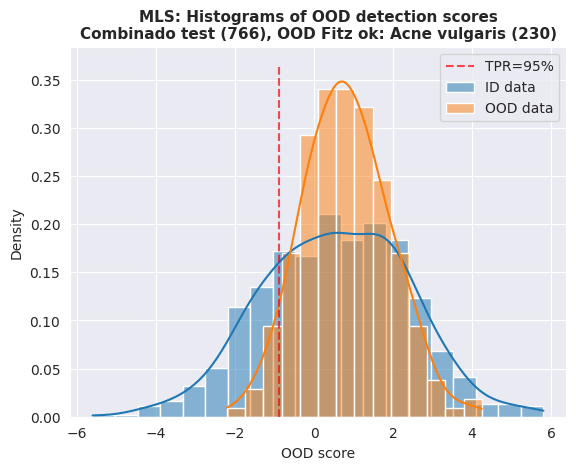

Procesando ds_out_seteado: OOD Fitz ok: Pityriasis rubra pilaris
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


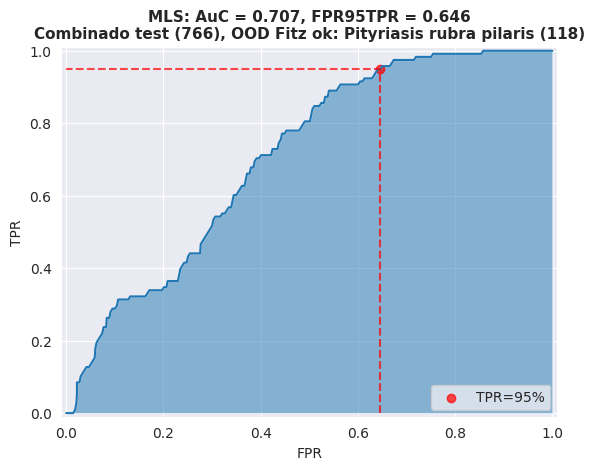

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


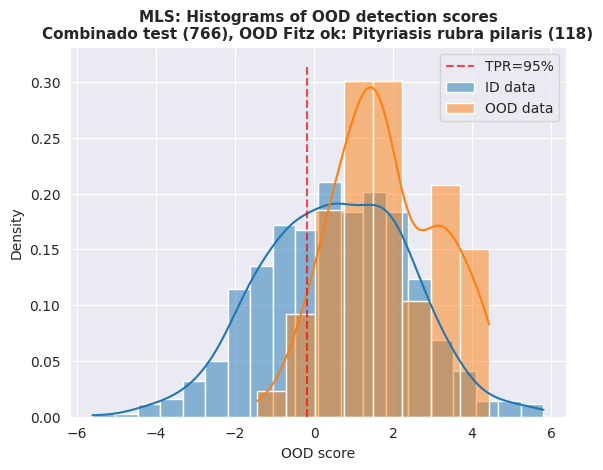

Procesando ds_out_seteado: OOD Fitz ok: Hailey-Hailey disease
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


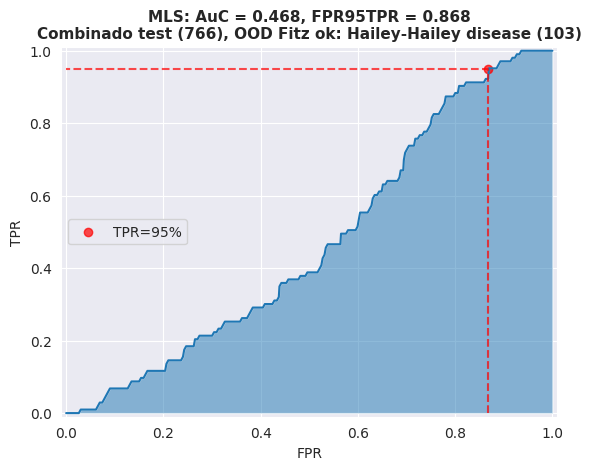

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


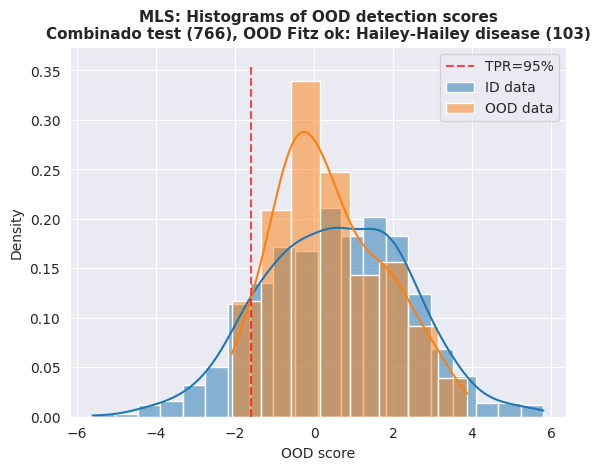

Procesando ds_out_seteado: Fashion MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


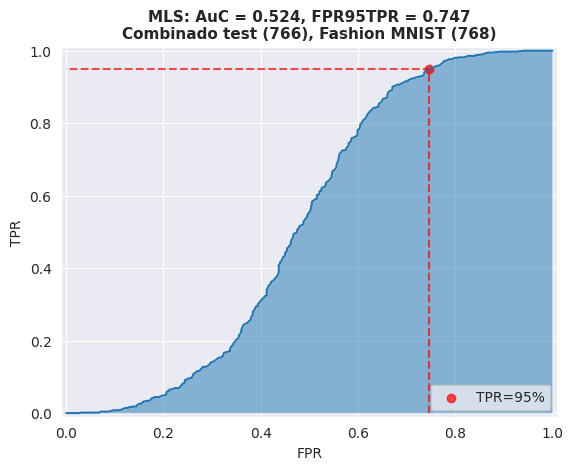

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


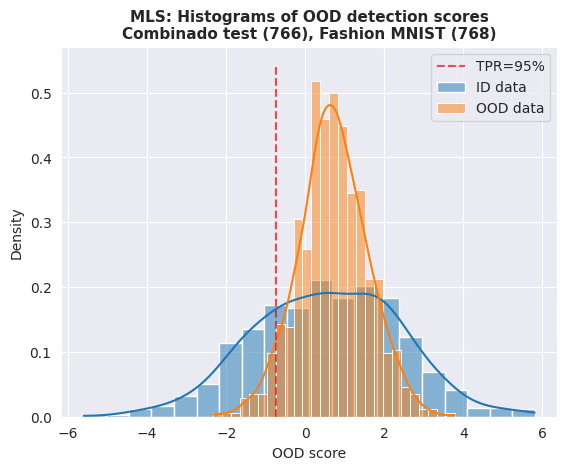

Procesando ds_out_seteado: MNIST
Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


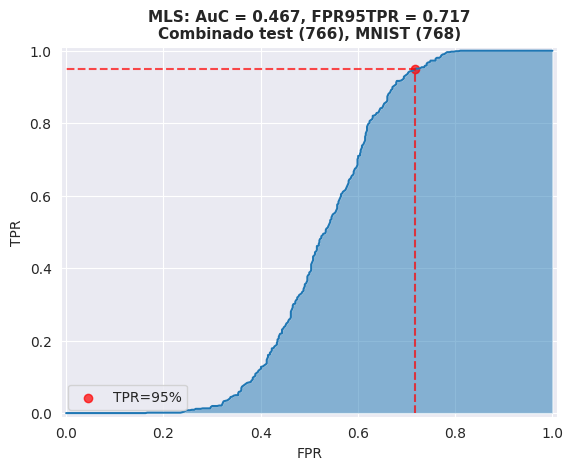

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


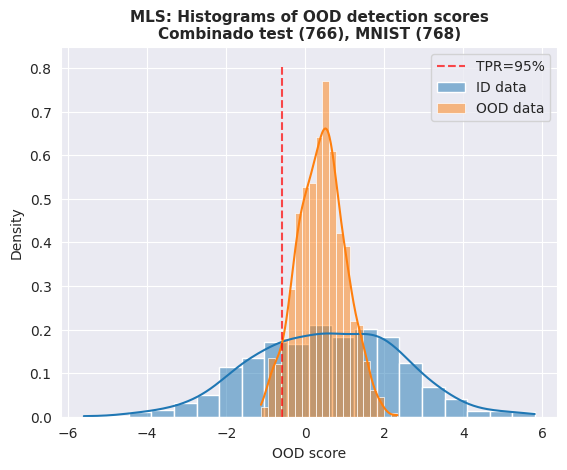

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        combined_dataset_test_con209_dict: "Combinado test",
    },
    "ds_out_seteado": {
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana",
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST"
    }
}

# Iterar sobre todos los valores de ds_out_seteado
for ds_out_key, ds_out_value in dataset_sources["ds_out_seteado"].items():
    print(f"Procesando ds_out_seteado: {ds_out_value}")

    ds_out_seteado = ds_out_key
    ds_in_seteado = combined_dataset_test_con209_dict

    batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
    batches_in = 24
    batches_out = 24

    if not isinstance(ds_out_seteado, str): # si ds_out NO es un string corre esto.
      ds_out = OODDataset(
          ds_out_seteado, load_kwargs={"split":"test"},
          backend="tensorflow").prepare(batch_size_test, shuffle = True).take(batches_out) #.take(12) #384 imgs con bs 32

    #MNIST
    if isinstance(ds_out_seteado, str): #si ds_out es un string corre esto.
      ds_out = OODDataset(
        ds_out_seteado, load_kwargs={"split":"test"},
        backend="tensorflow").prepare(batch_size_test).take(batches_out)
      ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    scores_out, _ = mls.score(ds_out)
    score_plots_custom(metodo, scores_in, scores_out, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_path = MLS_PLOTS_OUTPUT_PATH)

## ODIN

In [ ]:
metodo = "ODIN"

### Monkey Patching: Cambio score_tensor() xq asume output con multiples clases al usar softmax en lugar de sigmoid sobre mis logits

In [ ]:
from oodeel.methods import ODIN

"""
# Modificar `_temperature_loss` para convertir logits a 2 clases
def custom_temperature_loss(self, inputs, labels):
    preds = self.feature_extractor.model(inputs) / self.temperature
    #print(f"Preds shape (after temperature scaling): {preds.shape}")
    #print(f"Labels shape: {labels.shape}")

    # Convertir logits de (batch_size, 1) a (batch_size, 2)
    preds = tf.concat([preds, -preds], axis=1)
    #print(f"Converted preds shape: {preds.shape}")

    loss = self.op.CrossEntropyLoss(reduction="sum")(inputs=preds, targets=labels)
    #print(f"Computed loss: {loss}")
    return loss
"""
# Sobrescribir `input_perturbation` para depurar las formas de los tensores
def custom_input_perturbation(self, inputs):
    preds = self.feature_extractor.model(inputs)
    print(f"Logits (raw model output) shape: {preds.shape}")
    outputs = self.op.argmax(preds, dim=1)
    print(f"Outputs after argmax shape: {outputs.shape}")
    gradients = self.op.gradient(self._temperature_loss, inputs, outputs)
    print(f"Gradients shape: {gradients.shape}")
    inputs_p = inputs - self.noise * self.op.sign(gradients)
    print(f"Perturbed inputs shape: {inputs_p.shape}")
    return inputs_p


def custom_score_tensor(self, inputs):
    if self.feature_extractor.backend == "torch":
        inputs = inputs.to(self.feature_extractor._device)

    x = self.input_perturbation(inputs)
    _, logits = self.feature_extractor.predict_tensor(x)
    print(f"Logits shape (after perturbation): {logits.shape}")
    print(f"Logits: {logits.numpy()}")

    # Aplicar Sigmoid para obtener probabilidades
    probits = tf.sigmoid(logits)
    print(f"Probits shape (sigmoid output): {probits.shape}")
    print(f"Probits: {probits.numpy()}")

    probits = self.op.convert_to_numpy(probits)
    scores = -probits.flatten()  # Usar el negativo para alinearse con la métrica
    print(f"OOD scores shape: {scores.shape}")
    print(f"OOD scores: {scores}")
    return scores


# Reemplazar los métodos en la clase ODIN
ODIN.input_perturbation = custom_input_perturbation
#ODIN._temperature_loss = custom_temperature_loss DEJAR COMENTADO PORQUE AL FINAL CAMBIE EL SCORE TENSOR PARA SIGMOID PARA MI MODELO A BINARY EN LUGAR DEL TEMPERATURE LOSS PARA COVNERTIR A MULTICLASS
ODIN._score_tensor = custom_score_tensor


### instancio odin

In [ ]:
from oodeel.methods import ODIN

# === ODIN scores ===
odin = ODIN(temperature=1000)
odin.fit(model)

In [ ]:
"""
ds_in_seteado_procesado = combined_dataset_test_con209_dict.map(
    lambda x: {"input_0": x["input_0"], "label": tf.expand_dims(x["label"], axis=0)}
)
"""
batch_size_test = 32#32
batches_in = 24#24

ds_in_seteado = combined_dataset_test_con209_dict

ds_in = OODDataset(
    ds_in_seteado,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size_test, shuffle = False).take(batches_in)

scores_in, _ = odin.score(ds_in)


Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-1.3597784 ]
 [ 0.6636509 ]
 [ 2.105398  ]
 [ 0.13277073]
 [-1.2343305 ]
 [-0.9818775 ]
 [-0.996059  ]
 [-2.7079263 ]
 [-2.1223574 ]
 [-2.990298  ]
 [-1.9192369 ]
 [ 2.674461  ]
 [-2.4855912 ]
 [-1.2709129 ]
 [-0.94526345]
 [ 0.1024633 ]
 [-2.171196  ]
 [-1.827713  ]
 [ 0.588224  ]
 [-1.784619  ]
 [ 0.49018437]
 [ 1.2285035 ]
 [ 1.2007964 ]
 [-1.5706906 ]
 [-1.0111765 ]
 [-2.5202653 ]
 [ 1.3037006 ]
 [-0.29158193]
 [-2.316724  ]
 [-1.6073536 ]
 [-0.6931359 ]
 [ 0.9212288 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.20427632]
 [0.66008   ]
 [0.89142674]
 [0.533144  ]
 [0.2254244 ]
 [0.27251938]
 [0.26971698]
 [0.06250726]
 [0.10694271]
 [0.04786611]
 [0.12794669]
 [0.9355027 ]
 [0.07687449]
 [0.21910103]
 [0.27983838]
 [0.52559346]
 [0.10236709]
 [0.13851094]
 [0.64295757]
 

### Itero para obtener plots

Procesando ds_out_seteado: OOD Test combined: piel sana
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-3.7801602 ]
 [-2.5213451 ]
 [ 0.45564857]
 [-1.3190161 ]
 [-0.7695427 ]
 [-1.3239611 ]
 [-0.41442814]
 [-1.5036703 ]
 [-4.130221  ]
 [-1.151384  ]
 [-1.8408225 ]
 [-3.9407144 ]
 [-2.6569762 ]
 [-1.5672292 ]
 [-1.7536536 ]
 [-2.6199675 ]
 [-2.0841131 ]
 [-3.8502371 ]
 [-1.9457787 ]
 [-2.4760122 ]
 [-1.0298079 ]
 [-2.143052  ]
 [-1.8059734 ]
 [-3.550969  ]
 [ 2.341696  ]
 [-3.435893  ]
 [-1.6165597 ]
 [-2.4553711 ]
 [-0.9637466 ]
 [-2.7382815 ]
 [ 1.5767589 ]
 [-2.2141395 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.02230995]
 [0.07437529]
 [0.6119814 ]
 [0.21098204]
 [0.31657803]
 [0.21016003]
 [0.3978508 ]
 [0.18187875]
 [0.01582487]
 [0.24023637]
 [0.13695405]
 [0.01906383]
 [0.06556033]
 [0.17261177]
 [0.14758696]
 

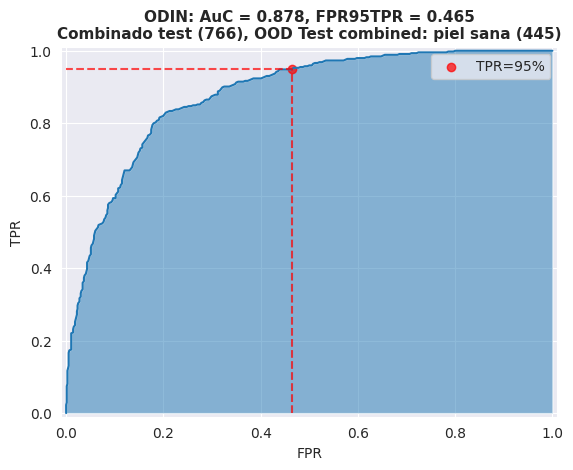

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Test combined: piel sana
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 445


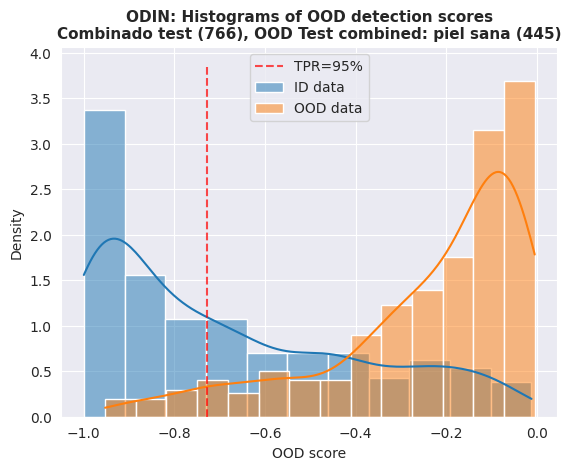

Procesando ds_out_seteado: OOD Fitz: ok
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-0.63692826]
 [ 1.3640649 ]
 [ 0.5395279 ]
 [ 1.1222076 ]
 [ 4.112987  ]
 [ 0.91448313]
 [-0.1626329 ]
 [ 1.4748317 ]
 [ 4.588724  ]
 [-1.0449953 ]
 [ 3.9950469 ]
 [ 1.3060832 ]
 [-0.4838622 ]
 [ 2.8254113 ]
 [-0.32859543]
 [ 1.2306018 ]
 [ 2.6094756 ]
 [ 1.5313641 ]
 [ 3.1732042 ]
 [ 0.14666809]
 [-3.126448  ]
 [-1.2904118 ]
 [ 1.5923432 ]
 [ 2.7887979 ]
 [ 1.4815875 ]
 [ 2.0086217 ]
 [ 0.28387836]
 [ 4.4506783 ]
 [-0.5777843 ]
 [ 4.2646956 ]
 [ 1.4757135 ]
 [ 0.0712423 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.34594125]
 [0.7964196 ]
 [0.6317026 ]
 [0.7543979 ]
 [0.9839045 ]
 [0.71391666]
 [0.45943114]
 [0.8137907 ]
 [0.9899365 ]
 [0.2601873 ]
 [0.981926  ]
 [0.78685695]
 [0.38134053]
 [0.9440337 ]
 [0.41858244]
 [0.7739239 ]
 [0

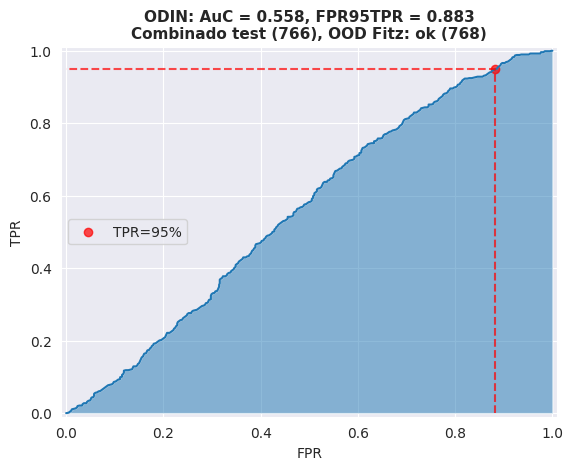

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: ok
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


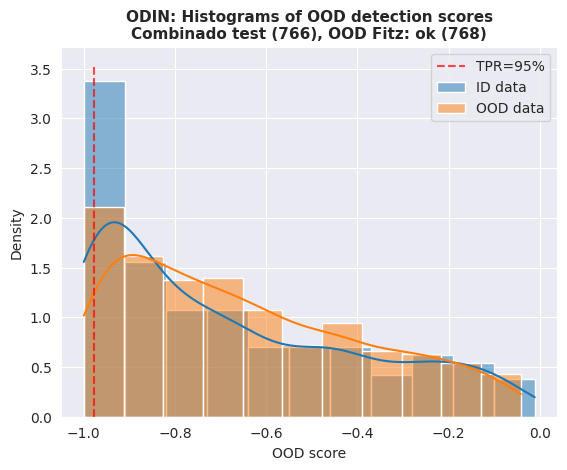

Procesando ds_out_seteado: OOD Fitz: Ambos filtros
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-0.6026565 ]
 [ 0.72103465]
 [ 1.0257899 ]
 [ 0.41484585]
 [ 0.1899884 ]
 [ 0.7406985 ]
 [ 0.29988953]
 [-1.7353791 ]
 [ 1.7620484 ]
 [ 0.640709  ]
 [ 2.7598064 ]
 [ 0.26558995]
 [-2.0948372 ]
 [-0.08804569]
 [ 1.3820971 ]
 [ 2.690965  ]
 [ 1.7405211 ]
 [ 2.3340006 ]
 [ 2.5381837 ]
 [-1.5579678 ]
 [ 0.81416017]
 [-0.5311562 ]
 [-0.19127035]
 [ 1.0626986 ]
 [ 0.23534155]
 [-1.2612646 ]
 [ 1.3750691 ]
 [ 0.85138905]
 [ 3.7920344 ]
 [ 0.31928304]
 [ 1.639229  ]
 [-1.1499977 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.35373616]
 [0.6728348 ]
 [0.7360988 ]
 [0.60224926]
 [0.5473547 ]
 [0.6771486 ]
 [0.5744155 ]
 [0.14990082]
 [0.853466  ]
 [0.6549137 ]
 [0.94046474]
 [0.56600994]
 [0.10959964]
 [0.47800276]
 [0.79932755]
 [0.93

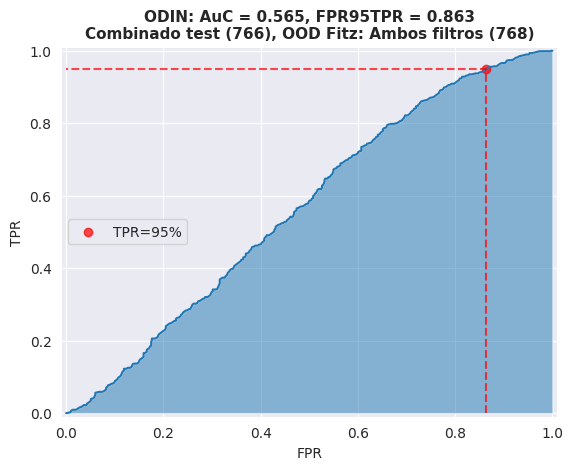

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz: Ambos filtros
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


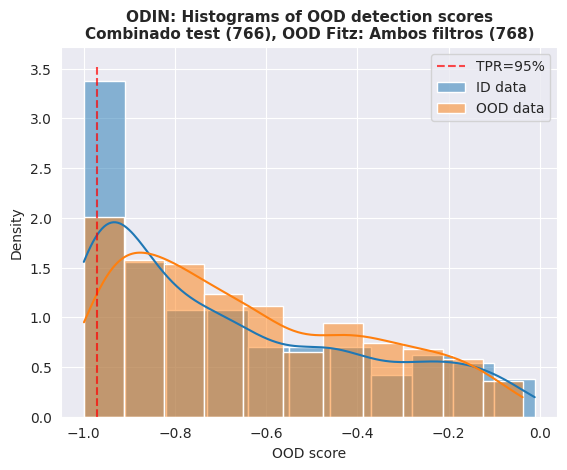

Procesando ds_out_seteado: OOD Fitz ok: Acne vulgaris
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-0.93959886]
 [ 0.14323448]
 [-0.4575882 ]
 [-1.681863  ]
 [-0.31086338]
 [-0.5861542 ]
 [-0.48797813]
 [ 1.7525315 ]
 [ 2.2097507 ]
 [ 0.40694305]
 [-0.34778154]
 [ 2.0321238 ]
 [-0.6788429 ]
 [ 0.7973761 ]
 [-1.6292149 ]
 [-0.57681596]
 [ 1.4878328 ]
 [ 1.4530463 ]
 [ 1.0365192 ]
 [ 2.2626476 ]
 [ 2.0585299 ]
 [ 3.9472563 ]
 [ 2.8084834 ]
 [ 1.6534455 ]
 [ 2.5751123 ]
 [-0.32237712]
 [-0.7252869 ]
 [ 1.3350738 ]
 [ 1.5168141 ]
 [-0.8516239 ]
 [ 0.76866186]
 [ 2.8193624 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.2809814 ]
 [0.5357475 ]
 [0.38755813]
 [0.15684894]
 [0.42290404]
 [0.35751775]
 [0.38037   ]
 [0.8522718 ]
 [0.90112174]
 [0.6003547 ]
 [0.4139205 ]
 [0.8841288 ]
 [0.3365196 ]
 [0.6894129 ]
 [0.16393794]
 [0

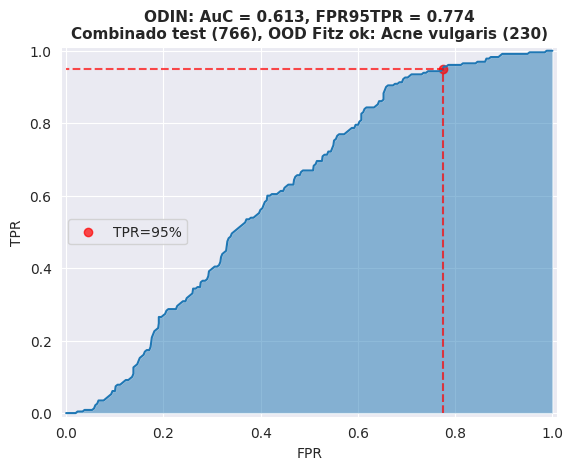

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Acne vulgaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 230


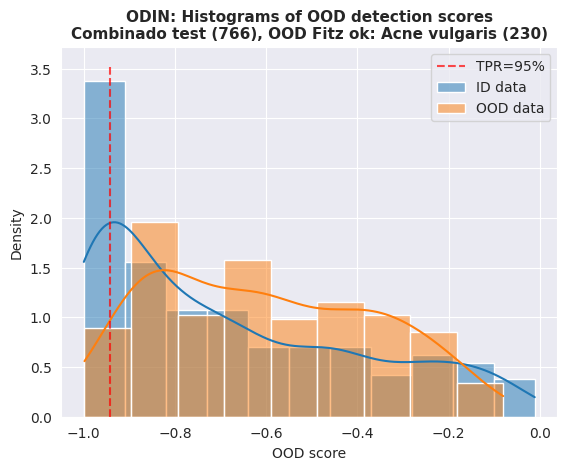

Procesando ds_out_seteado: OOD Fitz ok: Pityriasis rubra pilaris
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[ 0.74674207]
 [ 0.88467425]
 [ 3.8087847 ]
 [ 0.64681333]
 [ 1.1637609 ]
 [ 0.4946992 ]
 [ 2.370326  ]
 [ 1.1206391 ]
 [ 0.8686797 ]
 [-0.96687233]
 [-0.4710515 ]
 [ 0.9152544 ]
 [ 1.2383779 ]
 [ 1.936698  ]
 [-0.502861  ]
 [-0.6203128 ]
 [ 2.5434935 ]
 [-0.06307391]
 [-0.87892175]
 [-0.49563304]
 [ 0.78524035]
 [ 1.1906959 ]
 [ 2.0920122 ]
 [ 0.8846293 ]
 [ 2.005684  ]
 [ 1.2309281 ]
 [-2.554931  ]
 [ 0.78815377]
 [ 0.0712423 ]
 [ 3.8386045 ]
 [ 0.12721427]
 [ 0.15762536]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.6784684 ]
 [0.7077899 ]
 [0.978306  ]
 [0.656292  ]
 [0.7620154 ]
 [0.6212128 ]
 [0.9145363 ]
 [0.75410724]
 [0.7044709 ]
 [0.27550435]
 [0.3843674 ]
 [0.7140742 ]
 [0.7752815 ]
 [0.8739889 ]
 [0.37

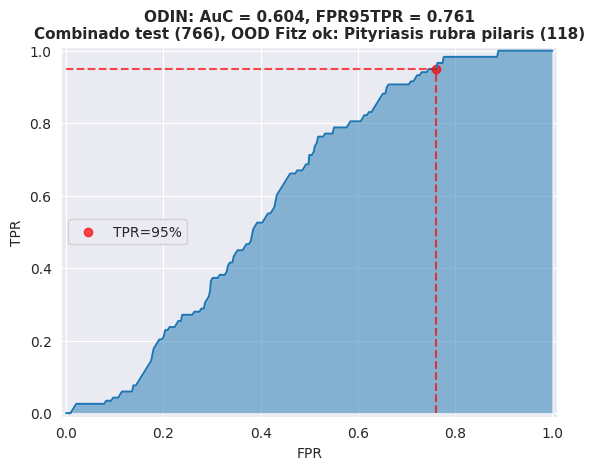

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Pityriasis rubra pilaris
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 118


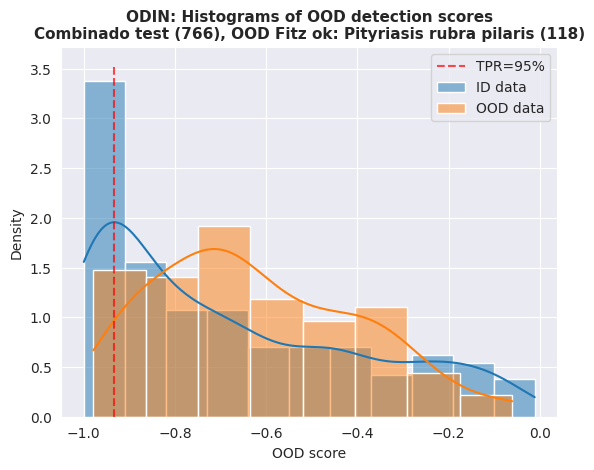

Procesando ds_out_seteado: OOD Fitz ok: Hailey-Hailey disease
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[ 1.615044  ]
 [ 4.2573333 ]
 [ 1.2020012 ]
 [ 2.7294655 ]
 [ 0.37823966]
 [ 0.797338  ]
 [ 2.7309763 ]
 [ 1.0429714 ]
 [ 2.6721647 ]
 [ 0.51009655]
 [ 2.2454748 ]
 [ 1.7857999 ]
 [ 2.6725776 ]
 [ 3.2290268 ]
 [ 1.040068  ]
 [ 2.7668848 ]
 [-0.22111244]
 [ 0.9173663 ]
 [ 2.0924268 ]
 [ 2.7923589 ]
 [ 0.24347165]
 [ 0.9719073 ]
 [ 1.5508614 ]
 [ 0.53850615]
 [ 0.32723677]
 [ 1.9416867 ]
 [ 3.7191193 ]
 [ 2.423647  ]
 [ 2.6235123 ]
 [ 2.2373333 ]
 [ 2.1148863 ]
 [ 5.177563  ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.83411056]
 [0.9860377 ]
 [0.7688806 ]
 [0.93874305]
 [0.59344846]
 [0.6894047 ]
 [0.93882996]
 [0.7394229 ]
 [0.935364  ]
 [0.6248291 ]
 [0.90425944]
 [0.8564116 ]
 [0.93538904]
 [0.96191216]
 [0.73886

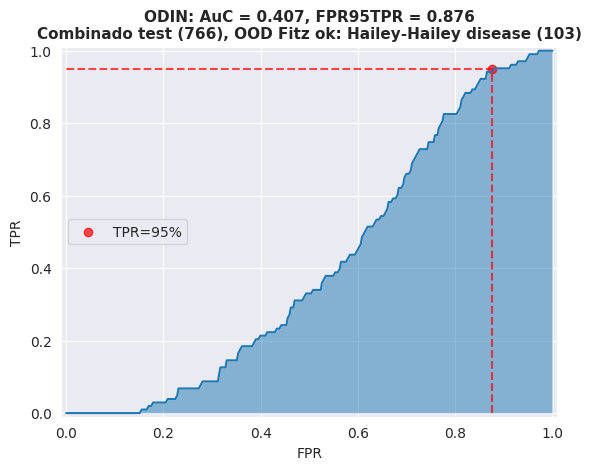

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': OOD Fitz ok: Hailey-Hailey disease
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 103


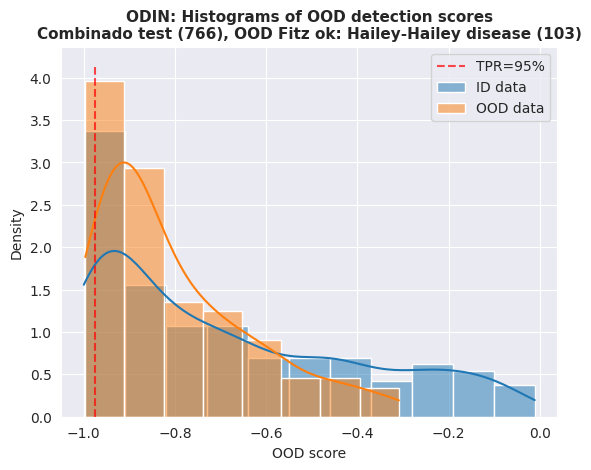

Procesando ds_out_seteado: Fashion MNIST
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-2.9898667 ]
 [-2.58542   ]
 [-1.8252325 ]
 [-2.4418852 ]
 [-1.9917796 ]
 [-2.7494109 ]
 [-2.2070503 ]
 [-0.4060675 ]
 [-2.5601475 ]
 [-2.7248285 ]
 [-2.2411597 ]
 [-1.00357   ]
 [-3.1579297 ]
 [-1.5347052 ]
 [-1.5294975 ]
 [-3.5250766 ]
 [-1.6263813 ]
 [-1.2034881 ]
 [-1.9511735 ]
 [-0.59824735]
 [-3.3061428 ]
 [-2.8504915 ]
 [-5.024048  ]
 [-2.292168  ]
 [-2.7460368 ]
 [-1.8324285 ]
 [-1.9042233 ]
 [-2.8437572 ]
 [-2.4066563 ]
 [-2.4813194 ]
 [-2.0181642 ]
 [-1.1029974 ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.04788577]
 [0.07008269]
 [0.13880719]
 [0.080034  ]
 [0.12006872]
 [0.06011993]
 [0.09911916]
 [0.39985543]
 [0.07174771]
 [0.06152408]
 [0.09611475]
 [0.2682401 ]
 [0.04077996]
 [0.17730631]
 [0.17806722]
 [0.02860709]
 [

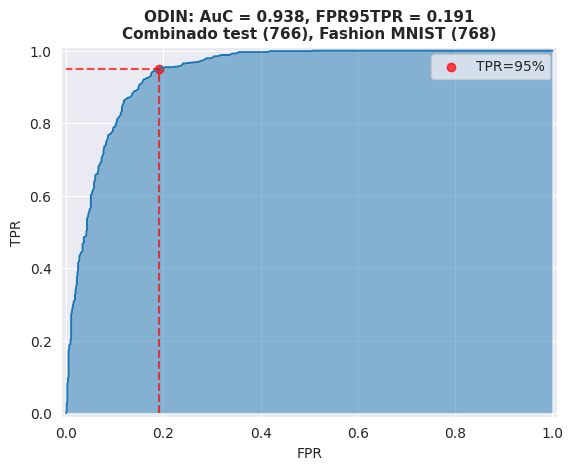

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': Fashion MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


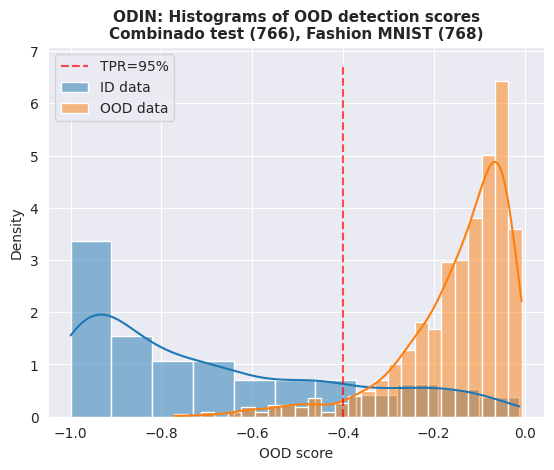

Procesando ds_out_seteado: MNIST
Logits (raw model output) shape: (32, 1)
Outputs after argmax shape: (32,)
Gradients shape: (32, 3, 224, 224)
Perturbed inputs shape: (32, 3, 224, 224)
Logits shape (after perturbation): (32, 1)
Logits: [[-1.071157  ]
 [-1.4606489 ]
 [-1.7207648 ]
 [-0.48139238]
 [-2.238414  ]
 [-1.6917549 ]
 [-0.7783259 ]
 [-2.0070426 ]
 [-2.7809916 ]
 [-2.0735598 ]
 [-2.1204007 ]
 [-1.0110521 ]
 [-2.1701005 ]
 [-1.9800322 ]
 [-0.16661127]
 [-1.6971432 ]
 [-2.0312927 ]
 [-2.3340828 ]
 [-4.0211616 ]
 [-1.2157999 ]
 [-1.1356082 ]
 [-2.831377  ]
 [-2.9168298 ]
 [-2.3328981 ]
 [-2.4068115 ]
 [-1.9351748 ]
 [-2.711444  ]
 [-0.7585216 ]
 [-1.6261355 ]
 [-2.0940285 ]
 [-0.49384728]
 [-2.212793  ]]
Probits shape (sigmoid output): (32, 1)
Probits: [[0.2551831 ]
 [0.1883681 ]
 [0.1517727 ]
 [0.38192338]
 [0.09635355]
 [0.15554519]
 [0.3146808 ]
 [0.11846547]
 [0.05836004]
 [0.11169337]
 [0.10712974]
 [0.266774  ]
 [0.1024678 ]
 [0.12131539]
 [0.45844328]
 [0.15483876]
 [0.115956

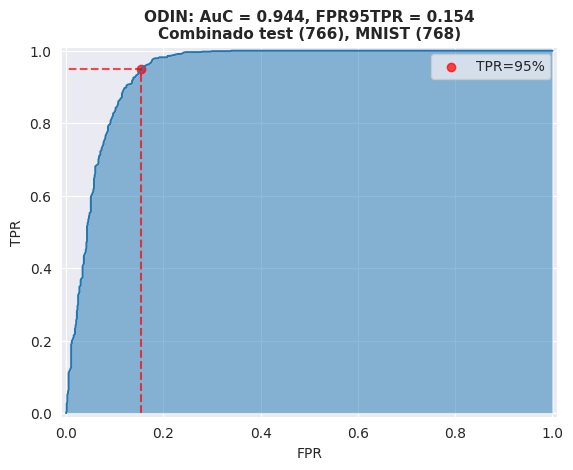

Value de 'ds_in_seteado': Combinado test
Value de 'ds_out_seteado': MNIST
Cantidad de elementos en 'ds_in': 766
Cantidad de elementos en 'ds_out': 768


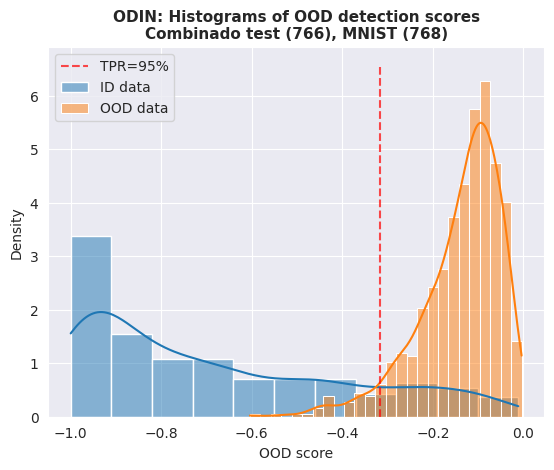

In [ ]:
# Mapeo de los datasets a sus nombres de fuente
dataset_sources = {
    "ds_fit_seteado": {
        combined_dataset_train_dict: "DS_FIT Comb"
    },
    "ds_in_seteado": {
        combined_dataset_test_con209_dict: "Combinado test",
    },
    "ds_out_seteado": {
        dataset_test_combined_ood_dict: "OOD Test combined: piel sana",
        dataset_fitz_ood_dict_ok: "OOD Fitz: ok",
        dataset_fitz_ood_dict_filtrado_ambos: "OOD Fitz: Ambos filtros",
        dataset_fitz_ood_acne_vulgaris_dict: "OOD Fitz ok: Acne vulgaris",
        dataset_fitz_ood_pityriasis_rubra_pilaris_dict: "OOD Fitz ok: Pityriasis rubra pilaris",
        dataset_fitz_ood_hailey_hailey_disease_dict: "OOD Fitz ok: Hailey-Hailey disease",
        "fashion_mnist": "Fashion MNIST",
        "mnist": "MNIST"
    }
}

# Iterar sobre todos los valores de ds_out_seteado
for ds_out_key, ds_out_value in dataset_sources["ds_out_seteado"].items():
    print(f"Procesando ds_out_seteado: {ds_out_value}")

    ds_out_seteado = ds_out_key
    ds_in_seteado = combined_dataset_test_con209_dict

    batch_size_test = 32 #13.8 gb VRAM usando 96-8 tira error OOM el .score. Usar 64-12 --> 13.8 gb tambien # 32-24 --> 8.2gb
    batches_in = 24
    batches_out = 24

    if not isinstance(ds_out_seteado, str): # si ds_out NO es un string corre esto.
      ds_out = OODDataset(
          ds_out_seteado, load_kwargs={"split":"test"},
          backend="tensorflow").prepare(batch_size_test, shuffle = True).take(batches_out) #.take(12) #384 imgs con bs 32 # el shuffle realentisa bastante el proceso xq implica mas costo computacional

    #MNIST
    if isinstance(ds_out_seteado, str): #si ds_out es un string corre esto.
      ds_out = OODDataset(
        ds_out_seteado, load_kwargs={"split":"test"},
        backend="tensorflow").prepare(batch_size_test).take(batches_out)
      ds_out = ds_out.map(lambda x, y: (mnist_preprocess_image(x), y))

    scores_out, _ = odin.score(ds_out)
    score_plots_custom(metodo, scores_in, scores_out, ds_in_seteado, ds_out_seteado, batch_size_test, batches_in, batches_out, output_path = ODIN_PLOTS_OUTPUT_PATH)

In [ ]:
print(f"Cantidad real en 'scores_in': {len(scores_in)}")
print(f"Cantidad real en 'scores_out': {len(scores_out)}")


Cantidad real en 'scores_in': 766
Cantidad real en 'scores_out': 768


# ANÁLISIS RESULTADOS

Observaciones:

MSP Y MLS son lo mismo. Uno usa "linear" --> logits y el otro "sigmoid", pero no contempla "sigmoid" la librería, solo softmax así que no tiene sentido. Por eso uso MLS directamente.

MLS y Mahalanobis dieron resultados inversos. Quizas tiene que ver con que MLS usa "linear" --> logits y Mahalanobis usa -2 (dims 512) xq no permite usar la última layer


In [ ]:
METODOS_OOD_PATH = "/content/drive/MyDrive/Tesis/Metodos OOD"

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# prompt: La carpeta en METODOS_OOD_PATH tiene subcarpetas. Quiero un dataframe que contenga los nombres de todos los archivos de las subcarpetas

import pandas as pd
import os

METODOS_OOD_PATH = "/content/drive/MyDrive/Tesis/Metodos OOD"

all_files = []
for root, _, files in os.walk(METODOS_OOD_PATH):
  for file in files:
    all_files.append(os.path.join(root, file))

df_files = pd.DataFrame({'file_name': all_files})

In [ ]:
# prompt: de esos me quiero quedar únicamente con los que terminan en .jpg

import pandas as pd


# Filter for files ending with .jpg
jpg_files = df_files[df_files['file_name'].str.endswith('.jpg')]

In [ ]:
# prompt: de esos me quiero quedar únicamente con los que contienen "AuC" en su nombre

# Assuming df_files is defined as in the provided code
# ... (previous code)

# Filter for files containing "AuC" in their name
auc_files = df_files[df_files['file_name'].str.contains("AuC")]

# Print the filtered dataframe
auc_files

,file_name
9,/content/drive/MyDrive/Tesis/Metodos OOD/Mahal...
11,/content/drive/MyDrive/Tesis/Metodos OOD/Mahal...
13,/content/drive/MyDrive/Tesis/Metodos OOD/Mahal...
15,/content/drive/MyDrive/Tesis/Metodos OOD/Mahal...
17,/content/drive/MyDrive/Tesis/Metodos OOD/Mahal...
...,...
146,/content/drive/MyDrive/Tesis/Metodos OOD/No te...
148,/content/drive/MyDrive/Tesis/Metodos OOD/No te...
150,/content/drive/MyDrive/Tesis/Metodos OOD/No te...
152,/content/drive/MyDrive/Tesis/Metodos OOD/No te...


In [ ]:
import pandas as pd
import re

# DataFrame inicial (asegúrate de tener una columna 'file_name' con los nombres de archivo)
# Ejemplo de creación del DataFrame:
# auc_files = pd.DataFrame({'file_name': ['ruta_del_archivo']})

# Función para extraer información del nombre del archivo
def extract_info(file_name):
    # Extraer nombre del método
    method_match = re.search(r'/Tesis/Metodos OOD/([^/]+)/plots/', file_name)
    method = method_match.group(1) if method_match else None

    # Extraer métricas AuC y FPR95TPR
    auc_match = re.search(r'AuC\s*=\s*([\d.]+)', file_name)
    fpr_match = re.search(r'FPR95TPR\s*=\s*([\d.]+)', file_name)
    auc = float(auc_match.group(1)) if auc_match else None
    fpr = float(fpr_match.group(1)) if fpr_match else None

    # Extraer nombre del OOD set y número de imágenes
    ood_set_match = re.search(r'Combinado test \(\d+\),\s*(.*?):\s*\((\d+)\)', file_name)
    if not ood_set_match:  # Manejar otro formato
        ood_set_match = re.search(r'Combinado test \(\d+\),\s*(.*?)\s*\((\d+)\)', file_name)
    ood_set = ood_set_match.group(1) if ood_set_match else None
    num_imgs_ood = int(ood_set_match.group(2)) if ood_set_match else None

    return method, auc, fpr, ood_set, num_imgs_ood

# Aplicar la función al DataFrame
auc_files[['method', 'AuC', 'FPR95TPR', 'OOD_set', 'num_imgs_OOD']] = auc_files['file_name'].apply(
    lambda x: pd.Series(extract_info(x))
)

# Crear un DataFrame pivotado con los resultados por método y OOD set
result_df = auc_files.pivot_table(
    index=['OOD_set', 'num_imgs_OOD'],
    columns='method',
    values=['AuC', 'FPR95TPR']
).reset_index()

# Ordenar columnas para mejor visualización
result_df.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in result_df.columns]

# Mostrar el DataFrame resultante
result_df
result_df = result_df[result_df["OOD_set_"] != "Fashion MNIST"]


<ipython-input-10-3723f1bb9b93>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  auc_files[['method', 'AuC', 'FPR95TPR', 'OOD_set', 'num_imgs_OOD']] = auc_files['file_name'].apply(


In [ ]:
# prompt: filtrar las dos columnas que contienen "_Energy" de result_df. Quiero quedarme con todas las columnas menos esas 2

# Assuming result_df is defined as in your provided code.

columns_to_drop = [col for col in result_df.columns if "_Energy" in col]
result_df = result_df.drop(columns=columns_to_drop)

# Now result_df_filtered contains all columns except those containing "_Energy"
result_df


,OOD_set_,num_imgs_OOD_,AuC_DKNN,AuC_MLS,AuC_Mahalanobis,AuC_ODIN,FPR95TPR_DKNN,FPR95TPR_MLS,FPR95TPR_Mahalanobis,FPR95TPR_ODIN
1,MNIST,768,0.921,0.467,0.921,0.944,0.303,0.717,0.230,0.154
2,OOD Fitz ok: Acne vulgaris,230,0.683,0.542,0.566,0.613,0.758,0.774,0.907,0.774
3,OOD Fitz ok: Hailey-Hailey disease,103,0.559,0.468,0.517,0.407,0.871,0.868,0.907,0.876
4,OOD Fitz ok: Pityriasis rubra pilaris,118,0.600,0.707,0.442,0.604,0.761,0.646,0.965,0.761
5,OOD Fitz: Ambos filtros,768,0.598,0.555,0.507,0.565,0.821,0.868,0.926,0.863
6,OOD Fitz: ok,768,0.603,0.546,0.505,0.558,0.836,0.868,0.924,0.883
7,OOD Test combined: piel sana,445,0.624,0.788,0.633,0.878,0.851,0.590,0.867,0.465


In [ ]:
# Crear DataFrames separados para AuC y FPR95TPR
auc_df = result_df.filter(regex="^OOD_set_|^num_imgs_OOD_|^AuC_")
fpr95tpr_df = result_df.filter(regex="^OOD_set_|^num_imgs_OOD_|^FPR95TPR_")


In [ ]:
auc_df

,OOD_set_,num_imgs_OOD_,AuC_DKNN,AuC_MLS,AuC_Mahalanobis,AuC_ODIN
1,MNIST,768,0.921,0.467,0.921,0.944
2,OOD Fitz ok: Acne vulgaris,230,0.683,0.542,0.566,0.613
3,OOD Fitz ok: Hailey-Hailey disease,103,0.559,0.468,0.517,0.407
4,OOD Fitz ok: Pityriasis rubra pilaris,118,0.600,0.707,0.442,0.604
5,OOD Fitz: Ambos filtros,768,0.598,0.555,0.507,0.565
6,OOD Fitz: ok,768,0.603,0.546,0.505,0.558
7,OOD Test combined: piel sana,445,0.624,0.788,0.633,0.878


In [ ]:
fpr95tpr_df

,OOD_set_,num_imgs_OOD_,FPR95TPR_DKNN,FPR95TPR_MLS,FPR95TPR_Mahalanobis,FPR95TPR_ODIN
1,MNIST,768,0.303,0.717,0.230,0.154
2,OOD Fitz ok: Acne vulgaris,230,0.758,0.774,0.907,0.774
3,OOD Fitz ok: Hailey-Hailey disease,103,0.871,0.868,0.907,0.876
4,OOD Fitz ok: Pityriasis rubra pilaris,118,0.761,0.646,0.965,0.761
5,OOD Fitz: Ambos filtros,768,0.821,0.868,0.926,0.863
6,OOD Fitz: ok,768,0.836,0.868,0.924,0.883
7,OOD Test combined: piel sana,445,0.851,0.590,0.867,0.465


In [ ]:
auc_df.set_index(['OOD_set_', 'num_imgs_OOD_']).iloc[:, :]

,,AuC_DKNN,AuC_MLS,AuC_Mahalanobis,AuC_ODIN
OOD_set_,num_imgs_OOD_,,,,
MNIST,768,0.921,0.467,0.921,0.944
OOD Fitz ok: Acne vulgaris,230,0.683,0.542,0.566,0.613
OOD Fitz ok: Hailey-Hailey disease,103,0.559,0.468,0.517,0.407
OOD Fitz ok: Pityriasis rubra pilaris,118,0.600,0.707,0.442,0.604
OOD Fitz: Ambos filtros,768,0.598,0.555,0.507,0.565
OOD Fitz: ok,768,0.603,0.546,0.505,0.558
OOD Test combined: piel sana,445,0.624,0.788,0.633,0.878


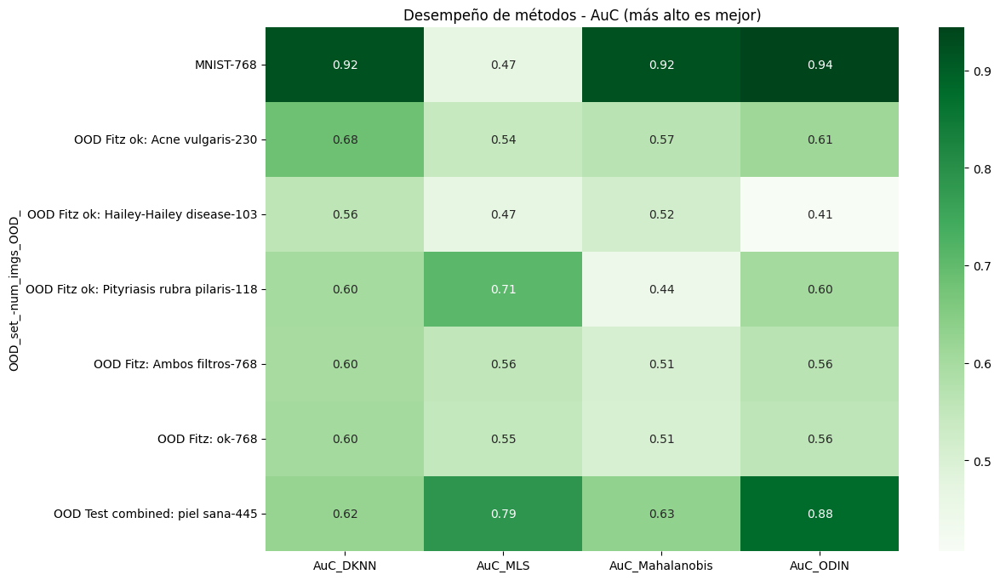

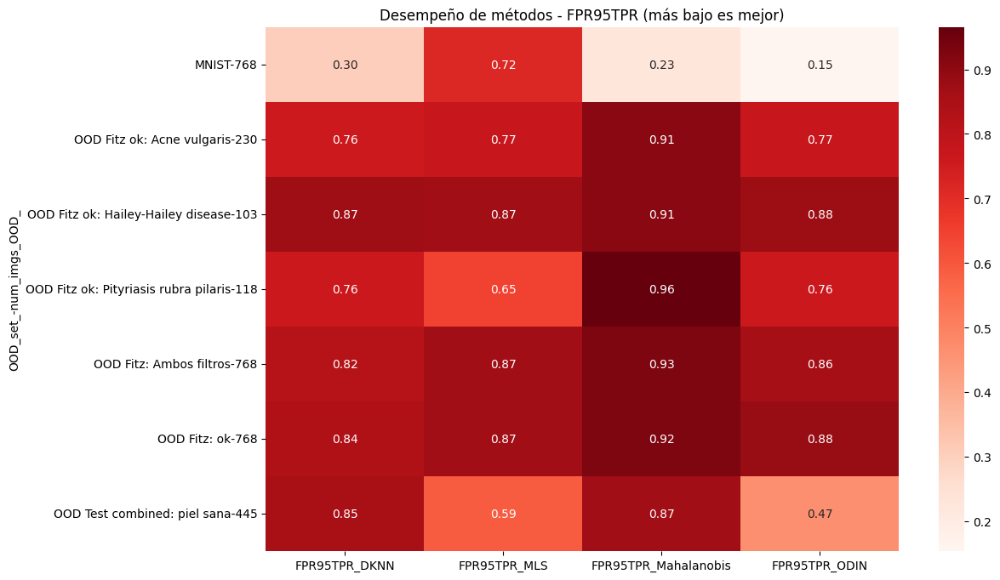

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Heatmap para AuC
plt.figure(figsize=(12, 8))
sns.heatmap(auc_df.set_index(['OOD_set_', 'num_imgs_OOD_']).iloc[:, :], annot=True, cmap="Greens", fmt=".2f")
plt.title("Desempeño de métodos - AuC (más alto es mejor)")
plt.show()

# Heatmap para FPR95TPR
plt.figure(figsize=(12, 8))
sns.heatmap(fpr95tpr_df.set_index(['OOD_set_', 'num_imgs_OOD_']).iloc[:, :], annot=True, cmap="Reds", fmt=".2f")
plt.title("Desempeño de métodos - FPR95TPR (más bajo es mejor)")
plt.show()


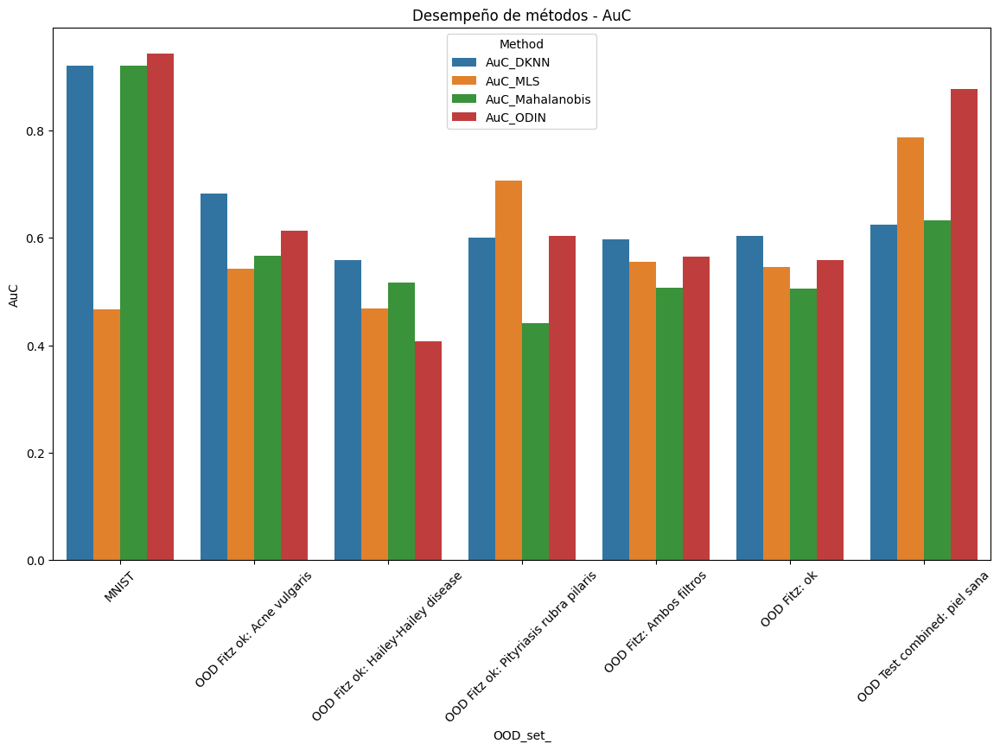

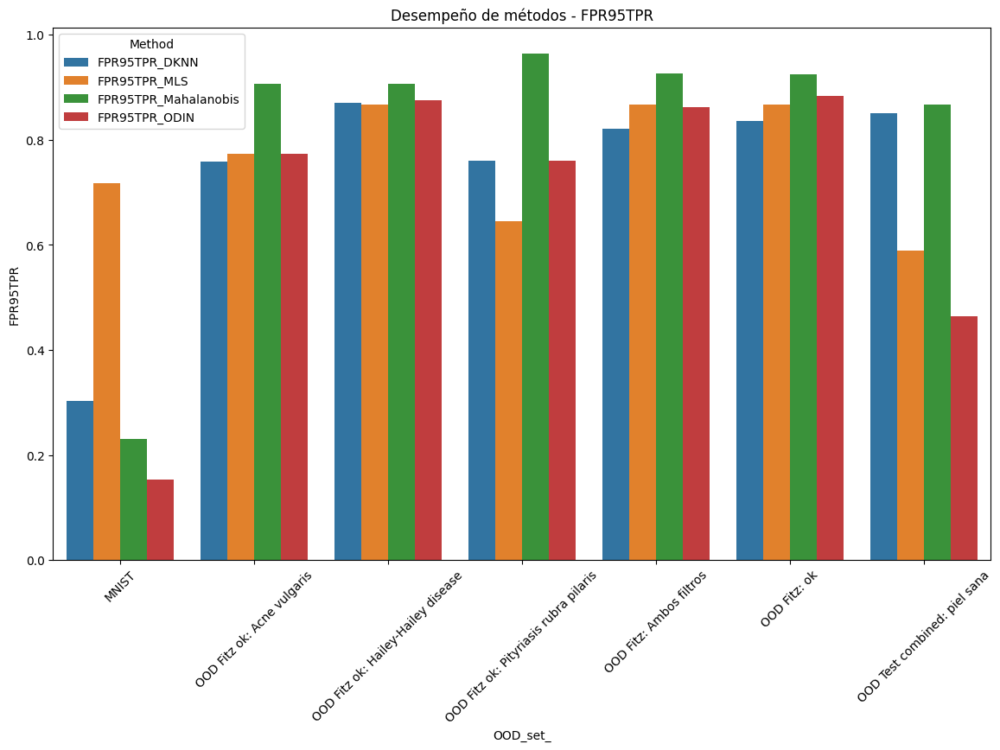

In [ ]:
# Gráfico de barras para AuC
auc_melted = auc_df.melt(id_vars=["OOD_set_", "num_imgs_OOD_"], var_name="Method", value_name="AuC")
plt.figure(figsize=(14, 8))
sns.barplot(data=auc_melted, x="OOD_set_", y="AuC", hue="Method")
plt.xticks(rotation=45)
plt.title("Desempeño de métodos - AuC")
plt.show()

# Gráfico de barras para FPR95TPR
fpr_melted = fpr95tpr_df.melt(id_vars=["OOD_set_", "num_imgs_OOD_"], var_name="Method", value_name="FPR95TPR")
plt.figure(figsize=(14, 8))
sns.barplot(data=fpr_melted, x="OOD_set_", y="FPR95TPR", hue="Method")
plt.xticks(rotation=45)
plt.title("Desempeño de métodos - FPR95TPR")
plt.show()


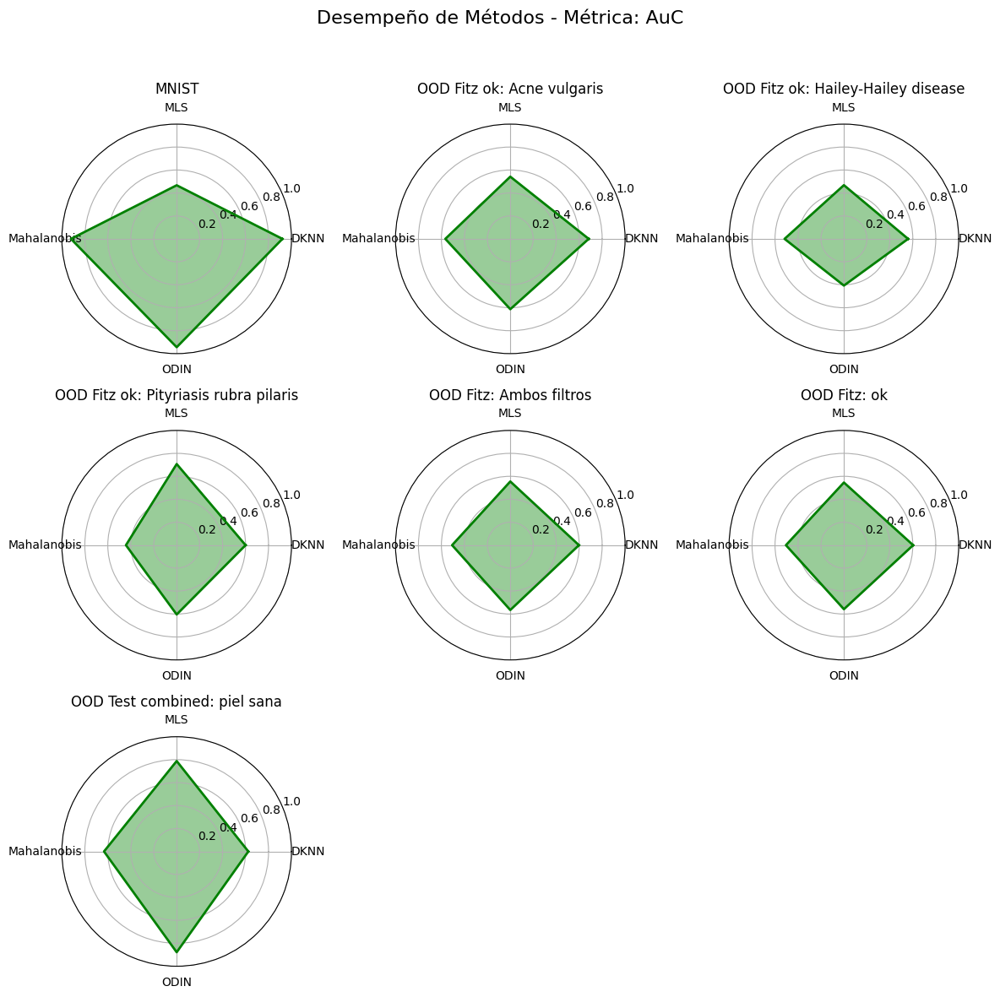

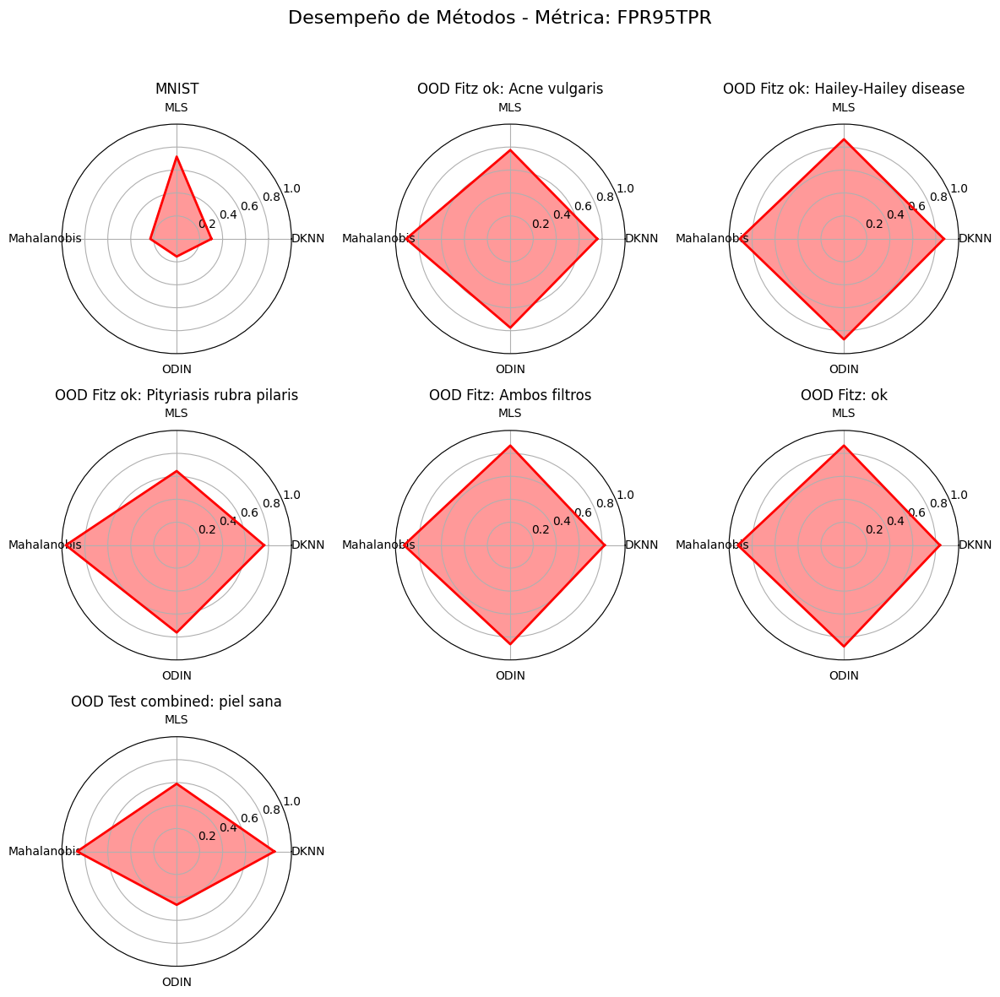

In [ ]:
# Función corregida para graficar múltiples radars con radio fijo
def plot_multiple_radars_fixed_radius(data, metric_name, color, title):
    from math import pi

    # Verificar y configurar el índice
    if 'OOD_set_' not in data.columns or 'num_imgs_OOD_' not in data.columns:
        raise ValueError("El DataFrame debe contener columnas 'OOD_set_' y 'num_imgs_OOD_'.")

    data = data.set_index(['OOD_set_', 'num_imgs_OOD_']).iloc[:, :]

    # Configuración de la figura
    num_ood_sets = len(data.index.get_level_values('OOD_set_').unique())
    num_columns = 3  # Número de columnas de subplots
    num_rows = (num_ood_sets + num_columns - 1) // num_columns

    plt.figure(figsize=(num_columns * 4, num_rows * 4))
    for i, ood_set in enumerate(data.index.get_level_values('OOD_set_').unique(), start=1):
        ax = plt.subplot(num_rows, num_columns, i, polar=True)

        # Extraer datos
        subset_data = data[data.index.get_level_values('OOD_set_') == ood_set].iloc[0]
        subset_data.index = [col.split("_")[1] for col in subset_data.index]
        categories = list(subset_data.index)
        values = subset_data.values.flatten().tolist()
        values += values[:1]  # Cerrar el gráfico

        # Ángulos
        angles = [n / float(len(categories)) * 2 * pi for n in range(len(categories))]
        angles += angles[:1]

        # Graficar
        ax.plot(angles, values, linewidth=2, linestyle='solid', color=color)
        ax.fill(angles, values, alpha=0.4, color=color)
        ax.set_xticks(angles[:-1])
        ax.set_xticklabels(categories, fontsize=10)
        ax.set_title(ood_set, size=12, color="black", y=1.1)
        ax.set_ylim(0, 1)  # Fijar el radio a 1

    # Título general
    plt.suptitle(title, size=16, color="black")
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# Graficar los radars para AuC con radio fijo
plot_multiple_radars_fixed_radius(auc_df, "AuC", "green", "Desempeño de Métodos - Métrica: AuC")

# Graficar los radars para FPR95TPR con radio fijo
plot_multiple_radars_fixed_radius(fpr95tpr_df, "FPR95TPR", "red", "Desempeño de Métodos - Métrica: FPR95TPR")
